# **Final Project**
# **Exploring the Impact of Image Permutation on Classification Performance**

# **Data Import and Preprocessing**
In this section, we will import and preprocess the data, examine its distribution, and define useful functions that will be utilized later in the notebook.

## **Importing Libraries**







In [1]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from PIL import Image
import matplotlib.pyplot as plt
import random
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
from torchvision import models, transforms
from PIL import Image
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import torch
import torch.nn as nn
from torchvision.utils import make_grid
from torchvision import models
from torch.optim import Adam
import sklearn
from torchvision.transforms import RandomApply

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **Data Import and Preprocessing** <br>
We have selected the bicycle vs. car dataset. Here, we will handle various file types, resize all images to a consistent size (224x224), create an array of labels, visualize the images, and save the numpy array of images locally to streamline future runs and avoid repeated processing.


In [ ]:
def load_and_resize_images(directory, target_size):
    images = []
    for filename in os.listdir(directory):
        if any(filename.endswith(ext) for ext in ['jpg', 'jpeg', 'png', 'bmp']):
            img_path = os.path.join(directory, filename)
            try:
                with Image.open(img_path) as img:
                    # Ensure all images are converted to RGB
                    img = img.convert('RGB')
                    img_resized = img.resize(target_size)
                    images.append(np.array(img_resized))
            except IOError as e:
                print(f"Cannot process {filename}: {e}")
    return images

# Base directory where the 'Car-Bike-Dataset' folder is located
base_directory = '/content/drive/My Drive/Car-Bike-Dataset'  # Replace with your actual path

# Directories for 'Bike' and 'Car'
bike_directory = os.path.join(base_directory, 'Bike')
car_directory = os.path.join(base_directory, 'Car')

# Resize images outside the function
target_size = (224, 224)
bike_images = load_and_resize_images(bike_directory, target_size)
car_images = load_and_resize_images(car_directory, target_size)

# Assign labels to the images
# Using descriptive labels: 0 for bike, 1 for car
bike_labels = np.zeros(len(bike_images))
car_labels = np.ones(len(car_images))

# Combine the images and the labels
images = np.array(bike_images + car_images)
labels = np.concatenate((bike_labels, car_labels), axis=0)

# Print the total number of images for each class
print(f"Number of bike images: {len(bike_images)}")
print(f"Number of car images: {len(car_images)}")

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Number of bike images: 1999
Number of car images: 1997


In [ ]:
def plot_images(images, labels, num_samples=5):
    # Get unique labels
    unique_labels = np.unique(labels)

    # Set up subplots
    fig, axes = plt.subplots(len(unique_labels), num_samples, figsize=(15, 7))

    # Plot each class
    for i, label in enumerate(unique_labels):
        # Get indices of images with this label
        indices = np.where(labels == label)[0]

        # Choose random samples
        random_indices = np.random.choice(indices, num_samples, replace=False)

        # Plot each image
        for j, idx in enumerate(random_indices):
            axes[i, j].imshow(images[idx])
            axes[i, j].axis('off')
            axes[i, j].set_title(f"Class: {'Bike' if label == 0 else 'Car'}")

    plt.tight_layout()
    plt.show()

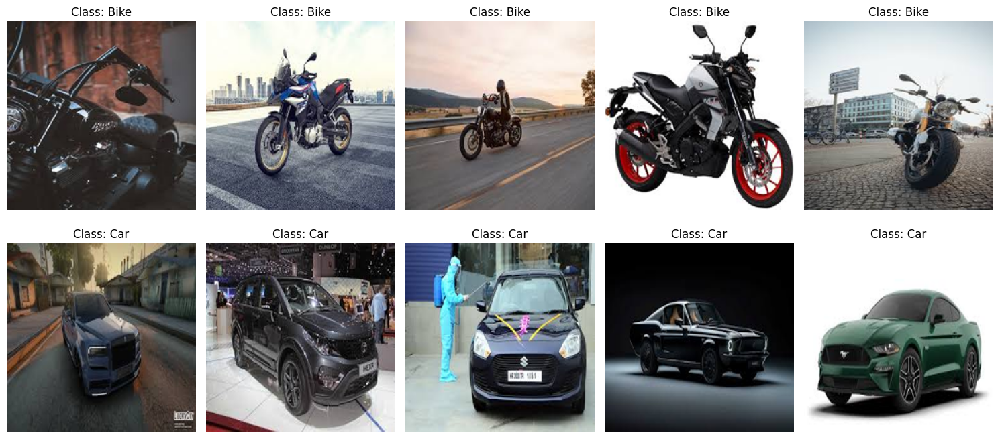

In [ ]:
# Plot 5 random images from each class
plot_images(images, labels)

In [ ]:
# Convert images to numpy arrays
# bike_images_np = np.array(bike_images)
# car_images_np = np.array(car_images)

# Stack the images and labels
# images_np = np.vstack([bike_images_np, car_images_np])
# labels_np = np.hstack([np.zeros(len(bike_images_np)), np.ones(len(car_images_np))])

# Save the images array
# np.save('/content/drive/My Drive/Car-Bike-Dataset/images_np.npy', images_np)

# Save the labels array
# np.save('/content/drive/My Drive/Car-Bike-Dataset/labels_np.npy', labels_np)

In [3]:
# Load the images array
images_np = np.load('/content/drive/My Drive/Car-Bike-Dataset/images_np.npy')

# Load the labels array
labels_np = np.load('/content/drive/My Drive/Car-Bike-Dataset/labels_np.npy')

Number of bike images: 1999
Number of car images: 1997


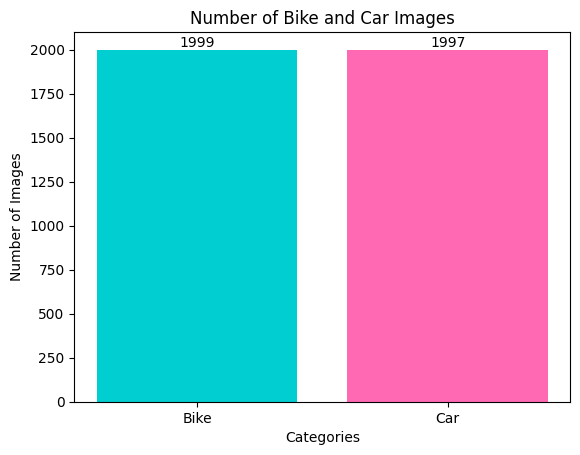

In [6]:
num_bike_images = np.sum(labels_np == 0)
num_car_images = np.sum(labels_np == 1)

print(f"Number of bike images: {num_bike_images}")
print(f"Number of car images: {num_car_images}")

categories = ['Bike', 'Car']
values = [num_bike_images, num_car_images]

plt.bar(categories, values, color=['#00CED1', '#FF69B4'])
plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Number of Bike and Car Images')

for i in range(len(categories)):
    plt.text(i, values[i], str(values[i]), ha='center', va='bottom')

plt.show()


# \$$$$ To add plot

## **Definition of Useful Functions**
We will define practical functions that will aid us throughout the project.

### **Train And Test Functions**

In [4]:
def train_model(model, train_loader, criterion, optimizer, num_epochs=10):
    """
    Train the given model using the provided data loader, criterion, and optimizer.

    model (torch.nn.Module): The neural network model to be trained.
    train_loader (torch.utils.data.DataLoader): DataLoader for the training dataset.
    criterion: The loss function used for optimization.
    optimizer: The optimization algorithm used for training.
    num_epochs (int, optional): Number of epochs for training. Default is 10.
    """

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    model.train()
    train_losses = []

    for epoch in range(num_epochs):
        correct = 0
        total = 0
        # Training phase
        for i, (inputs, labels) in enumerate(train_loader, 1):
            inputs, labels = inputs.to(device), labels.to(device)  # Move data to the same device as the model
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            # Record training loss
            train_losses.append(loss.item())

            # Calculate accuracy for the current batch
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            # Print metrics every 100 iterations or at the last iteration of each epoch
            if i % 100 == 0 or (i - 1) % len(train_loader) == 0:
                print(f"Epoch {epoch+1}/{num_epochs}, Iteration {i}, Train Loss: {train_losses[-1]:.4f}")

            # Release GPU memory
            del inputs, labels, outputs, loss

        # Release GPU memory at the end of each epoch
        torch.cuda.empty_cache()

    # Calculate final training accuracy
    final_train_accuracy = correct / total
    print("Training completed.")
    print(f"Final Training Accuracy: {final_train_accuracy:.4f}")
    print("")


def test_model(model, test_loader):
    """
    Test the given model on the test dataset and calculate accuracy, precision, recall, F1 score, and confusion matrix.

    model: Trained PyTorch model
    test_loader: DataLoader for the test dataset

    Returns:
        accuracy: Accuracy of the model
        precision: Precision score
        recall: Recall score
        f1: F1 score
        confusion_matrix_values: Confusion matrix values
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Define device here as well
    model.to(device)

    model.eval()
    y_true = []
    y_pred = []
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)  # Move data to the same device as the model
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(predicted.cpu().numpy())

    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)
    confusion_matrix_values = sklearn.metrics.confusion_matrix(y_true, y_pred)

    print("Test Set Evaluation Metrics:")
    print(f'Accuracy: {accuracy}')
    print(f'Precision: {precision}')
    print(f'Recall: {recall}')
    print(f'F1 Score: {f1}')
    print(f'Confusion Matrix:\n{confusion_matrix_values}')

    return accuracy, precision, recall, f1, confusion_matrix_values


## **Models**

### **ResNet**
ResNet-18 is part of the Residual Network family, which is designed to enable the training of much deeper networks by using skip connections or shortcuts to jump over some layers. These connections help mitigate the vanishing gradient problem by allowing the gradient to flow directly through the skip connections. ResNet-18, with its 18 layers, is one of the shallower variants in the ResNet family, but good in terms of balance between performance and computational efficiency.

In [135]:
def resnet18_model():
  resnet18 = models.resnet18(pretrained=True)

  num_features = resnet18.fc.in_features
  resnet18.fc = nn.Linear(num_features, 2)  # Number of classes: Bike and Car

  return resnet18

### **GoogleNet**
GoogleNet introduces the inception module, a novel block that concatenates the outputs of parallel convolutional layers with different filter sizes. This design allows the network to capture information at various scales, enhancing its representational power. GoogleNet is not as deep as some other networks like VGG16 but incorporates a complex architecture with multiple auxiliary classifiers to assist in training.

In [101]:
def googlenet_model():
  googlenet = models.googlenet(pretrained=True)
  googlenet.aux_logits = False

  num_features = googlenet.fc.in_features
  googlenet.fc = nn.Linear(num_features, 2)  # Number of classes: Bike and Car

  return googlenet

### **DenseNet**
DenseNet-121, a member of the Densely Connected Convolutional Networks family, stands out for its unique connectivity pattern, where each layer receives inputs from all preceding layers and passes on its own feature-maps to all subsequent layers. This architecture ensures maximum information flow between layers, making the network highly parameter-efficient. DenseNet-121, with 121 layers, demonstrates excellent performance on a variety of tasks, particularly benefiting from feature reuse, which significantly reduces the vanishing gradient problem and strengthens feature propagation.

In [102]:
def densenet121_model():
  densenet121 = models.densenet121(pretrained=True)

  num_features = densenet121.classifier.in_features
  densenet121.classifier = nn.Linear(num_features, 2)  # Number of classes: Bike and Car

  return densenet121

### **Custom CNN**
Our Custom CNN is a straightforward convolutional neural network without the specialized modules or connections found in perviously nets. It's designed with sequential layers of convolutions, activation functions, and pooling, followed by fully connected layers for classification. While it lacks the advanced architectural features of the other networks we would like to examine here the fact that the model is not pretrained.

In [5]:
class CustomCNN(nn.Module):
    def __init__(self):
        super(CustomCNN, self).__init__()

        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.relu1 = nn.ReLU()

        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU()

        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.relu3 = nn.ReLU()
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv4 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.relu4 = nn.ReLU()
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv5 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.relu5 = nn.ReLU()
        self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc1 = nn.Linear(512 * 28 * 28, 4096)
        self.relu6 = nn.ReLU()

        self.fc2 = nn.Linear(4096, 4096)
        self.relu7 = nn.ReLU()

        self.fc3 = nn.Linear(4096, 2)  # Output layer for 2 classes

    def forward(self, x):
        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.pool3(self.relu3(self.conv3(x)))
        x = self.pool4(self.relu4(self.conv4(x)))
        x = self.pool5(self.relu5(self.conv5(x)))

        x = x.view(-1, 512 * 28 * 28)
        x = self.relu6(self.fc1(x))
        x = self.relu7(self.fc2(x))
        x = self.fc3(x)

        return x

In [ ]:
class CustomCNN_220x220(nn.Module):
    def __init__(self):
        super(CustomCNN_220x220, self).__init__()

        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.relu1 = nn.ReLU()

        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU()

        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.relu3 = nn.ReLU()
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv4 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.relu4 = nn.ReLU()
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv5 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.relu5 = nn.ReLU()
        self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc_input_size = 512 * 27 * 27
        self.fc1 = nn.Linear(self.fc_input_size, 4096)
        self.relu6 = nn.ReLU()

        self.fc2 = nn.Linear(4096, 4096)
        self.relu7 = nn.ReLU()

        self.fc3 = nn.Linear(4096, 2)

    def forward(self, x):
        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.pool3(self.relu3(self.conv3(x)))
        x = self.pool4(self.relu4(self.conv4(x)))
        x = self.pool5(self.relu5(self.conv5(x)))

        x = x.view(-1, self.fc_input_size)
        x = self.relu6(self.fc1(x))
        x = self.relu7(self.fc2(x))
        x = self.fc3(x)

        return x

In [ ]:
class CustomCNN_222x222(nn.Module):
    def __init__(self):
        super(CustomCNN_222x222, self).__init__()

        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.relu1 = nn.ReLU()

        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU()

        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.relu3 = nn.ReLU()
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv4 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.relu4 = nn.ReLU()
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv5 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.relu5 = nn.ReLU()
        self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc_input_size = 512 * 27 * 27  # Calculated for input image size 222x222
        self.fc1 = nn.Linear(self.fc_input_size, 4096)
        self.relu6 = nn.ReLU()

        self.fc2 = nn.Linear(4096, 4096)
        self.relu7 = nn.ReLU()

        self.fc3 = nn.Linear(4096, 2)  # Output layer for 2 classes

    def forward(self, x):
        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.pool3(self.relu3(self.conv3(x)))
        x = self.pool4(self.relu4(self.conv4(x)))
        x = self.pool5(self.relu5(self.conv5(x)))

        x = x.view(-1, self.fc_input_size)
        x = self.relu6(self.fc1(x))
        x = self.relu7(self.fc2(x))
        x = self.fc3(x)

        return x


### **Defining permutation functions**

In [32]:
def split_image_into_tiles(img, num_tiles):
    """
    Split an image into a grid of tiles.

    img (numpy.ndarray): The input image.
    num_tiles (int): Number of tiles along one dimension.

    Returns:
    list of numpy.ndarray: List of tiles extracted from the image.
    """
    tiles = []
    height, width, _ = img.shape
    tile_width = width // num_tiles
    tile_height = height // num_tiles

    for y in range(num_tiles):
        for x in range(num_tiles):
            tile = img[y * tile_height: (y + 1) * tile_height, x * tile_width: (x + 1) * tile_width]
            tiles.append(tile)

    return tiles

def permute_tiles_order(tiles, num_tiles):
    """
    Permute the order of tiles randomly.

    tiles (list of numpy.ndarray): List of tiles.
    num_tiles (int): Number of tiles along one dimension.

    Returns:
    list of numpy.ndarray: List of tiles with permuted order.
    """
    permutation = np.random.permutation(num_tiles**2)
    permuted_tiles = [tiles[i] for i in permutation]
    return permuted_tiles

def combine_permuted_tiles(tiles, num_tiles):
    """
    Combine permuted tiles to reconstruct the original image.

    tiles (list of numpy.ndarray): List of permuted tiles.
    num_tiles (int): Number of tiles along one dimension.

    Returns:
    numpy.ndarray: Combined image.
    """
    tile_height, tile_width, _ = tiles[0].shape
    combined_width = tile_width * num_tiles
    combined_height = tile_height * num_tiles
    combined_image = np.zeros((combined_height, combined_width, 3), dtype=np.uint8)

    for i, tile in enumerate(tiles):
        x = (i % num_tiles) * tile_width
        y = (i // num_tiles) * tile_height
        combined_image[y:y+tile_height, x:x+tile_width, :] = tile

    return combined_image

def plot_original_and_permuted_images(original_images, permuted_images):
    """
    Plot the original and permuted images side by side for comparison.

    Parameters:
    original_images (list of numpy.ndarray): List of original images.
    permuted_images (list of numpy.ndarray): List of permuted images.
    """
    num_images = len(original_images)

    fig, axes = plt.subplots(2, num_images, figsize=(4 * num_images, 8))
    plt.subplots_adjust(wspace=0.02)

    for i in range(num_images):
        # Plot original image-
        axes[0, i].imshow(original_images[i])
        axes[0, i].set_title('Original Image')
        axes[0, i].axis('off')

        # Plot permuted image-
        axes[1, i].imshow(permuted_images[i])
        axes[1, i].set_title('Permuted Image')
        axes[1, i].axis('off')

    plt.tight_layout()
    plt.show()

# **Impact of Architectural Variations**

## **Baseline models**

In [7]:
X_train, X_test, y_train, y_test = train_test_split(images_np, labels_np, test_size=0.2, random_state=42)

X_train_tensor = torch.tensor(X_train.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor = torch.tensor(X_test.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
y_test_tensor = torch.tensor(y_test, dtype=torch.long)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=True)

Number of bike images train: 1584
Number of bike images test: 415
Number of car images train: 1612
Number of car images test: 385


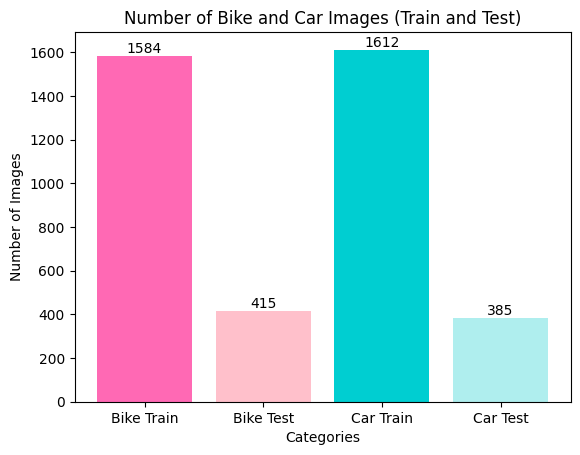

In [12]:
num_bike_images_train = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images_train = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images_train}")
print(f"Number of bike images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images_train}")
print(f"Number of car images test: {num_car_images_test}")

categories = ['Bike Train', 'Bike Test', 'Car Train', 'Car Test']
values = [num_bike_images_train, num_bike_images_test, num_car_images_train, num_car_images_test]

plt.bar(categories, values, color=['#FF69B4', '#FFC0CB', '#00CED1', '#AFEEEE'])
plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Number of Bike and Car Images (Train and Test)')

for i in range(len(categories)):
    plt.text(i, values[i], str(values[i]), ha='center', va='bottom')

plt.xticks()
plt.show()

## **Restnet18**

In [ ]:
resnet18= resnet18_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(resnet18.parameters(), lr=0.001)

train_model(resnet18, train_loader, criterion, optimizer, num_epochs=2)

accuracy_baseline_resnet18, precision_baseline_resnet18, recall_baseline_resnet18, f1_baseline_resnet18, confusion_matrix_baseline_resnet18 = test_model(resnet18, test_loader)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.9655
Epoch 1/2, Iteration 100, Train Loss: 0.2514
Epoch 1/2, Iteration 200, Train Loss: 0.1108
Epoch 2/2, Iteration 1, Train Loss: 0.0625
Epoch 2/2, Iteration 100, Train Loss: 0.0806
Epoch 2/2, Iteration 200, Train Loss: 0.1613
Training completed.
Final Training Accuracy: 0.9643

Test Set Evaluation Metrics:
Accuracy: 0.98125
Precision: 0.9920212765957447
Recall: 0.9688311688311688
F1 Score: 0.9802890932982916
Confusion Matrix:
[[412   3]
 [ 12 373]]


## **Googlenet Model**

In [ ]:
googlenet=googlenet_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader, criterion, optimizer,num_epochs=2)

accuracy_baseline_googlenet, precision_baseline_googlenet, recall_baseline_googlenet, f1_baseline_googlenet, confusion_matrix_baseline_googlenet = test_model(googlenet, test_loader)

Epoch 1/2, Iteration 1, Train Loss: 0.6716
Epoch 1/2, Iteration 100, Train Loss: 0.1137
Epoch 1/2, Iteration 200, Train Loss: 0.8141
Epoch 2/2, Iteration 1, Train Loss: 0.2112
Epoch 2/2, Iteration 100, Train Loss: 0.0567
Epoch 2/2, Iteration 200, Train Loss: 0.1392
Training completed.
Final Training Accuracy: 0.9684

Test Set Evaluation Metrics:
Accuracy: 0.98875
Precision: 0.9870466321243523
Recall: 0.9896103896103896
F1 Score: 0.9883268482490273
Confusion Matrix:
[[410   5]
 [  4 381]]


## **Densenet Model**

In [ ]:
densenet121= densenet121_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader, criterion, optimizer,num_epochs=2)

accuracy_baseline_densenet, precision_baseline_densenet, recall_baseline_densenet, f1_baseline_densenet, confusion_matrix_baseline_densenet = test_model(densenet121, test_loader)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 1.2067
Epoch 1/2, Iteration 100, Train Loss: 0.1086
Epoch 1/2, Iteration 200, Train Loss: 0.0529
Epoch 2/2, Iteration 1, Train Loss: 0.0987
Epoch 2/2, Iteration 100, Train Loss: 0.0393
Epoch 2/2, Iteration 200, Train Loss: 0.0963
Training completed.
Final Training Accuracy: 0.9596

Test Set Evaluation Metrics:
Accuracy: 0.96875
Precision: 0.9591836734693877
Recall: 0.9766233766233766
F1 Score: 0.9678249678249679
Confusion Matrix:
[[399  16]
 [  9 376]]


## **Custom CNN**

In [8]:
Custom_CNN = CustomCNN()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(Custom_CNN.parameters(), lr=0.001)

train_model(Custom_CNN, train_loader, criterion, optimizer,num_epochs=2)

accuracy_baseline_Custom_CNN, precision_baseline_Custom_CNN, recall_baseline_Custom_CNN, f1_baseline_Custom_CNN, confusion_matrix_baseline_Custom_CNN = test_model(Custom_CNN, test_loader)

## **Permutation**

### Visualize permutation vs. real image

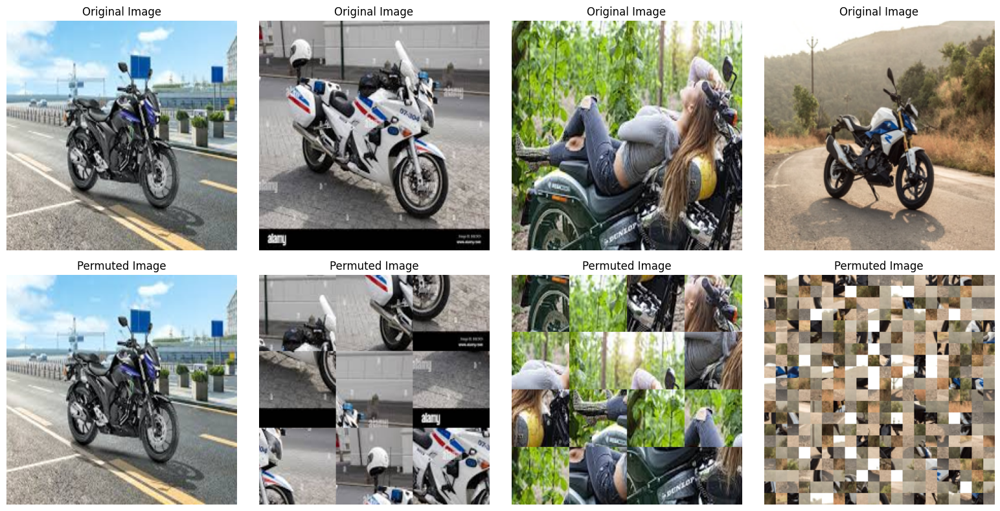

In [ ]:
original_images = []
permuted_images = []

tiles = split_image_into_tiles(images[6], 2)
permuted_tiles = permute_tiles_order(tiles, 2)
combined_image = combine_permuted_tiles(permuted_tiles, 2)
original_images.append(images[6])
permuted_images.append(combined_image)

tiles = split_image_into_tiles(images[100], 3)
permuted_tiles = permute_tiles_order(tiles, 3)
combined_image = combine_permuted_tiles(permuted_tiles, 3)
original_images.append(images[100])
permuted_images.append(combined_image)

tiles = split_image_into_tiles(images[1000], 4)
permuted_tiles = permute_tiles_order(tiles, 4)
combined_image = combine_permuted_tiles(permuted_tiles, 4)
original_images.append(images[1000])
permuted_images.append(combined_image)

tiles = split_image_into_tiles(images[1500], 20)
permuted_tiles = permute_tiles_order(tiles, 20)
combined_image = combine_permuted_tiles(permuted_tiles, 20)
original_images.append(images[1500])
permuted_images.append(combined_image)

plot_original_and_permuted_images(original_images, permuted_images)

## **2-Tile Permutations**

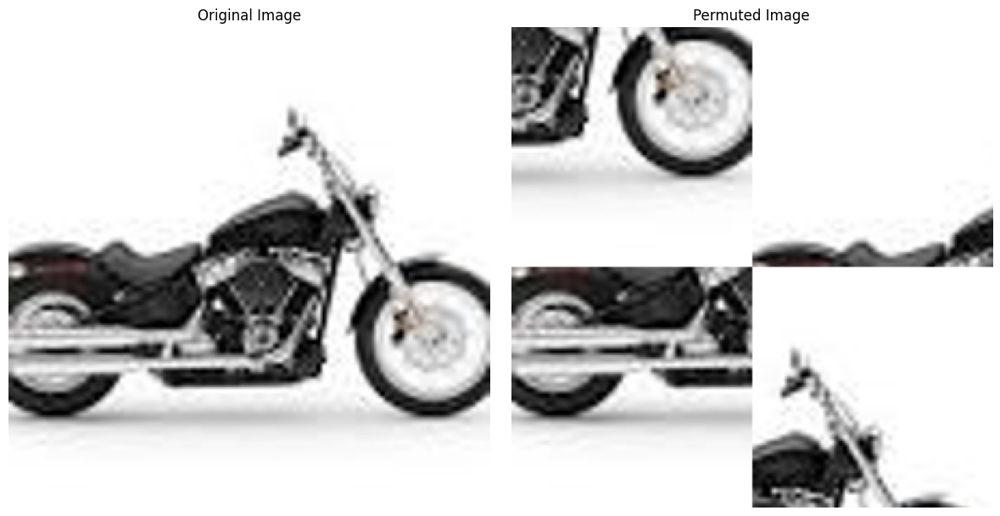

In [ ]:
img_display = images[1010]

tiles = split_image_into_tiles(img_display, 2)

permuted_tiles = permute_tiles_order(tiles, 2 )

combined_image = combine_permuted_tiles(permuted_tiles, 2 )

plot_original_and_permuted_image(img_display, combined_image)

To ensure consistency across subsequent runs, we will save the array to the computer

In [ ]:
#images_np_permutation_2x2=[]
#for image in images_np:
#    tiles = split_image_into_tiles(image, 2)

    # Permute the order of tiles
#    permuted_tiles = permute_tiles_order(tiles, 2)

    # Combine permuted tiles into a single image
#    combined_image = combine_permuted_tiles(permuted_tiles, 2)

#    images_np_permutation_2x2.append(combined_image)

#images_np_permutation_2x2=np.array(images_np_permutation_2x2)

#np.save('/content/drive/My Drive/Car-Bike-Dataset/2x2/images_np_permutation_2x2.npy', images_np_permutation_2x2)

In [13]:
images_np_permutation_2x2 = np.load('/content/drive/My Drive/Car-Bike-Dataset/2x2/images_np_permutation_2x2.npy')

X_train, X_test, y_train, y_test = train_test_split(images_np_permutation_2x2, labels_np, test_size=0.2, random_state=42)

X_train_tensor_2x2 = torch.tensor(X_train).permute(0, 3, 1, 2).float()
X_test_tensor_2x2 = torch.tensor(X_test).permute(0, 3, 1, 2).float()
y_train_tensor_2x2 = torch.tensor(y_train).long()
y_test_tensor_2x2 = torch.tensor(y_test).long()

train_dataset_2x2 = TensorDataset(X_train_tensor_2x2, y_train_tensor_2x2)
train_loader_2x2 = DataLoader(train_dataset_2x2, batch_size=16, shuffle=True)
test_dataset_2x2 = TensorDataset(X_test_tensor_2x2, y_test_tensor_2x2)
test_loader_2x2 = DataLoader(test_dataset_2x2, batch_size=16, shuffle=True)

Number of bike images train: 1584
Number of bike images test: 415
Number of car images train: 1612
Number of car images test: 385


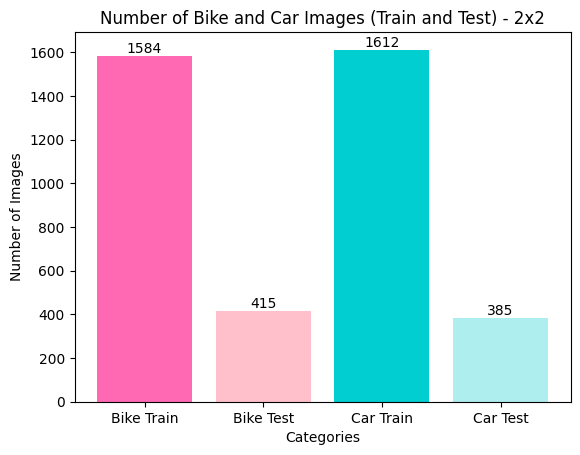

In [15]:
num_bike_images_train = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images_train = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images_train}")
print(f"Number of bike images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images_train}")
print(f"Number of car images test: {num_car_images_test}")

categories = ['Bike Train', 'Bike Test', 'Car Train', 'Car Test']
values = [num_bike_images_train, num_bike_images_test, num_car_images_train, num_car_images_test]

plt.bar(categories, values, color=['#FF69B4', '#FFC0CB', '#00CED1', '#AFEEEE'])
plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Number of Bike and Car Images (Train and Test) - 2x2')

for i in range(len(categories)):
    plt.text(i, values[i], str(values[i]), ha='center', va='bottom')

plt.xticks()
plt.show()

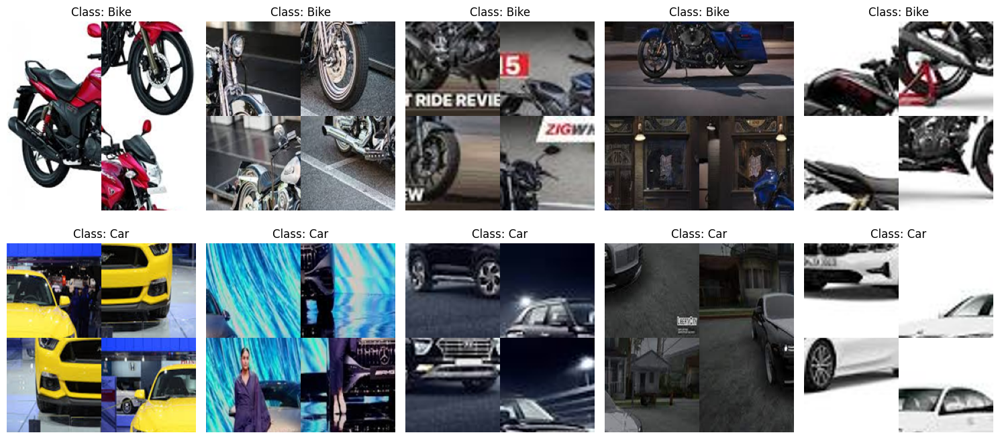

In [ ]:
plot_images(images_np_permutation_2x2, labels_np)

### **Resnet with 2-Tile Permutations**

In [ ]:
resnet18= resnet18_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(resnet18.parameters(), lr=0.001)

train_model(resnet18, train_loader_2x2, criterion, optimizer, num_epochs=2)

accuracy_2x2_resnet18, precision_2x2_resnet18, recall_2x2_resnet18, f1_2x2_resnet18, confusion_matrix_2x2_resnet18 = test_model(resnet18, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7512
Epoch 1/2, Iteration 100, Train Loss: 0.0840
Epoch 1/2, Iteration 200, Train Loss: 0.0897
Epoch 2/2, Iteration 1, Train Loss: 0.0988
Epoch 2/2, Iteration 100, Train Loss: 0.0703
Epoch 2/2, Iteration 200, Train Loss: 0.5456
Training completed.
Final Training Accuracy: 0.9612

Test Set Evaluation Metrics:
Accuracy: 0.95125
Precision: 0.9942857142857143
Recall: 0.9038961038961039
F1 Score: 0.9469387755102041
Confusion Matrix:
[[413   2]
 [ 37 348]]


### Densenet with 2-Tile Permutations

In [ ]:
densenet121=densenet121_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_2x2, criterion, optimizer,num_epochs=2)

accuracy_2x2_densenet121, precision_2x2_densenet121, recall_2x2_densenet121, f1_2x2_densenet121, confusion_matrix_2x2_densenet121 = test_model(densenet121, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6818
Epoch 1/2, Iteration 100, Train Loss: 0.3916
Epoch 1/2, Iteration 200, Train Loss: 0.0332
Epoch 2/2, Iteration 1, Train Loss: 0.0581
Epoch 2/2, Iteration 100, Train Loss: 0.0604
Epoch 2/2, Iteration 200, Train Loss: 0.0983
Training completed.
Final Training Accuracy: 0.9503

Test Set Evaluation Metrics:
Accuracy: 0.9725
Precision: 0.9865951742627346
Recall: 0.9558441558441558
F1 Score: 0.970976253298153
Confusion Matrix:
[[410   5]
 [ 17 368]]


### **Googlenet with 2-Tile Permutations**

In [ ]:
googlenet=googlenet_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_2x2, criterion, optimizer,num_epochs=2)

accuracy_2x2_googlenet, precision_2x2_googlenet, recall_2x2_googlenet, f1_2x2_googlenet, confusion_matrix_2x2_googlenet = test_model(googlenet, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7176
Epoch 1/2, Iteration 100, Train Loss: 0.0842
Epoch 1/2, Iteration 200, Train Loss: 0.0655
Epoch 2/2, Iteration 1, Train Loss: 0.0191
Epoch 2/2, Iteration 100, Train Loss: 0.1261
Epoch 2/2, Iteration 200, Train Loss: 0.1841
Training completed.
Final Training Accuracy: 0.9568

Test Set Evaluation Metrics:
Accuracy: 0.98375
Precision: 0.9869109947643979
Recall: 0.9792207792207792
F1 Score: 0.983050847457627
Confusion Matrix:
[[410   5]
 [  8 377]]


#### **Custom CNN with 2-Tile Permutations**

In [ ]:
Custom_CNN = CustomCNN()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(Custom_CNN.parameters(), lr=0.001)

train_model(Custom_CNN, train_loader_2x2, criterion, optimizer,num_epochs=2)

accuracy_2x2_Custom_CNN, precision_2x2_Custom_CNN, recall_2x2_Custom_CNN, f1_2x2_Custom_CNN, confusion_matrix_2x2_Custom_CNN = test_model(Custom_CNN, test_loader_2x2)

Epoch 1/2, Iteration 1, Train Loss: 0.6855
Epoch 1/2, Iteration 100, Train Loss: 0.6907
Epoch 1/2, Iteration 200, Train Loss: 0.6983
Epoch 2/2, Iteration 1, Train Loss: 0.6984
Epoch 2/2, Iteration 100, Train Loss: 0.6921
Epoch 2/2, Iteration 200, Train Loss: 0.6768
Training completed.
Final Training Accuracy: 0.4887

Test Set Evaluation Metrics:
Accuracy: 0.48125
Precision: 0.48125
Recall: 1.0
F1 Score: 0.649789029535865
Confusion Matrix:
[[  0 415]
 [  0 385]]


## **3-Tile Permutations**

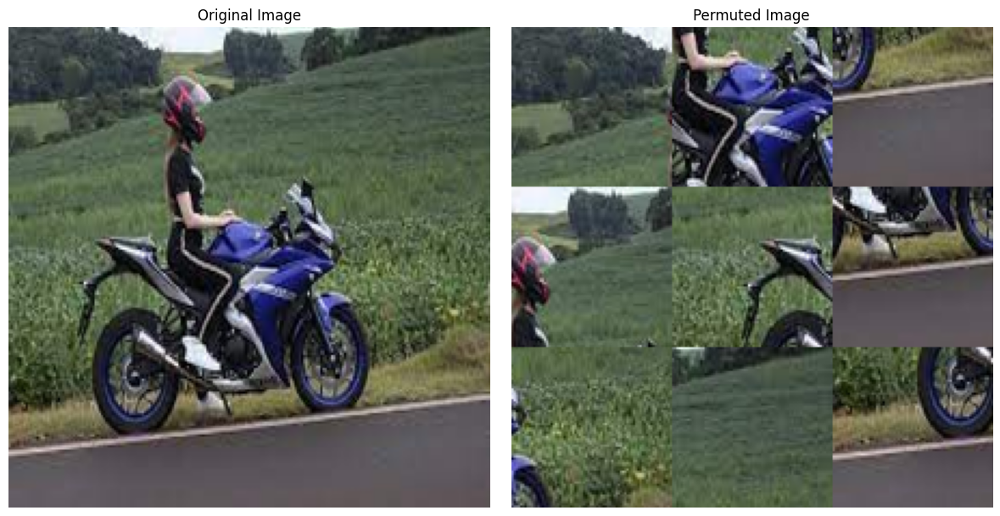

In [ ]:
img_display = images[102]

tiles = split_image_into_tiles(img_display, 3)

permuted_tiles = permute_tiles_order(tiles, 3 )

combined_image = combine_permuted_tiles(permuted_tiles, 3 )

plot_original_and_permuted_image(img_display, combined_image)

To ensure consistency across subsequent runs, we will save the array to the computer

In [ ]:
#images_np_permutation_3x3=[]
#for image in images_np:
#    tiles = split_image_into_tiles(image, 3)

    # Permute the order of tiles
#    permuted_tiles = permute_tiles_order(tiles, 3)

    # Combine permuted tiles into a single image
#    combined_image = combine_permuted_tiles(permuted_tiles, 3)

#    images_np_permutation_3x3.append(combined_image)

#images_np_permutation_3x3=np.array(images_np_permutation_3x3)


#np.save('/content/drive/My Drive/Car-Bike-Dataset/3x3/images_np_permutation_3x3.npy', images_np_permutation_3x3)

In [16]:
images_np_permutation_3x3 = np.load('/content/drive/My Drive/Car-Bike-Dataset/3x3/images_np_permutation_3x3.npy')

X_train, X_test, y_train, y_test = train_test_split(images_np_permutation_3x3, labels_np, test_size=0.2, random_state=42)

X_train_tensor_3x3 = torch.tensor(X_train.transpose(0, 3, 1, 2), dtype=torch.float).cuda()
X_test_tensor_3x3 = torch.tensor(X_test.transpose(0, 3, 1, 2), dtype=torch.float).cuda()
y_train_tensor_3x3 = torch.tensor(y_train, dtype=torch.long).cuda()
y_test_tensor_3x3 = torch.tensor(y_test, dtype=torch.long).cuda()

train_dataset_3x3 = TensorDataset(X_train_tensor_3x3, y_train_tensor_3x3)
train_loader_3x3 = DataLoader(train_dataset_3x3, batch_size=16, shuffle=True)
test_dataset_3x3 = TensorDataset(X_test_tensor_3x3, y_test_tensor_3x3)
test_loader_3x3 = DataLoader(test_dataset_3x3, batch_size=16, shuffle=True)

Number of bike images train: 1584
Number of bike images test: 415
Number of car images train: 1612
Number of car images test: 385


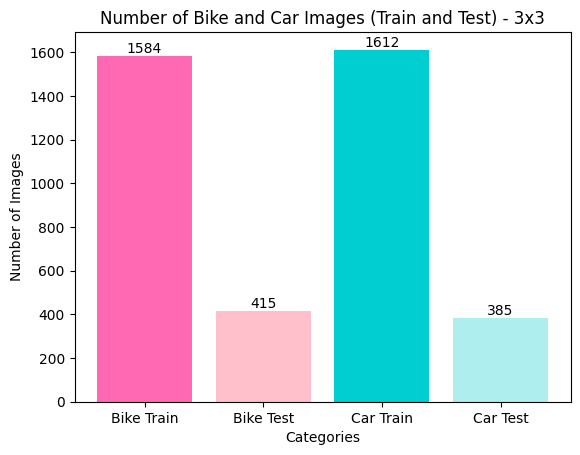

In [18]:
num_bike_images_train = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images_train = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images_train}")
print(f"Number of bike images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images_train}")
print(f"Number of car images test: {num_car_images_test}")

categories = ['Bike Train', 'Bike Test', 'Car Train', 'Car Test']
values = [num_bike_images_train, num_bike_images_test, num_car_images_train, num_car_images_test]

plt.bar(categories, values, color=['#FF69B4', '#FFC0CB', '#00CED1', '#AFEEEE'])
plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Number of Bike and Car Images (Train and Test) - 3x3')

for i in range(len(categories)):
    plt.text(i, values[i], str(values[i]), ha='center', va='bottom')

plt.xticks()
plt.show()

In [ ]:
batch_size_p, channels_p, height_p, width_p = 0, 0, 0, 0

for images, labels in train_loader_3x3:
    batch_size, channels, height, width = images.size()

    if (batch_size, channels, height, width) != (batch_size_p, channels_p, height_p, width_p):
        print("Batch size:", batch_size)
        print("Image dimensions (channels x height x width):", channels, "x", height, "x", width)

    batch_size_p, channels_p, height_p, width_p = batch_size, channels, height, width

Batch size: 16
Image dimensions (channels x height x width): 3 x 222 x 222
Batch size: 12
Image dimensions (channels x height x width): 3 x 222 x 222


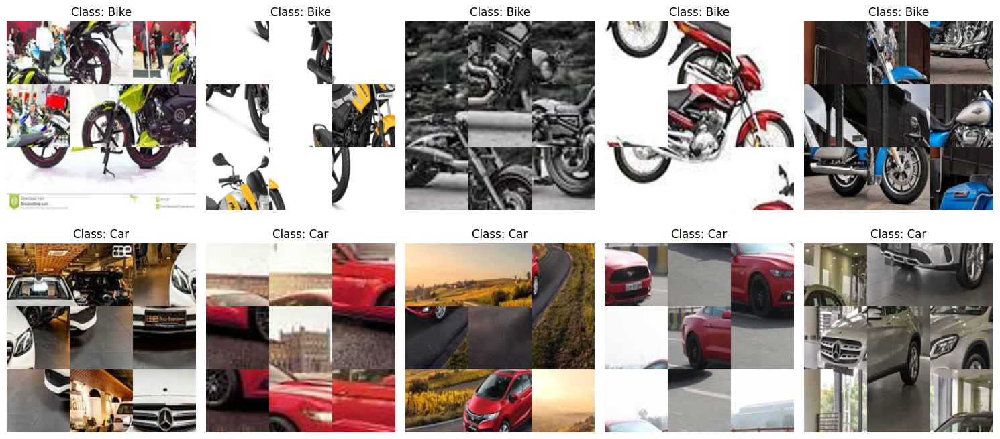

In [ ]:
plot_images(images_np_permutation_3x3, labels_np)

### **Resnet with 3-Tile Permutations**

In [ ]:
resnet18=resnet18_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(resnet18.parameters(), lr=0.001)

train_model(resnet18, train_loader_3x3, criterion, optimizer, num_epochs=2)

accuracy_3x3_resnet18, precision_3x3_resnet18, recall_3x3_resnet18, f1_3x3_resnet18, confusion_matrix_3x3_resnet18 = test_model(resnet18, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8300
Epoch 1/2, Iteration 100, Train Loss: 0.0910
Epoch 1/2, Iteration 200, Train Loss: 0.1669
Epoch 2/2, Iteration 1, Train Loss: 0.1433
Epoch 2/2, Iteration 100, Train Loss: 0.0184
Epoch 2/2, Iteration 200, Train Loss: 0.0358
Training completed.
Final Training Accuracy: 0.9409

Test Set Evaluation Metrics:
Accuracy: 0.68875
Precision: 0.6075949367088608
Recall: 0.9974025974025974
F1 Score: 0.7551622418879056
Confusion Matrix:
[[167 248]
 [  1 384]]


### **Densenet with 3-Tile Permutations**

In [ ]:
densenet121=densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_3x3, criterion, optimizer,num_epochs=2)

accuracy_3x3_densenet121, precision_3x3_densenet121, recall_3x3_densenet121, f1_3x3_densenet121, confusion_matrix_3x3_densenet121 = test_model(densenet121, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7311
Epoch 1/2, Iteration 100, Train Loss: 0.2410
Epoch 1/2, Iteration 200, Train Loss: 0.1246
Epoch 2/2, Iteration 1, Train Loss: 0.1160
Epoch 2/2, Iteration 100, Train Loss: 0.2721
Epoch 2/2, Iteration 200, Train Loss: 0.0412
Training completed.
Final Training Accuracy: 0.9296

Test Set Evaluation Metrics:
Accuracy: 0.92875
Precision: 0.9910179640718563
Recall: 0.8597402597402597
F1 Score: 0.9207232267037552
Confusion Matrix:
[[412   3]
 [ 54 331]]


### **Googlenet with 3-Tile Permutations**

In [ ]:
googlenet=googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_3x3, criterion, optimizer,num_epochs=2)

accuracy_3x3_googlenet, precision_3x3_googlenet, recall_3x3_googlenet, f1_3x3_dgooglenet, confusion_matrix_3x3_googlenet = test_model(googlenet, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6855
Epoch 1/2, Iteration 100, Train Loss: 0.1336
Epoch 1/2, Iteration 200, Train Loss: 0.2699
Epoch 2/2, Iteration 1, Train Loss: 0.2635
Epoch 2/2, Iteration 100, Train Loss: 0.1683
Epoch 2/2, Iteration 200, Train Loss: 0.1343
Training completed.
Final Training Accuracy: 0.9446

Test Set Evaluation Metrics:
Accuracy: 0.97375
Precision: 0.9619289340101523
Recall: 0.9844155844155844
F1 Score: 0.9730423620025674
Confusion Matrix:
[[400  15]
 [  6 379]]


## **4-Tile Permutations**

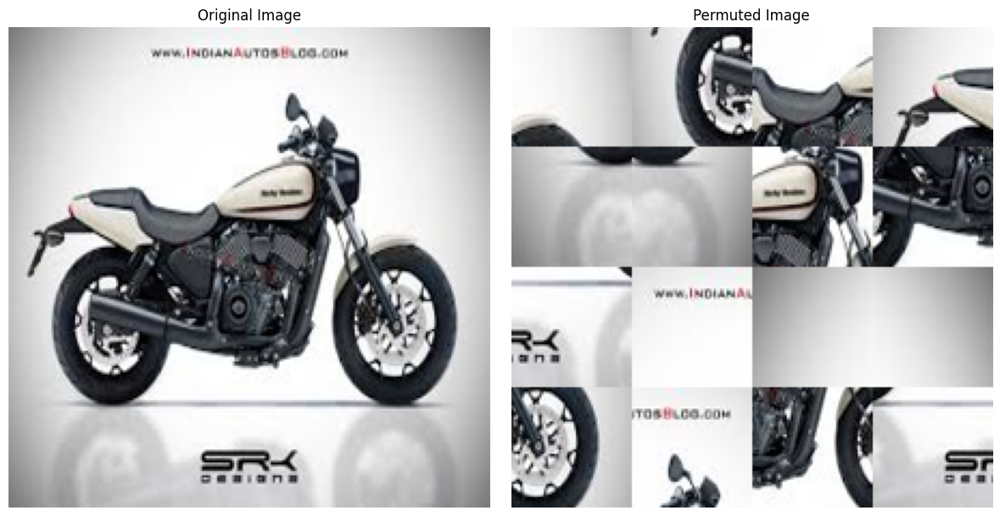

In [ ]:
img_display = images[700]

tiles = split_image_into_tiles(img_display, 4)

permuted_tiles = permute_tiles_order(tiles, 4 )

combined_image = combine_permuted_tiles(permuted_tiles, 4 )

plot_original_and_permuted_image(img_display, combined_image)

To ensure consistency across subsequent runs, we will save the array to the computer

In [ ]:
#images_np_permutation_4x4=[]
#for image in images_np:
#    tiles = split_image_into_tiles(image, 4)

    # Permute the order of tiles
#    permuted_tiles = permute_tiles_order(tiles, 4)

    # Combine permuted tiles into a single image
#    combined_image = combine_permuted_tiles(permuted_tiles, 4)

#    images_np_permutation_4x4.append(combined_image)

#images_np_permutation_4x4=np.array(images_np_permutation_4x4)

#np.save('/content/drive/My Drive/Car-Bike-Dataset/4x4/images_np_permutation_4x4.npy', images_np_permutation_4x4)

In [19]:
images_np_permutation_4x4 = np.load('/content/drive/My Drive/Car-Bike-Dataset/4x4/images_np_permutation_4x4.npy')

X_train, X_test, y_train, y_test = train_test_split(images_np_permutation_4x4, labels_np, test_size=0.2, random_state=42)

X_train_tensor_4x4 = torch.tensor(X_train.transpose(0, 3, 1, 2), dtype=torch.float).cuda()
X_test_tensor_4x4 = torch.tensor(X_test.transpose(0, 3, 1, 2), dtype=torch.float).cuda()
y_train_tensor_4x4 = torch.tensor(y_train, dtype=torch.long).cuda()
y_test_tensor_4x4 = torch.tensor(y_test, dtype=torch.long).cuda()

train_dataset_4x4 = TensorDataset(X_train_tensor_4x4, y_train_tensor_4x4)
train_loader_4x4 = DataLoader(train_dataset_4x4, batch_size=16, shuffle=True)
test_dataset_4x4 = TensorDataset(X_test_tensor_4x4, y_test_tensor_4x4)
test_loader_4x4 = DataLoader(test_dataset_4x4, batch_size=16, shuffle=True)

Number of bike images train: 1584
Number of bike images test: 415
Number of car images train: 1612
Number of car images test: 385


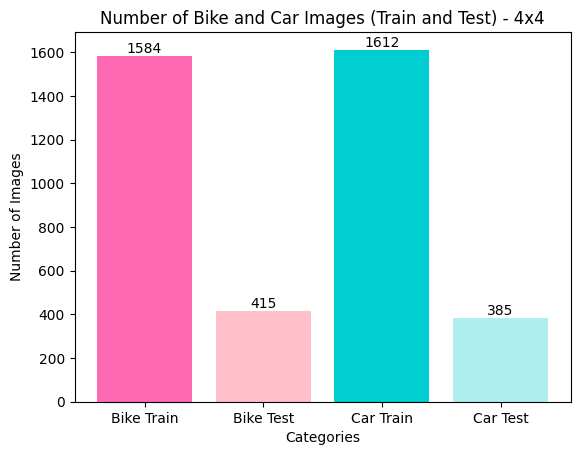

In [21]:
num_bike_images_train = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images_train = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images_train}")
print(f"Number of bike images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images_train}")
print(f"Number of car images test: {num_car_images_test}")

categories = ['Bike Train', 'Bike Test', 'Car Train', 'Car Test']
values = [num_bike_images_train, num_bike_images_test, num_car_images_train, num_car_images_test]

plt.bar(categories, values, color=['#FF69B4', '#FFC0CB', '#00CED1', '#AFEEEE'])
plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Number of Bike and Car Images (Train and Test) - 4x4')

for i in range(len(categories)):
    plt.text(i, values[i], str(values[i]), ha='center', va='bottom')

plt.xticks()
plt.show()

In [ ]:
batch_size_p, channels_p, height_p, width_p = 0, 0, 0, 0

for images, labels in train_loader_4x4:
    batch_size, channels, height, width = images.size()

    if (batch_size, channels, height, width) != (batch_size_p, channels_p, height_p, width_p):
        print("Batch size:", batch_size)
        print("Image dimensions (channels x height x width):", channels, "x", height, "x", width)

    batch_size_p, channels_p, height_p, width_p = batch_size, channels, height, width

Batch size: 16
Image dimensions (channels x height x width): 3 x 224 x 224
Batch size: 12
Image dimensions (channels x height x width): 3 x 224 x 224


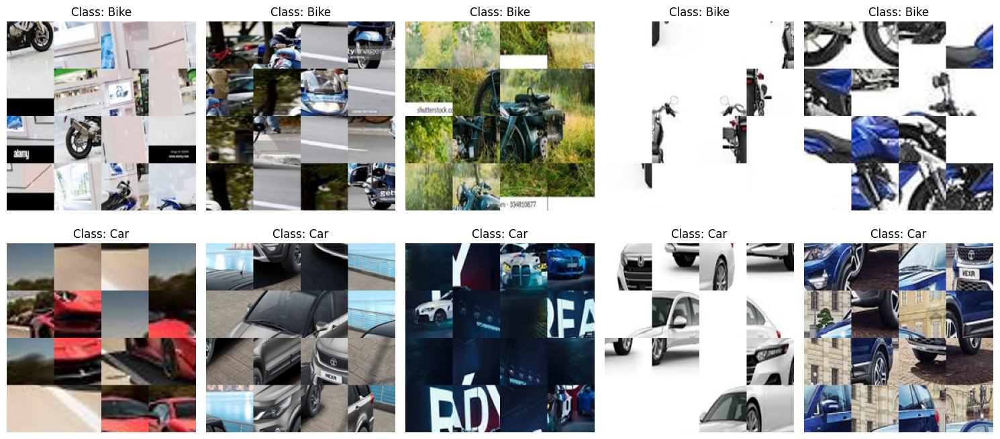

In [ ]:
plot_images(images_np_permutation_4x4, labels_np)

### **Resnet with 4-Tile Permutations**

In [ ]:
resnet18=resnet18_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(resnet18.parameters(), lr=0.001)

train_model(resnet18, train_loader_4x4, criterion, optimizer, num_epochs=2)
accuracy_4x4_resnet18, precision_4x4_resnet18, recall_4x4_resnet18, f1_4x4_resnet18, confusion_matrix_4x4_resnet18 = test_model(resnet18, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7095
Epoch 1/2, Iteration 100, Train Loss: 0.1665
Epoch 1/2, Iteration 200, Train Loss: 0.1735
Epoch 2/2, Iteration 1, Train Loss: 0.0124
Epoch 2/2, Iteration 100, Train Loss: 0.1069
Epoch 2/2, Iteration 200, Train Loss: 0.1266
Training completed.
Final Training Accuracy: 0.9309

Test Set Evaluation Metrics:
Accuracy: 0.91875
Precision: 0.8703703703703703
Recall: 0.9766233766233766
F1 Score: 0.9204406364749083
Confusion Matrix:
[[359  56]
 [  9 376]]


### **Densenet with 4-Tile Permutations**

In [ ]:
densenet121=densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)
train_model(densenet121, train_loader_4x4, criterion, optimizer,num_epochs=2)

accuracy_4x4_densenet121, precision_4x4_densenet121, recall_4x4_densenet121, f1_4x4_densenet121, confusion_matrix_4x4_densenet121 = test_model(densenet121, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8088
Epoch 1/2, Iteration 100, Train Loss: 0.1142
Epoch 1/2, Iteration 200, Train Loss: 0.1758
Epoch 2/2, Iteration 1, Train Loss: 0.2024
Epoch 2/2, Iteration 100, Train Loss: 0.2322
Epoch 2/2, Iteration 200, Train Loss: 0.1285
Training completed.
Final Training Accuracy: 0.9296

Test Set Evaluation Metrics:
Accuracy: 0.95375
Precision: 0.9202898550724637
Recall: 0.9896103896103896
F1 Score: 0.9536921151439298
Confusion Matrix:
[[382  33]
 [  4 381]]


### **Googlenet with 4-Tile Permutations**

In [ ]:
googlenet=googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_4x4, criterion, optimizer,num_epochs=2)

accuracy_4x4_googlenet, precision_4x4_googlenet, recall_4x4_googlenet, f1_4x4_dgooglenet, confusion_matrix_4x4_googlenet = test_model(googlenet, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6952
Epoch 1/2, Iteration 100, Train Loss: 0.1440
Epoch 1/2, Iteration 200, Train Loss: 0.1220
Epoch 2/2, Iteration 1, Train Loss: 0.0526
Epoch 2/2, Iteration 100, Train Loss: 0.0780
Epoch 2/2, Iteration 200, Train Loss: 0.0520
Training completed.
Final Training Accuracy: 0.9565

Test Set Evaluation Metrics:
Accuracy: 0.89375
Precision: 0.8275109170305677
Recall: 0.9844155844155844
F1 Score: 0.8991696322657177
Confusion Matrix:
[[336  79]
 [  6 379]]


## **20-Tile Permutations**

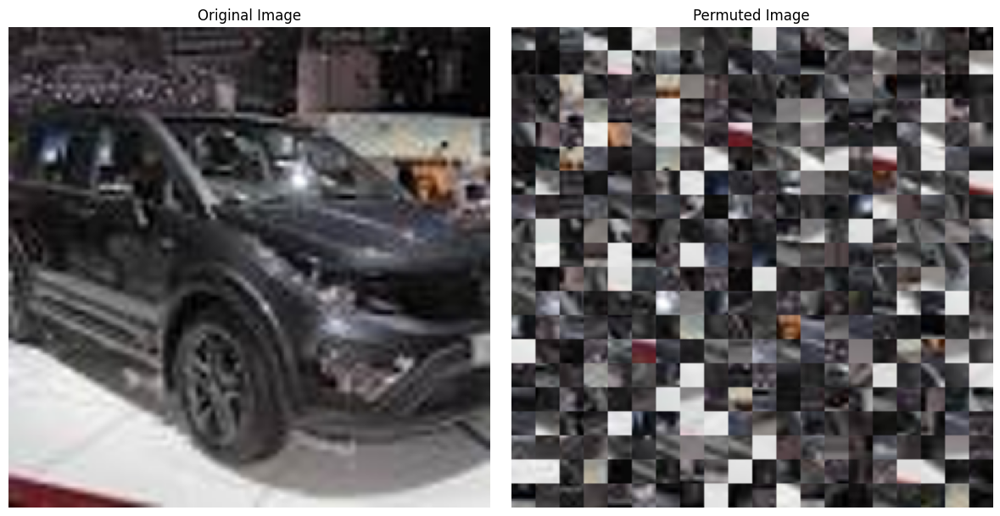

In [ ]:
img_display = images[2222]

tiles = split_image_into_tiles(img_display, 20)

permuted_tiles = permute_tiles_order(tiles, 20 )

combined_image = combine_permuted_tiles(permuted_tiles, 20 )

plot_original_and_permuted_image(img_display, combined_image)

To ensure consistency across subsequent runs, we will save the array to the computer

In [ ]:
#images_np_permutation_20x20=[]
#for image in images_np:
#    tiles = split_image_into_tiles(image, 20)

    # Permute the order of tiles
#    permuted_tiles = permute_tiles_order(tiles, 20)

    # Combine permuted tiles into a single image
#    combined_image = combine_permuted_tiles(permuted_tiles, 20)

#    images_np_permutation_20x20.append(combined_image)

#images_np_permutation_20x20=np.array(images_np_permutation_20x20)

#np.save('/content/drive/My Drive/Car-Bike-Dataset/20x20/images_np_permutation_20x20.npy', images_np_permutation_20x20)

In [22]:
images_np_permutation_20x20 = np.load('/content/drive/My Drive/Car-Bike-Dataset/20x20/images_np_permutation_20x20.npy')

X_train, X_test, y_train, y_test = train_test_split(images_np_permutation_20x20, labels_np, test_size=0.2, random_state=42)

X_train_tensor_20x20 = torch.tensor(X_train.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor_20x20 = torch.tensor(X_test.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor_20x20 = torch.tensor(y_train, dtype=torch.long)
y_test_tensor_20x20 = torch.tensor(y_test, dtype=torch.long)

train_dataset_20x20 = TensorDataset(X_train_tensor_20x20, y_train_tensor_20x20)
train_loader_20x20 = DataLoader(train_dataset_20x20, batch_size=16, shuffle=True)
test_dataset_20x20 = TensorDataset(X_test_tensor_20x20, y_test_tensor_20x20)
test_loader_20x20 = DataLoader(test_dataset_20x20, batch_size=16, shuffle=True)

Number of bike images train: 1584
Number of bike images test: 415
Number of car images train: 1612
Number of car images test: 385


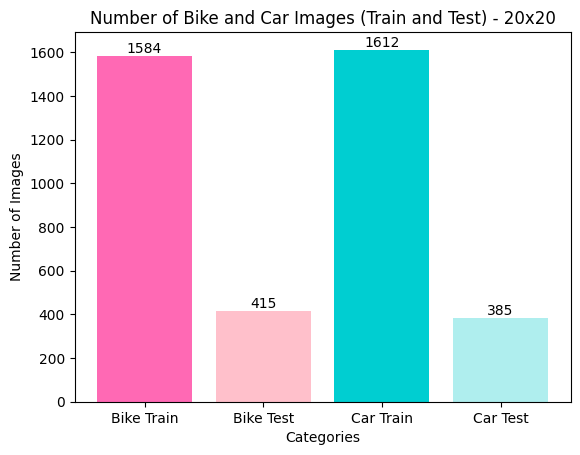

In [24]:
num_bike_images_train = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images_train = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images_train}")
print(f"Number of bike images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images_train}")
print(f"Number of car images test: {num_car_images_test}")

categories = ['Bike Train', 'Bike Test', 'Car Train', 'Car Test']
values = [num_bike_images_train, num_bike_images_test, num_car_images_train, num_car_images_test]

plt.bar(categories, values, color=['#FF69B4', '#FFC0CB', '#00CED1', '#AFEEEE'])
plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Number of Bike and Car Images (Train and Test) - 20x20')

for i in range(len(categories)):
    plt.text(i, values[i], str(values[i]), ha='center', va='bottom')

plt.xticks()
plt.show()

In [ ]:
batch_size_p, channels_p, height_p, width_p = 0, 0, 0, 0

for images, labels in train_loader_20x20:
    batch_size, channels, height, width = images.size()

    if (batch_size, channels, height, width) != (batch_size_p, channels_p, height_p, width_p):
        print("Batch size:", batch_size)
        print("Image dimensions (channels x height x width):", channels, "x", height, "x", width)

    batch_size_p, channels_p, height_p, width_p = batch_size, channels, height, width

Batch size: 16
Image dimensions (channels x height x width): 3 x 220 x 220
Batch size: 12
Image dimensions (channels x height x width): 3 x 220 x 220


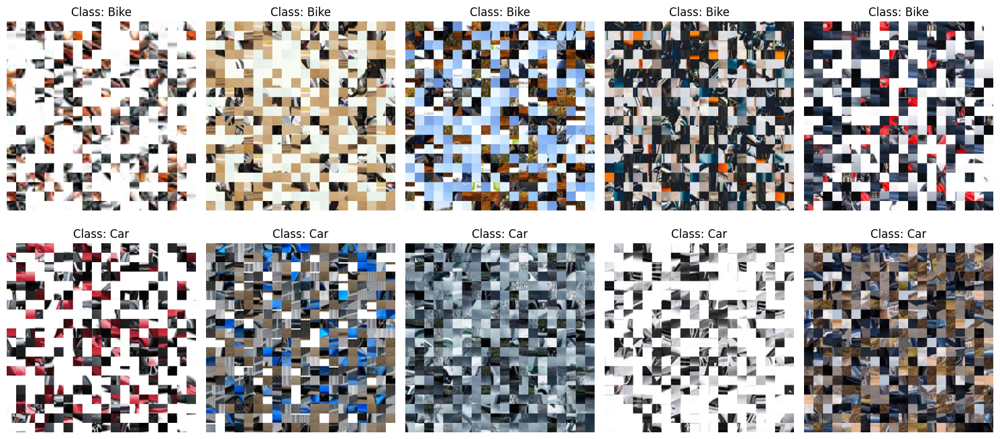

In [ ]:
plot_images(images_np_permutation_20x20, labels_np)

### **Resnet with 20-Tile Permutations**

In [ ]:
resnet18=resnet18_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(resnet18.parameters(), lr=0.001)

train_model(resnet18, train_loader_20x20, criterion, optimizer, num_epochs=2)

accuracy_20x20_resnet18, precision_20x20_resnet18, recall_20x20_resnet18, f1_20x20_resnet18, confusion_matrix_20x20_resnet18 = test_model(resnet18, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7019
Epoch 1/2, Iteration 100, Train Loss: 0.7253
Epoch 1/2, Iteration 200, Train Loss: 0.2368
Epoch 2/2, Iteration 1, Train Loss: 0.6571
Epoch 2/2, Iteration 100, Train Loss: 0.5580
Epoch 2/2, Iteration 200, Train Loss: 0.3620
Training completed.
Final Training Accuracy: 0.8417

Test Set Evaluation Metrics:
Accuracy: 0.5375
Precision: 0.9411764705882353
Recall: 0.04155844155844156
F1 Score: 0.07960199004975124
Confusion Matrix:
[[414   1]
 [369  16]]


### **Densnet with 20-Tile Permutations**

In [ ]:
densenet121=densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_20x20, criterion, optimizer,num_epochs=2)

accuracy_20x20_densenet121, precision_20x20_densenet121, recall_20x20_densenet121, f1_20x20_densenet121, confusion_matrix_20x20_densenet121 = test_model(densenet121, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8109
Epoch 1/2, Iteration 100, Train Loss: 0.5506
Epoch 1/2, Iteration 200, Train Loss: 0.3003
Epoch 2/2, Iteration 1, Train Loss: 0.1850
Epoch 2/2, Iteration 100, Train Loss: 0.4344
Epoch 2/2, Iteration 200, Train Loss: 0.5293
Training completed.
Final Training Accuracy: 0.8698

Test Set Evaluation Metrics:
Accuracy: 0.8375
Precision: 0.7524752475247525
Recall: 0.987012987012987
F1 Score: 0.8539325842696629
Confusion Matrix:
[[290 125]
 [  5 380]]


### **Googlenet with 20-Tile Permutations**

In [ ]:
googlenet=googlenet_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_20x20, criterion, optimizer,num_epochs=2)

accuracy_20x20_googlenet, precision_20x20_googlenet, recall_20x20_googlenet, f1_20x20_dgooglenet, confusion_matrix_20x20_googlenet = test_model(googlenet, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7065
Epoch 1/2, Iteration 100, Train Loss: 0.3471
Epoch 1/2, Iteration 200, Train Loss: 0.2253
Epoch 2/2, Iteration 1, Train Loss: 0.5229
Epoch 2/2, Iteration 100, Train Loss: 0.3303
Epoch 2/2, Iteration 200, Train Loss: 0.3809
Training completed.
Final Training Accuracy: 0.8711

Test Set Evaluation Metrics:
Accuracy: 0.81625
Precision: 0.759825327510917
Recall: 0.9038961038961039
F1 Score: 0.8256227758007116
Confusion Matrix:
[[305 110]
 [ 37 348]]


### **Custom CNN with 20-Tile Permutations**

In [ ]:
Custom_CNN = CustomCNN_220x220()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(Custom_CNN.parameters(), lr=0.001)

train_model(Custom_CNN, train_loader_20x20, criterion, optimizer,num_epochs=2)

accuracy_20x20_Custom_CNN, precision_20x20_Custom_CNN, recall_20x20_Custom_CNN, f1_20x20_Custom_CNN, confusion_matrix_20x20_Custom_CNN = test_model(Custom_CNN, test_loader_20x20)

Epoch 1/2, Iteration 1, Train Loss: 0.7652
Epoch 1/2, Iteration 100, Train Loss: 0.6858
Epoch 1/2, Iteration 200, Train Loss: 0.6919
Epoch 2/2, Iteration 1, Train Loss: 0.6941
Epoch 2/2, Iteration 100, Train Loss: 0.7004
Epoch 2/2, Iteration 200, Train Loss: 0.6935
Training completed.
Final Training Accuracy: 0.5078

Test Set Evaluation Metrics:
Accuracy: 0.52375
Precision: 1.0
Recall: 0.01038961038961039
F1 Score: 0.02056555269922879
Confusion Matrix:
[[415   0]
 [381   4]]


## **Analyzing Models Results:**
Due to the significant number of models implemented, the lectures consumed excessive GPU memory. Consequently, we periodically reset the runtime and restarted all models. As a result, we was needed to save manually the results of each model.

In [ ]:
##baseline
accuracy_baseline_resnet18 = 0.96875
precision_baseline_resnet18 = 1.0
recall_baseline_resnet18 = 0.935064935064935
f1_baseline_resnet18 = 0.9664429530201343
confusion_matrix_baseline_resnet18 = [[415, 0],[25,360]]

accuracy_baseline_googlenet = 0.98375
precision_baseline_googlenet = 0.9869109947643979
recall_baseline_googlenet = 0.9792207792207792
f1_baseline_googlenet = 0.983050847457627
confusion_matrix_baseline_googlenet = [[410, 5], [8, 277]]

accuracy_baseline_densenet = 0.97875
precision_baseline_densenet = 0.9893617021276596
recall_baseline_densenet = 0.9662337662337662
f1_baseline_densenet = 0.9776609724047306
confusion_matrix_baseline_densenet = [[411, 4], [12, 372]]

accuracy_baseline_Custom_CNN = 0.48125
precision_baseline_Custom_CNN =0.48125
recall_baseline_Custom_CNN = 1.0
f1_baseline_Custom_CNN = 0.649789029535865
confusion_matrix_baseline_Custom_CNN = [[0, 415], [0, 385]]


#2x2

accuracy_2x2_resnet18 = 0.9513
precision_2x2_resnet18 = 0.9943
recall_2x2_resnet18 = 0.9039
f1_2x2_resnet18 = 0.9469
confusion_matrix_2x2_resnet18 = [[413,   2], [ 37, 348]]

accuracy_2x2_densenet121 = 0.9725
precision_2x2_densenet121 = 0.9866
recall_2x2_densenet121 = 0.9558
f1_2x2_densenet121 = 0.9710
confusion_matrix_2x2_densenet121 = [[410,   5], [ 17, 368]]

accuracy_2x2_googlenet = 0.9838
precision_2x2_googlenet = 0.9869
recall_2x2_googlenet = 0.9792
f1_2x2_googlenet = 0.9831
confusion_matrix_2x2_googlenet = [[410,   5], [  8, 377]]

accuracy_2x2_Custom_CNN= 0.48125
precision_2x2_Custom_CNN= 0.48125
recall_2x2_Custom_CNN= 1.0
f1_2x2_Custom_CNN= 0.649789029535865
confusion_matrix_2x2_Custom_CNN= [[  0,415],[0,385]]


## 3x3
accuracy_3x3_resnet18 = 0.6887
precision_3x3_resnet18 = 0.6076
recall_3x3_resnet18 = 0.9974
f1_3x3_resnet18 = 0.7552
confusion_matrix_3x3_resnet18 = [[167, 248], [  1, 384]]

accuracy_3x3_densenet121 = 0.9287
precision_3x3_densenet121 = 0.9910
recall_3x3_densenet121 = 0.8597
f1_3x3_densenet121 = 0.9207
confusion_matrix_3x3_densenet121 = [[412,   3], [ 54, 331]]

accuracy_3x3_googlenet = 0.9738
precision_3x3_googlenet = 0.9619
recall_3x3_googlenet = 0.9844
f1_3x3_googlenet = 0.9730
confusion_matrix_3x3_googlenet = [[400,  15], [  6, 379]]

## 4x4
accuracy_4x4_resnet18 = 0.9187
precision_4x4_resnet18 = 0.8704
recall_4x4_resnet18 = 0.9766
f1_4x4_resnet18 = 0.9204
confusion_matrix_4x4_resnet18 = [[359,  56], [  9, 376]]

accuracy_4x4_densenet121 = 0.9537
precision_4x4_densenet121 = 0.9203
recall_4x4_densenet121 = 0.9896
f1_4x4_densenet121 = 0.9537
confusion_matrix_4x4_densenet121 = [[382,  33], [  4, 381]]

accuracy_4x4_googlenet = 0.8938
precision_4x4_googlenet = 0.8275
recall_4x4_googlenet = 0.9844
f1_4x4_googlenet = 0.8992
confusion_matrix_4x4_googlenet = [[336,  79], [  6, 379]]


##20x20

accuracy_20x20_resnet18 = 0.5375
precision_20x20_resnet18 = 0.9412
recall_20x20_resnet18 = 0.0416
f1_20x20_resnet18 = 0.0796
confusion_matrix_20x20_resnet18 = [[414,   1], [369,  16]]

accuracy_20x20_densenet121 = 0.8375
precision_20x20_densenet121 = 0.7525
recall_20x20_densenet121 = 0.9870
f1_20x20_densenet121 = 0.8539
confusion_matrix_20x20_densenet121 = [[290, 125], [  5, 380]]

accuracy_20x20_googlenet = 0.8163
precision_20x20_googlenet = 0.7598
recall_20x20_googlenet = 0.9039
f1_20x20_googlenet = 0.8256
confusion_matrix_20x20_googlenet = [[305, 110], [ 37, 348]]

accuracy_20x20_Custom_CNN= 0.52375
precision_20x20_Custom_CNN= 1.0
recall_20x20_Custom_CNN= 0.01038961038961039
f1_20x20_Custom_CNN= 0.02056555269922879
confusion_matrix_20x20_Custom_CNN=[[415 ,  0], [381 , 4]]

## **Architectural Performance Comparison Across Different Permutations**






In [115]:
def plot_evaluation_metrics(architecture, f1_scores, accuracy_scores, recall_scores, precision_scores, title):
    metrics = ['F1 Score', 'Accuracy', 'Recall', 'Precision']
    scores = [f1_scores, accuracy_scores, recall_scores, precision_scores]

    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    fig.suptitle(title)

    colors = ['#FF69B4', '#FFA07A', '#FFC0CB', '#FF1493']

    for i, metric in enumerate(metrics):
        axs[i].bar(architecture, scores[i], color=colors)
        axs[i].set_title(metric)
        axs[i].set_ylabel(metric)
        axs[i].set_ylim(0, 1)
        for j, score in enumerate(scores[i]):
            axs[i].text(j, score - 0.075, round(score, 2), ha='center', va='bottom', color='black', fontsize=10)
            print(f"{metric} for {architecture[j]}: {round(score, 2)}")

    plt.tight_layout()
    plt.show()

F1 Score for ResNet: 0.97
F1 Score for GoogLeNet: 0.98
F1 Score for DenseNet: 0.98
F1 Score for CustomCNN: 0.65
Accuracy for ResNet: 0.97
Accuracy for GoogLeNet: 0.98
Accuracy for DenseNet: 0.98
Accuracy for CustomCNN: 0.48
Recall for ResNet: 0.94
Recall for GoogLeNet: 0.98
Recall for DenseNet: 0.97
Recall for CustomCNN: 1.0
Precision for ResNet: 1.0
Precision for GoogLeNet: 0.99
Precision for DenseNet: 0.99
Precision for CustomCNN: 0.48


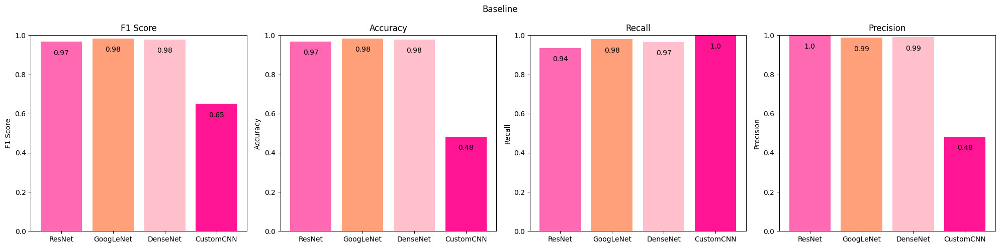

In [ ]:
architectures = ['ResNet', 'GoogLeNet', 'DenseNet','CustomCNN']
arch= ['ResNet', 'GoogLeNet', 'DenseNet']

baseline_f1 = [f1_baseline_resnet18, f1_baseline_googlenet, f1_baseline_densenet,f1_baseline_Custom_CNN]
baseline_accuracy = [accuracy_baseline_resnet18, accuracy_baseline_googlenet, accuracy_baseline_densenet,accuracy_baseline_Custom_CNN]
baseline_recall = [recall_baseline_resnet18, recall_baseline_googlenet, recall_baseline_densenet,recall_baseline_Custom_CNN]
baseline_precision = [ precision_baseline_resnet18, precision_baseline_googlenet, precision_baseline_densenet,precision_baseline_Custom_CNN]
plot_evaluation_metrics(architectures, baseline_f1, baseline_accuracy, baseline_recall, baseline_precision, 'Baseline')

F1 Score for ResNet: 0.95
F1 Score for GoogLeNet: 0.98
F1 Score for DenseNet: 0.97
F1 Score for CustomCNN: 0.65
Accuracy for ResNet: 0.95
Accuracy for GoogLeNet: 0.98
Accuracy for DenseNet: 0.97
Accuracy for CustomCNN: 0.48
Recall for ResNet: 0.9
Recall for GoogLeNet: 0.98
Recall for DenseNet: 0.96
Recall for CustomCNN: 1.0
Precision for ResNet: 0.99
Precision for GoogLeNet: 0.99
Precision for DenseNet: 0.99
Precision for CustomCNN: 0.48


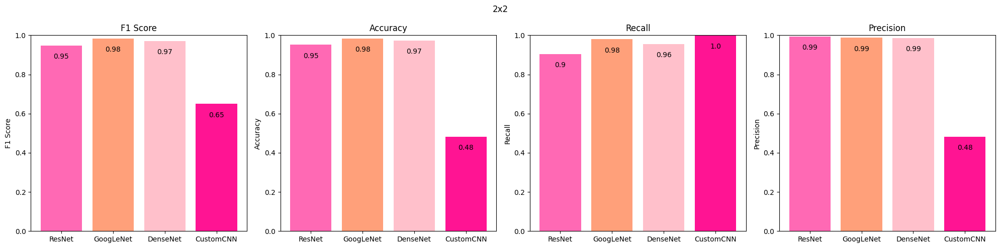

In [ ]:
# Plot for 2x2
config_2x2_f1 = [f1_2x2_resnet18, f1_2x2_googlenet, f1_2x2_densenet121,f1_2x2_Custom_CNN]
config_2x2_accuracy = [accuracy_2x2_resnet18, accuracy_2x2_googlenet, accuracy_2x2_densenet121,accuracy_2x2_Custom_CNN]
config_2x2_recall = [recall_2x2_resnet18, recall_2x2_googlenet, recall_2x2_densenet121,recall_2x2_Custom_CNN]
config_2x2_precision = [precision_2x2_resnet18, precision_2x2_googlenet, precision_2x2_densenet121,precision_2x2_Custom_CNN]
plot_evaluation_metrics(architectures, config_2x2_f1, config_2x2_accuracy, config_2x2_recall, config_2x2_precision, '2x2')

F1 Score for ResNet: 0.76
F1 Score for GoogLeNet: 0.97
F1 Score for DenseNet: 0.92
Accuracy for ResNet: 0.69
Accuracy for GoogLeNet: 0.97
Accuracy for DenseNet: 0.93
Recall for ResNet: 1.0
Recall for GoogLeNet: 0.98
Recall for DenseNet: 0.86
Precision for ResNet: 0.61
Precision for GoogLeNet: 0.96
Precision for DenseNet: 0.99


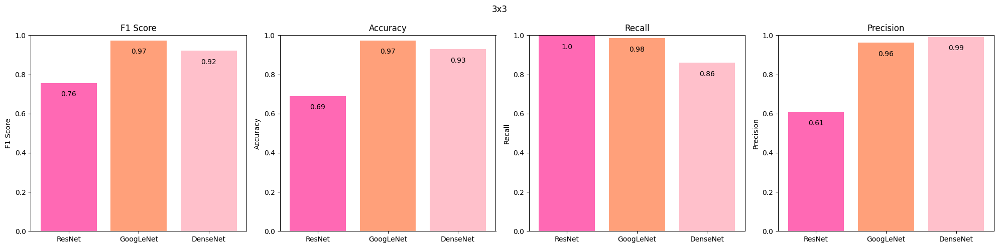

In [ ]:
# Plot for 3x3
config_3x3_f1 = [f1_3x3_resnet18, f1_3x3_googlenet, f1_3x3_densenet121]
config_3x3_accuracy = [accuracy_3x3_resnet18, accuracy_3x3_googlenet, accuracy_3x3_densenet121]
config_3x3_recall = [ recall_3x3_resnet18, recall_3x3_googlenet, recall_3x3_densenet121]
config_3x3_precision = [ precision_3x3_resnet18, precision_3x3_googlenet, precision_3x3_densenet121]
plot_evaluation_metrics(arch, config_3x3_f1, config_3x3_accuracy, config_3x3_recall, config_3x3_precision, '3x3')

F1 Score for ResNet: 0.92
F1 Score for GoogLeNet: 0.9
F1 Score for DenseNet: 0.95
Accuracy for ResNet: 0.92
Accuracy for GoogLeNet: 0.89
Accuracy for DenseNet: 0.95
Recall for ResNet: 0.98
Recall for GoogLeNet: 0.98
Recall for DenseNet: 0.99
Precision for ResNet: 0.87
Precision for GoogLeNet: 0.83
Precision for DenseNet: 0.92


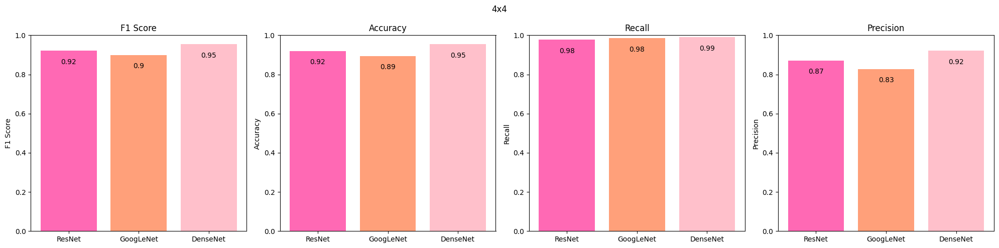

In [ ]:
# Plot for 4x4
config_4x4_f1 = [f1_4x4_resnet18, f1_4x4_googlenet, f1_4x4_densenet121]
config_4x4_accuracy = [accuracy_4x4_resnet18, accuracy_4x4_googlenet, accuracy_4x4_densenet121]
config_4x4_recall = [recall_4x4_resnet18, recall_4x4_googlenet, recall_4x4_densenet121]
config_4x4_precision = [precision_4x4_resnet18, precision_4x4_googlenet, precision_4x4_densenet121]
plot_evaluation_metrics(arch, config_4x4_f1, config_4x4_accuracy, config_4x4_recall, config_4x4_precision, '4x4')

F1 Score for ResNet: 0.08
F1 Score for GoogLeNet: 0.83
F1 Score for DenseNet: 0.85
F1 Score for CustomCNN: 0.02
Accuracy for ResNet: 0.54
Accuracy for GoogLeNet: 0.82
Accuracy for DenseNet: 0.84
Accuracy for CustomCNN: 0.52
Recall for ResNet: 0.04
Recall for GoogLeNet: 0.9
Recall for DenseNet: 0.99
Recall for CustomCNN: 0.01
Precision for ResNet: 0.94
Precision for GoogLeNet: 0.76
Precision for DenseNet: 0.75
Precision for CustomCNN: 1.0


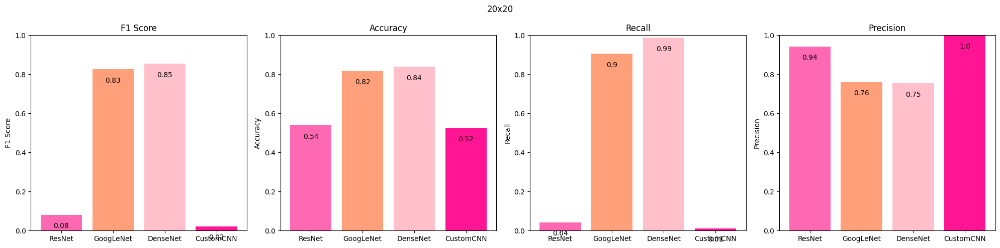

In [ ]:
# Plot for 20x20
config_20x20_f1 = [f1_20x20_resnet18, f1_20x20_googlenet, f1_20x20_densenet121,f1_20x20_Custom_CNN]
config_20x20_accuracy = [ accuracy_20x20_resnet18, accuracy_20x20_googlenet, accuracy_20x20_densenet121,accuracy_20x20_Custom_CNN]
config_20x20_recall = [recall_20x20_resnet18, recall_20x20_googlenet, recall_20x20_densenet121,recall_20x20_Custom_CNN]
config_20x20_precision = [precision_20x20_resnet18, precision_20x20_googlenet, precision_20x20_densenet121,precision_20x20_Custom_CNN]
plot_evaluation_metrics(architectures, config_20x20_f1, config_20x20_accuracy, config_20x20_recall, config_20x20_precision, '20x20')

## **Comparing models  by evaluation metrics for each permutation type**



In [ ]:
def plot_evaluation_metrics(architecture, baseline_scores, data_2x2_scores, data_3x3_scores, data_4x4_scores, data_20x20_scores, title):
    metrics = ['F1 Score', 'Accuracy', 'Recall', 'Precision']
    scores = [baseline_scores, data_2x2_scores, data_3x3_scores, data_4x4_scores, data_20x20_scores]
    permutations = ['Baseline', '2x2', '3x3', '4x4', '20x20']

    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    fig.suptitle(title)

    colors = ['#FF69B4', '#FFA07A', '#FFC0CB', '#FF1493', '#00CED1']  # Feminine colors

    for i, metric in enumerate(metrics):
        axs[i].bar(permutations, [score[i] for score in scores], color=colors)
        axs[i].set_title(metric)
        axs[i].set_ylabel(metric)
        axs[i].set_ylim(0, 1)
        for j, score in enumerate([score[i] for score in scores]):
            axs[i].text(j, score - 0.075, round(score, 2), ha='center', va='bottom', color='black', fontsize=10)
            print(f"{metric} for {architecture}: {round(score, 2)} (permutation: {permutations[j]})")

    plt.tight_layout()
    plt.show()


In [ ]:
def plot_evaluation_metrics1(architecture, baseline_scores, data_2x2_scores, data_20x20_scores, title):
    metrics = ['F1 Score', 'Accuracy', 'Recall', 'Precision']
    scores = [baseline_scores, data_2x2_scores, data_20x20_scores]
    permutations = ['Baseline', '2x2', '20x20']

    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    fig.suptitle(title)

    colors = ['#FF69B4', '#FF1493', '#00CED1']

    for i, metric in enumerate(metrics):
        axs[i].bar(permutations, [score[i] for score in scores], color=colors)
        axs[i].set_title(metric)
        axs[i].set_ylabel(metric)
        axs[i].set_ylim(0, 1)
        for j, score in enumerate([score[i] for score in scores]):
            axs[i].text(j, score - 0.075, round(score, 2), ha='center', va='bottom', color='black', fontsize=10)
            print(f"{metric} for {architecture}: {round(score, 2)} (permutation: {permutations[j]})")

    plt.tight_layout()
    plt.show()


F1 Score for ResNet18: 0.97 (permutation: Baseline)
F1 Score for ResNet18: 0.95 (permutation: 2x2)
F1 Score for ResNet18: 0.76 (permutation: 3x3)
F1 Score for ResNet18: 0.92 (permutation: 4x4)
F1 Score for ResNet18: 0.08 (permutation: 20x20)
Accuracy for ResNet18: 0.97 (permutation: Baseline)
Accuracy for ResNet18: 0.95 (permutation: 2x2)
Accuracy for ResNet18: 0.69 (permutation: 3x3)
Accuracy for ResNet18: 0.92 (permutation: 4x4)
Accuracy for ResNet18: 0.54 (permutation: 20x20)
Recall for ResNet18: 0.94 (permutation: Baseline)
Recall for ResNet18: 0.9 (permutation: 2x2)
Recall for ResNet18: 1.0 (permutation: 3x3)
Recall for ResNet18: 0.98 (permutation: 4x4)
Recall for ResNet18: 0.04 (permutation: 20x20)
Precision for ResNet18: 1.0 (permutation: Baseline)
Precision for ResNet18: 0.99 (permutation: 2x2)
Precision for ResNet18: 0.61 (permutation: 3x3)
Precision for ResNet18: 0.87 (permutation: 4x4)
Precision for ResNet18: 0.94 (permutation: 20x20)


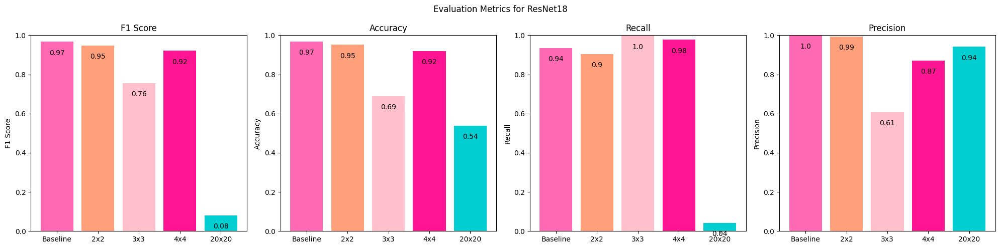

In [ ]:
plot_evaluation_metrics("ResNet18",
                        [f1_baseline_resnet18, accuracy_baseline_resnet18, recall_baseline_resnet18, precision_baseline_resnet18],
                        [f1_2x2_resnet18, accuracy_2x2_resnet18, recall_2x2_resnet18, precision_2x2_resnet18],
                        [f1_3x3_resnet18, accuracy_3x3_resnet18, recall_3x3_resnet18, precision_3x3_resnet18],
                        [f1_4x4_resnet18, accuracy_4x4_resnet18, recall_4x4_resnet18, precision_4x4_resnet18],
                        [f1_20x20_resnet18, accuracy_20x20_resnet18, recall_20x20_resnet18, precision_20x20_resnet18],
                        "Evaluation Metrics for ResNet18")

F1 Score for GoogleNet: 0.98 (permutation: Baseline)
F1 Score for GoogleNet: 0.98 (permutation: 2x2)
F1 Score for GoogleNet: 0.97 (permutation: 3x3)
F1 Score for GoogleNet: 0.9 (permutation: 4x4)
F1 Score for GoogleNet: 0.83 (permutation: 20x20)
Accuracy for GoogleNet: 0.98 (permutation: Baseline)
Accuracy for GoogleNet: 0.98 (permutation: 2x2)
Accuracy for GoogleNet: 0.97 (permutation: 3x3)
Accuracy for GoogleNet: 0.89 (permutation: 4x4)
Accuracy for GoogleNet: 0.82 (permutation: 20x20)
Recall for GoogleNet: 0.98 (permutation: Baseline)
Recall for GoogleNet: 0.98 (permutation: 2x2)
Recall for GoogleNet: 0.98 (permutation: 3x3)
Recall for GoogleNet: 0.98 (permutation: 4x4)
Recall for GoogleNet: 0.9 (permutation: 20x20)
Precision for GoogleNet: 0.99 (permutation: Baseline)
Precision for GoogleNet: 0.99 (permutation: 2x2)
Precision for GoogleNet: 0.96 (permutation: 3x3)
Precision for GoogleNet: 0.83 (permutation: 4x4)
Precision for GoogleNet: 0.76 (permutation: 20x20)


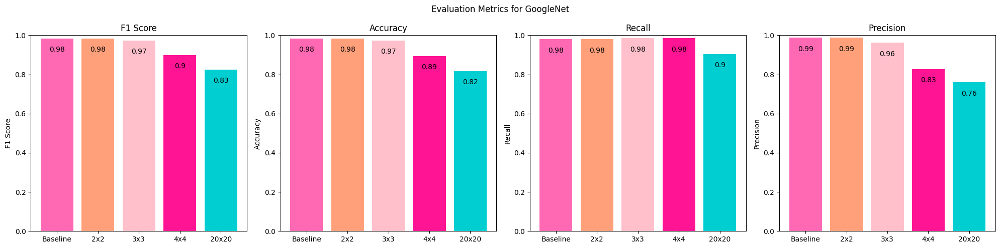

In [ ]:
# Plot for GoogLeNet
plot_evaluation_metrics("GoogleNet",
                        [f1_baseline_googlenet, accuracy_baseline_googlenet, recall_baseline_googlenet, precision_baseline_googlenet],
                        [f1_2x2_googlenet, accuracy_2x2_googlenet, recall_2x2_googlenet, precision_2x2_googlenet],
                        [f1_3x3_googlenet, accuracy_3x3_googlenet, recall_3x3_googlenet, precision_3x3_googlenet],
                        [f1_4x4_googlenet, accuracy_4x4_googlenet, recall_4x4_googlenet, precision_4x4_googlenet],
                        [f1_20x20_googlenet, accuracy_20x20_googlenet, recall_20x20_googlenet, precision_20x20_googlenet],
                        "Evaluation Metrics for GoogleNet")

F1 Score for DenseNet-121: 0.98 (permutation: Baseline)
F1 Score for DenseNet-121: 0.97 (permutation: 2x2)
F1 Score for DenseNet-121: 0.92 (permutation: 3x3)
F1 Score for DenseNet-121: 0.95 (permutation: 4x4)
F1 Score for DenseNet-121: 0.85 (permutation: 20x20)
Accuracy for DenseNet-121: 0.98 (permutation: Baseline)
Accuracy for DenseNet-121: 0.97 (permutation: 2x2)
Accuracy for DenseNet-121: 0.93 (permutation: 3x3)
Accuracy for DenseNet-121: 0.95 (permutation: 4x4)
Accuracy for DenseNet-121: 0.84 (permutation: 20x20)
Recall for DenseNet-121: 0.97 (permutation: Baseline)
Recall for DenseNet-121: 0.96 (permutation: 2x2)
Recall for DenseNet-121: 0.86 (permutation: 3x3)
Recall for DenseNet-121: 0.99 (permutation: 4x4)
Recall for DenseNet-121: 0.99 (permutation: 20x20)
Precision for DenseNet-121: 0.99 (permutation: Baseline)
Precision for DenseNet-121: 0.99 (permutation: 2x2)
Precision for DenseNet-121: 0.99 (permutation: 3x3)
Precision for DenseNet-121: 0.92 (permutation: 4x4)
Precision f

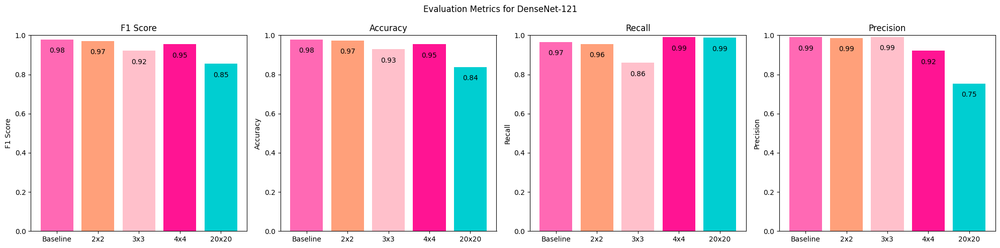

In [ ]:
# Plot for DenseNet
plot_evaluation_metrics("DenseNet-121",
                        [f1_baseline_densenet, accuracy_baseline_densenet, recall_baseline_densenet, precision_baseline_densenet],
                        [f1_2x2_densenet121, accuracy_2x2_densenet121, recall_2x2_densenet121, precision_2x2_densenet121],
                        [f1_3x3_densenet121, accuracy_3x3_densenet121, recall_3x3_densenet121, precision_3x3_densenet121],
                        [f1_4x4_densenet121, accuracy_4x4_densenet121, recall_4x4_densenet121, precision_4x4_densenet121],
                        [f1_20x20_densenet121, accuracy_20x20_densenet121, recall_20x20_densenet121, precision_20x20_densenet121],
                        "Evaluation Metrics for DenseNet-121")

F1 Score for Custom CNN: 0.65 (permutation: Baseline)
F1 Score for Custom CNN: 0.65 (permutation: 2x2)
F1 Score for Custom CNN: 0.02 (permutation: 20x20)
Accuracy for Custom CNN: 0.48 (permutation: Baseline)
Accuracy for Custom CNN: 0.48 (permutation: 2x2)
Accuracy for Custom CNN: 0.52 (permutation: 20x20)
Recall for Custom CNN: 1.0 (permutation: Baseline)
Recall for Custom CNN: 1.0 (permutation: 2x2)
Recall for Custom CNN: 0.01 (permutation: 20x20)
Precision for Custom CNN: 0.48 (permutation: Baseline)
Precision for Custom CNN: 0.48 (permutation: 2x2)
Precision for Custom CNN: 1.0 (permutation: 20x20)


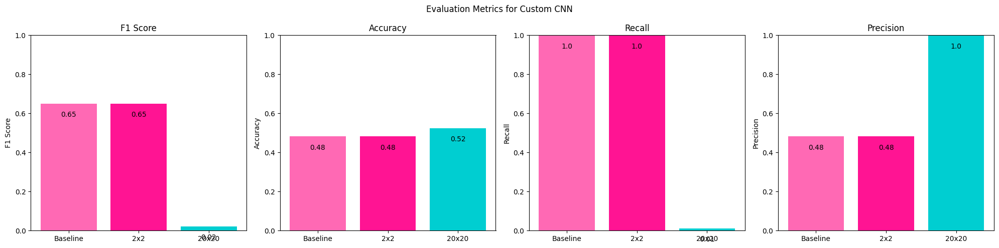

In [ ]:
# Plot for Custom_CNN
plot_evaluation_metrics1("Custom CNN",
                        [f1_baseline_Custom_CNN, accuracy_baseline_Custom_CNN, recall_baseline_Custom_CNN, precision_baseline_Custom_CNN],
                        [f1_2x2_Custom_CNN, accuracy_2x2_Custom_CNN, recall_2x2_Custom_CNN, precision_2x2_Custom_CNN],
                        [f1_20x20_Custom_CNN, accuracy_20x20_Custom_CNN, recall_20x20_Custom_CNN, precision_20x20_Custom_CNN],
                        "Evaluation Metrics for Custom CNN")

## **Exploring the confusion matrix**
Kindly reminder- label 0 corresponds to Bike and label 1 corresponds to Car.

**TP (True Positive):** The count of Cars that were correctly classified as Cars.<br>
**FP (False Positive):** The count of Bikes that were incorrectly classified as Cars. <br>
**TN (True Negative):** The count of Bikes that were correctly classified as Bikes. <br>
**FN (False Negative):** The count of Cars that were incorrectly classified as Bikes.

These metrics are crucial for understanding your model's performance beyond just accuracy, as they reveal the types of errors the model is making.

In [ ]:
def plot_confusion_matrix_fp_fn(confusion_matrices, model_name=''):
    # Calculate FP and FN percentages
    fp_percentages = {}
    fn_percentages = {}

    for arch_perm, matrix in confusion_matrices.items():
        fp = matrix[0][1] / sum(matrix[0])  # False positives: FP / (FP + TN)
        fn = matrix[1][0] / sum(matrix[1])  # False negatives: FN / (FN + TP)
        fp_percentages[arch_perm] = fp * 100
        fn_percentages[arch_perm] = fn * 100
        print(f"Architecture: {arch_perm}")
        print(f"FP: {fp*100:.2f}%")
        print(f"FN: {fn*100:.2f}%\n")

    # Create bar chart
    bar_width = 0.35
    index = np.arange(len(confusion_matrices))

    plt.figure(figsize=(12, 6))
    bars_fp = plt.bar(index, fp_percentages.values(), bar_width, label='False Positives (Car for Bike)', color='#FFA07A')  # Feminine color for False Positives
    bars_fn = plt.bar(index + bar_width, fn_percentages.values(), bar_width, label='False Negatives (Bike for Car)', color='#FF1493')  # Feminine color for False Negatives

    plt.ylabel('Percentage')
    plt.xticks(index + bar_width / 2, fp_percentages.keys())
    plt.legend()
    plt.title(f'FP and FN - {model_name}')  # Include model name in the title

    # Annotate each bar with its percentage value
    for bar in bars_fp + bars_fn:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, height, f'{height:.2f}%', ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

Architecture: baseline
FP: 0.00%
FN: 6.49%

Architecture: 2x2
FP: 0.48%
FN: 9.61%

Architecture: 3x3
FP: 59.76%
FN: 0.26%

Architecture: 4x4
FP: 13.49%
FN: 2.34%

Architecture: 20x20
FP: 0.24%
FN: 95.84%



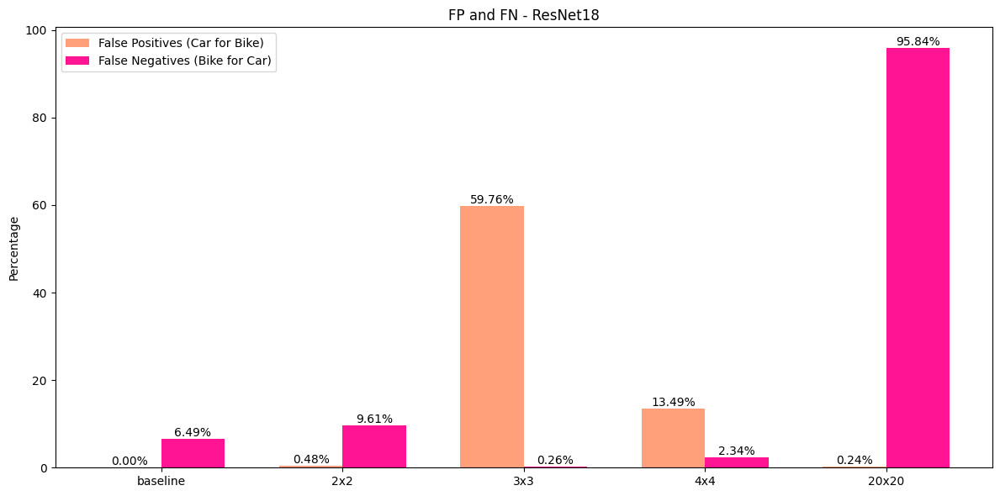

In [ ]:
confusion_matrices_resnet18 = {
    'baseline': confusion_matrix_baseline_resnet18,
    '2x2': confusion_matrix_2x2_resnet18,
    '3x3': confusion_matrix_3x3_resnet18,
    '4x4': confusion_matrix_4x4_resnet18,
    '20x20': confusion_matrix_20x20_resnet18,
}

plot_confusion_matrix_fp_fn(confusion_matrices_resnet18, model_name='ResNet18')

Architecture: baseline
FP: 0.96%
FN: 3.12%

Architecture: 2x2
FP: 1.20%
FN: 4.42%

Architecture: 3x3
FP: 0.72%
FN: 14.03%

Architecture: 4x4
FP: 7.95%
FN: 1.04%

Architecture: 20x20
FP: 30.12%
FN: 1.30%



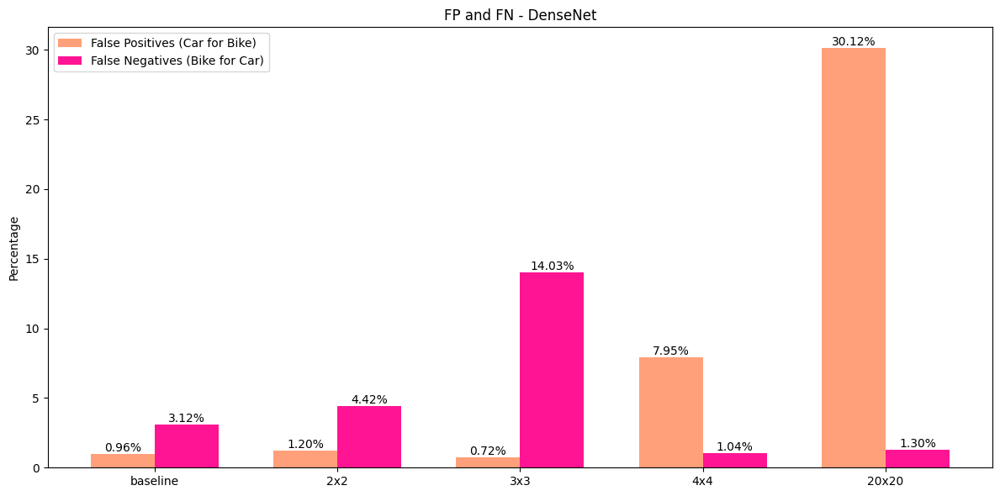

In [ ]:
confusion_matrices_densenet = {
    'baseline': confusion_matrix_baseline_densenet,
    '2x2': confusion_matrix_2x2_densenet121,
    '3x3': confusion_matrix_3x3_densenet121,
    '4x4': confusion_matrix_4x4_densenet121,
    '20x20': confusion_matrix_20x20_densenet121,
}

plot_confusion_matrix_fp_fn(confusion_matrices_densenet, model_name='DenseNet')


Architecture: baseline
FP: 1.20%
FN: 2.81%

Architecture: 2x2
FP: 1.20%
FN: 2.08%

Architecture: 3x3
FP: 3.61%
FN: 1.56%

Architecture: 4x4
FP: 19.04%
FN: 1.56%

Architecture: 20x20
FP: 26.51%
FN: 9.61%



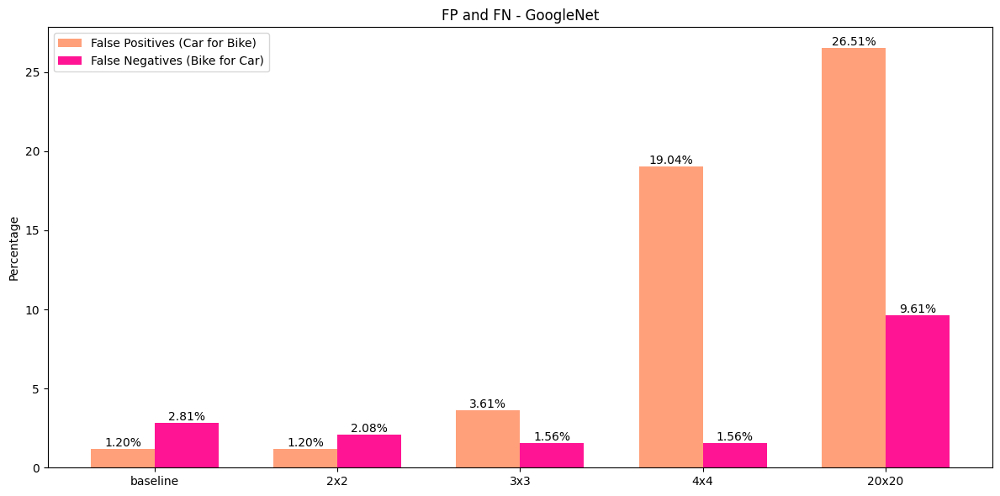

In [ ]:
confusion_matrices_googlenet = {
    'baseline': confusion_matrix_baseline_googlenet,
    '2x2': confusion_matrix_2x2_googlenet,
    '3x3': confusion_matrix_3x3_googlenet,
    '4x4': confusion_matrix_4x4_googlenet,
    '20x20': confusion_matrix_20x20_googlenet,
}

plot_confusion_matrix_fp_fn(confusion_matrices_googlenet, model_name='GoogleNet')

Architecture: baseline
FP: 100.00%
FN: 0.00%

Architecture: 2x2
FP: 100.00%
FN: 0.00%

Architecture: 20x20
FP: 0.00%
FN: 98.96%



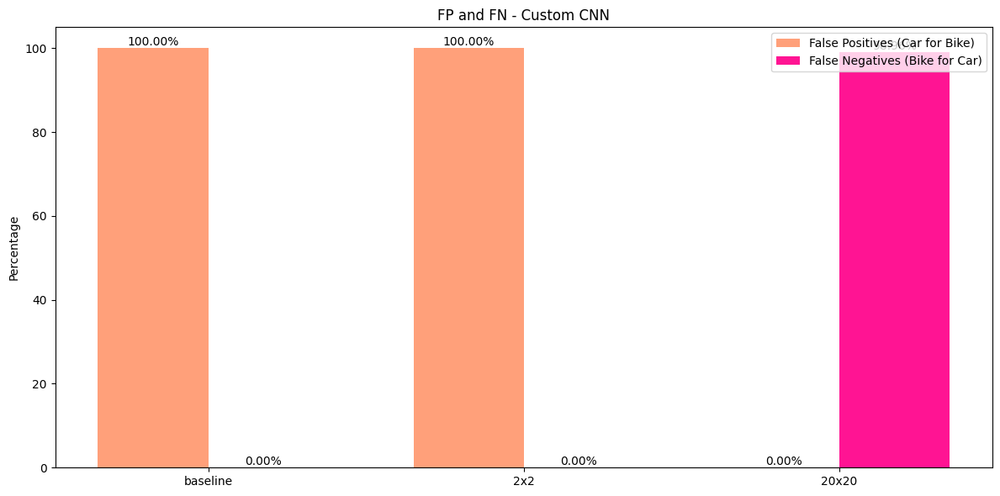

In [ ]:
confusion_matrices_Custom_CNN = {
    'baseline': confusion_matrix_baseline_Custom_CNN,
    '2x2': confusion_matrix_2x2_Custom_CNN,
    '20x20': confusion_matrix_20x20_Custom_CNN,
}

plot_confusion_matrix_fp_fn(confusion_matrices_Custom_CNN, model_name='Custom CNN')

# **Enhancing Performance: Exploring Optimization Strategies for DenseNet and GoogleNet**
Now, let's delve deeper into the performance of DenseNet and GoogleNet, which emerged as the top performers across most types of permutations.<br>
We will explore various hyperparameters and examine the changes, differences, and their effects.

## **Batch Normalization-**
### **GoogleNet With Batch Norm-**

In [ ]:
def googlenet_batchnorm_model():

  googlenet_BatchNorm = models.googlenet(pretrained=True)
  googlenet_BatchNorm.aux_logits = False

  num_features = googlenet_BatchNorm.fc.in_features
  googlenet_BatchNorm.fc = nn.Sequential(
    nn.Linear(num_features, 256),
    nn.BatchNorm1d(256),
    nn.ReLU(inplace=True),
    nn.Dropout(0.5),
    nn.Linear(256, 2)  # Number of classes: Bike and Car
    )
  return googlenet_BatchNorm

### **DenseNet With BatchNorm-**

In [ ]:
def densenet121_batchnorm_model():
  densenet121_BatchNorm = models.densenet121(pretrained=True)

  num_features = densenet121_BatchNorm.classifier.in_features
  densenet121_BatchNorm.classifier = nn.Sequential(
    nn.Linear(num_features, 256),
    nn.BatchNorm1d(256),
    nn.ReLU(inplace=True),
    nn.Dropout(0.5),
    nn.Linear(256, 2)  # Number of classes: Bike and Car
    )
  return densenet121_BatchNorm

### **Baseline**
#### **GoogleNet**

In [ ]:
googlenet=googlenet_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader, criterion, optimizer,num_epochs=2)

accuracy_baseline_googlenet_batchnorm, precision_baseline_googlenet_batchnorm, recall_baseline_googlenet_batchnorm, f1_baseline_googlenet_batchnorm, confusion_matrix_baseline_googlenet_batchnorm = test_model(googlenet, test_loader)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8452
Epoch 1/2, Iteration 100, Train Loss: 0.0780
Epoch 1/2, Iteration 200, Train Loss: 0.7619
Epoch 2/2, Iteration 1, Train Loss: 0.1340
Epoch 2/2, Iteration 100, Train Loss: 0.3420
Epoch 2/2, Iteration 200, Train Loss: 0.0270
Training completed.
Final Training Accuracy: 0.9640

Test Set Evaluation Metrics:
Accuracy: 0.99125
Precision: 0.9921875
Recall: 0.9896103896103896
F1 Score: 0.9908972691807542
Confusion Matrix:
[[412   3]
 [  4 381]]


### **DenseNet**

In [ ]:
densenet121= densenet121_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader, criterion, optimizer,num_epochs=2)

accuracy_baseline_densenet_batchnorm, precision_baseline_densenet_batchnorm, recall_baseline_densenet_batchnorm, f1_baseline_densenet_batchnorm, confusion_matrix_baseline_densenet_batchnorm = test_model(densenet121, test_loader)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6536
Epoch 1/2, Iteration 100, Train Loss: 0.0829
Epoch 1/2, Iteration 200, Train Loss: 0.0095
Epoch 2/2, Iteration 1, Train Loss: 0.0133
Epoch 2/2, Iteration 100, Train Loss: 0.1861
Epoch 2/2, Iteration 200, Train Loss: 0.0670
Training completed.
Final Training Accuracy: 0.9612

Test Set Evaluation Metrics:
Accuracy: 0.93625
Precision: 0.9940828402366864
Recall: 0.8727272727272727
F1 Score: 0.929460580912863
Confusion Matrix:
[[413   2]
 [ 49 336]]


### **2-Tile Permutations**
#### **GoogleNet**

In [ ]:
googlenet=googlenet_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_2x2, criterion, optimizer,num_epochs=2)

accuracy_2x2_googlenet_batchnorm, precision_2x2_googlenet_batchnorm, recall_2x2_googlenet_batchnorm, f1_2x2_googlenet_batchnorm, confusion_matrix_2x2_googlenet_batchnorm = test_model(googlenet, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7559
Epoch 1/2, Iteration 100, Train Loss: 0.1138
Epoch 1/2, Iteration 200, Train Loss: 0.1468
Epoch 2/2, Iteration 1, Train Loss: 0.0544
Epoch 2/2, Iteration 100, Train Loss: 0.0958
Epoch 2/2, Iteration 200, Train Loss: 0.6541
Training completed.
Final Training Accuracy: 0.9496

Test Set Evaluation Metrics:
Accuracy: 0.93625
Precision: 0.9911764705882353
Recall: 0.8753246753246753
F1 Score: 0.9296551724137931
Confusion Matrix:
[[412   3]
 [ 48 337]]


### **DenseNet**

In [ ]:
densenet121= densenet121_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_2x2, criterion, optimizer,num_epochs=2)

accuracy_2x2_densenet_batchnorm, precision_2x2_densenet_batchnorm, recall_2x2_densenet_batchnorm, f1_2x2_densenet_batchnorm, confusion_matrix_2x2_densenet_batchnorm = test_model(densenet121, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7401
Epoch 1/2, Iteration 100, Train Loss: 0.0963
Epoch 1/2, Iteration 200, Train Loss: 0.1086
Epoch 2/2, Iteration 1, Train Loss: 0.0745
Epoch 2/2, Iteration 100, Train Loss: 0.4237
Epoch 2/2, Iteration 200, Train Loss: 0.0626
Training completed.
Final Training Accuracy: 0.9352

Test Set Evaluation Metrics:
Accuracy: 0.96625
Precision: 0.9685863874345549
Recall: 0.961038961038961
F1 Score: 0.9647979139504563
Confusion Matrix:
[[403  12]
 [ 15 370]]


### **3-Tile Permutations**
#### **GoogleNet**

In [ ]:
googlenet=googlenet_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_3x3, criterion, optimizer,num_epochs=2)

accuracy_3x3_googlenet_batchnorm, precision_3x3_googlenet_batchnorm, recall_3x3_googlenet_batchnorm, f1_3x3_googlenet_batchnorm, confusion_matrix_3x3_googlenet_batchnorm = test_model(googlenet, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6685
Epoch 1/2, Iteration 100, Train Loss: 0.0402
Epoch 1/2, Iteration 200, Train Loss: 0.0157
Epoch 2/2, Iteration 1, Train Loss: 0.0601
Epoch 2/2, Iteration 100, Train Loss: 0.0220
Epoch 2/2, Iteration 200, Train Loss: 0.1616
Training completed.
Final Training Accuracy: 0.9446

Test Set Evaluation Metrics:
Accuracy: 0.94
Precision: 0.9941348973607038
Recall: 0.8805194805194805
F1 Score: 0.933884297520661
Confusion Matrix:
[[413   2]
 [ 46 339]]


### **DenseNet**

In [ ]:
densenet121= densenet121_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_3x3, criterion, optimizer,num_epochs=2)

accuracy_3x3_densenet_batchnorm, precision_3x3_densenet_batchnorm, recall_3x3_densenet_batchnorm, f1_3x3_densenet_batchnorm, confusion_matrix_3x3_densenet_batchnorm = test_model(densenet121, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.9024
Epoch 1/2, Iteration 100, Train Loss: 0.7463
Epoch 1/2, Iteration 200, Train Loss: 0.1738
Epoch 2/2, Iteration 1, Train Loss: 0.3410
Epoch 2/2, Iteration 100, Train Loss: 0.0539
Epoch 2/2, Iteration 200, Train Loss: 0.0393
Training completed.
Final Training Accuracy: 0.9418

Test Set Evaluation Metrics:
Accuracy: 0.94875
Precision: 0.9751381215469613
Recall: 0.9168831168831169
F1 Score: 0.9451137884872824
Confusion Matrix:
[[406   9]
 [ 32 353]]


### **4-Tile Permutations**
#### **GoogleNet**

In [ ]:
googlenet=googlenet_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_4x4, criterion, optimizer,num_epochs=2)

accuracy_4x4_googlenet_batchnorm, precision_4x4_googlenet_batchnorm, recall_4x4_googlenet_batchnorm, f1_4x4_googlenet_batchnorm, confusion_matrix_4x4_googlenet_batchnorm = test_model(googlenet, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 1.0304
Epoch 1/2, Iteration 100, Train Loss: 0.2907
Epoch 1/2, Iteration 200, Train Loss: 0.1342
Epoch 2/2, Iteration 1, Train Loss: 0.0610
Epoch 2/2, Iteration 100, Train Loss: 0.1052
Epoch 2/2, Iteration 200, Train Loss: 0.0186
Training completed.
Final Training Accuracy: 0.9449

Test Set Evaluation Metrics:
Accuracy: 0.94125
Precision: 0.9941520467836257
Recall: 0.8831168831168831
F1 Score: 0.9353507565337001
Confusion Matrix:
[[413   2]
 [ 45 340]]


### **DenseNet**

In [ ]:
densenet121= densenet121_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_4x4, criterion, optimizer,num_epochs=2)

accuracy_4x4_densenet_batchnorm, precision_4x4_densenet_batchnorm, recall_4x4_densenet_batchnorm, f1_4x4_densenet_batchnorm, confusion_matrix_4x4_densenet_batchnorm = test_model(densenet121, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.9206
Epoch 1/2, Iteration 100, Train Loss: 0.5299
Epoch 1/2, Iteration 200, Train Loss: 0.1158
Epoch 2/2, Iteration 1, Train Loss: 0.0596
Epoch 2/2, Iteration 100, Train Loss: 0.1812
Epoch 2/2, Iteration 200, Train Loss: 0.3868
Training completed.
Final Training Accuracy: 0.9215

Test Set Evaluation Metrics:
Accuracy: 0.955
Precision: 0.9915492957746479
Recall: 0.9142857142857143
F1 Score: 0.9513513513513514
Confusion Matrix:
[[412   3]
 [ 33 352]]


### **20-Tile Permutations**
#### **GoogleNet**

In [ ]:
googlenet=googlenet_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.001)

train_model(googlenet, train_loader_20x20, criterion, optimizer,num_epochs=2)

accuracy_20x20_googlenet_batchnorm, precision_20x20_googlenet_batchnorm, recall_20x20_googlenet_batchnorm, f1_20x20_googlenet_batchnorm, confusion_matrix_20x20_googlenet_batchnorm = test_model(googlenet, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.5720
Epoch 1/2, Iteration 100, Train Loss: 0.2852
Epoch 1/2, Iteration 200, Train Loss: 0.2700
Epoch 2/2, Iteration 1, Train Loss: 0.2498
Epoch 2/2, Iteration 100, Train Loss: 0.1371
Epoch 2/2, Iteration 200, Train Loss: 0.2064
Training completed.
Final Training Accuracy: 0.8623

Test Set Evaluation Metrics:
Accuracy: 0.86125
Precision: 0.7842323651452282
Recall: 0.9818181818181818
F1 Score: 0.8719723183391003
Confusion Matrix:
[[311 104]
 [  7 378]]


### **DenseNet**

In [ ]:
densenet121= densenet121_batchnorm_model()

criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)

train_model(densenet121, train_loader_20x20, criterion, optimizer,num_epochs=2)

accuracy_20x20_densenet_batchnorm, precision_20x20_densenet_batchnorm, recall_20x20_densenet_batchnorm, f1_20x20_densenet_batchnorm, confusion_matrix_20x20_densenet_batchnorm = test_model(densenet121, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7623
Epoch 1/2, Iteration 100, Train Loss: 0.2957
Epoch 1/2, Iteration 200, Train Loss: 0.2313
Epoch 2/2, Iteration 1, Train Loss: 0.3401
Epoch 2/2, Iteration 100, Train Loss: 0.1177
Epoch 2/2, Iteration 200, Train Loss: 0.2596
Training completed.
Final Training Accuracy: 0.8567

Test Set Evaluation Metrics:
Accuracy: 0.71375
Precision: 0.9875
Recall: 0.4103896103896104
F1 Score: 0.5798165137614679
Confusion Matrix:
[[413   2]
 [227 158]]


### **Comparing permutation types by evaluation metrics for each model for batch normalization vs. no batch.**
Due to the significant number of models implemented, the lectures consumed excessive GPU memory. Consequently, we periodically reset the runtime and restarted all models. As a result, we was needed to save manually the results of each model.

In [ ]:
#baseline
accuracy_baseline_googlenet_batchnorm = 0.9912
precision_baseline_googlenet_batchnorm = 0.9922
recall_baseline_googlenet_batchnorm = 0.9896
f1_baseline_googlenet_batchnorm = 0.9909
confusion_matrix_baseline_googlenet_batchnorm = [[412,   3],[  4, 381]]

accuracy_baseline_densenet_batchnorm = 0.9363
precision_baseline_densenet_batchnorm = 0.9941
recall_baseline_densenet_batchnorm = 0.8727
f1_baseline_densenet_batchnorm = 0.9295
confusion_matrix_baseline_densenet_batchnorm = [[413,   2], [ 49, 336]]

#2x2
accuracy_2x2_googlenet_batchnorm = 0.9363
precision_2x2_googlenet_batchnorm = 0.9912
recall_2x2_googlenet_batchnorm = 0.8753
f1_2x2_googlenet_batchnorm = 0.9297
confusion_matrix_2x2_googlenet_batchnorm = [[412,   3], [ 48, 337]]

accuracy_2x2_densenet_batchnorm = 0.9663
precision_2x2_densenet_batchnorm = 0.9686
recall_2x2_densenet_batchnorm = 0.9610
f1_2x2_densenet_batchnorm = 0.9648
confusion_matrix_2x2_densenet_batchnorm = [[403,  12], [ 15, 370]]

#3x3
accuracy_3x3_googlenet_batchnorm = 0.9400
precision_3x3_googlenet_batchnorm = 0.9941
recall_3x3_googlenet_batchnorm = 0.8805
f1_3x3_googlenet_batchnorm = 0.9339
confusion_matrix_3x3_googlenet_batchnorm = [[413,   2], [ 46, 339]]


accuracy_3x3_densenet_batchnorm = 0.9487
precision_3x3_densenet_batchnorm = 0.9751
recall_3x3_densenet_batchnorm = 0.9169
f1_3x3_densenet_batchnorm = 0.9451
confusion_matrix_3x3_densenet_batchnorm = [[406,   9], [ 32, 353]]

#4x4
accuracy_4x4_googlenet_batchnorm = 0.9413
precision_4x4_googlenet_batchnorm = 0.9942
recall_4x4_googlenet_batchnorm = 0.8831
f1_4x4_googlenet_batchnorm = 0.9354
confusion_matrix_4x4_googlenet_batchnorm = [[413,   2], [ 45, 340]]

accuracy_4x4_densenet_batchnorm = 0.9550
precision_4x4_densenet_batchnorm = 0.9915
recall_4x4_densenet_batchnorm = 0.9143
f1_4x4_densenet_batchnorm = 0.9514
confusion_matrix_4x4_densenet_batchnorm = [[412,   3], [ 33, 352]]

#20x20
accuracy_20x20_googlenet_batchnorm = 0.8612
precision_20x20_googlenet_batchnorm = 0.7842
recall_20x20_googlenet_batchnorm = 0.9818
f1_20x20_googlenet_batchnorm = 0.8720
confusion_matrix_20x20_googlenet_batchnorm = [[311, 104], [  7, 378]]


accuracy_20x20_densenet_batchnorm = 0.7137
precision_20x20_densenet_batchnorm = 0.9875
recall_20x20_densenet_batchnorm = 0.4104
f1_20x20_densenet_batchnorm = 0.5798
confusion_matrix_20x20_densenet_batchnorm = [[413,   2], [227, 158]]


In [ ]:
def plot_metric_comparison(architecture_type, permutation_types, metrics, *args):
    num_permutations = len(permutation_types)
    num_metrics = len(metrics)
    bar_width = 0.35
    colors = ['#FF69B4', '#FF1493']  # Different shades of pink

    fig, axs = plt.subplots(1, num_metrics, figsize=(20, 5))

    for i, metric in enumerate(metrics):
        ax = axs[i]
        indices = np.arange(num_permutations)

        bars1 = ax.bar(indices - bar_width/2, args[i*2], width=bar_width, label='Without BatchNorm', color=colors[0])
        bars2 = ax.bar(indices + bar_width/2, args[i*2 + 1], width=bar_width, label='With BatchNorm', color=colors[1])

        ax.set_xticks(indices)
        ax.set_xticklabels(permutation_types)
        ax.set_ylabel(metric.capitalize())

        # Add labels to the bars
        for bar1, bar2 in zip(bars1, bars2):
            height1 = bar1.get_height()
            height2 = bar2.get_height()
            ax.text(bar1.get_x() + bar1.get_width()/2., height1, '%.2f' % height1, ha='center', va='bottom')
            ax.text(bar2.get_x() + bar2.get_width()/2., height2, '%.2f' % height2, ha='center', va='bottom')

    # Place legend outside the plot
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True, shadow=True, ncol=2)

    plt.suptitle(f'Metric Comparison for {architecture_type}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


In [ ]:
def plot_metric_comparison(architecture_type, permutation_types, metrics, *args):
    num_permutations = len(permutation_types)
    num_metrics = len(metrics)
    bar_width = 0.35
    colors = ['#00CED1', '#FF69B4']

    fig, axs = plt.subplots(1, num_metrics, figsize=(20, 5))

    for i, metric in enumerate(metrics):
        ax = axs[i]
        indices = np.arange(num_permutations)

        bars1 = ax.bar(indices - bar_width/2, args[i*2], width=bar_width, label='Without BatchNorm', color=colors[0])
        bars2 = ax.bar(indices + bar_width/2, args[i*2 + 1], width=bar_width, label='With BatchNorm', color=colors[1])

        ax.set_xticks(indices)
        ax.set_xticklabels(permutation_types)
        ax.set_ylabel(metric.capitalize())

        # Add labels to the bars
        for bar1, bar2 in zip(bars1, bars2):
            height1 = bar1.get_height()
            height2 = bar2.get_height()
            ax.text(bar1.get_x() + bar1.get_width()/2., height1, '%.2f' % height1, ha='center', va='bottom')
            ax.text(bar2.get_x() + bar2.get_width()/2., height2, '%.2f' % height2, ha='center', va='bottom')

        # Place legend above the plot
        ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=True, ncol=2)

    plt.suptitle(f'Metric Comparison for {architecture_type}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


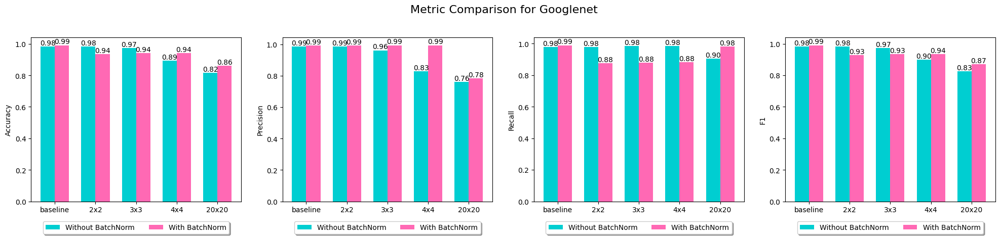

In [ ]:
permutation_types = ['baseline', '2x2', '3x3', '4x4', '20x20']
metrics = ['accuracy', 'precision', 'recall', 'f1']

# Without BatchNorm
accuracy = [accuracy_baseline_googlenet, accuracy_2x2_googlenet, accuracy_3x3_googlenet, accuracy_4x4_googlenet, accuracy_20x20_googlenet]
precision = [precision_baseline_googlenet, precision_2x2_googlenet, precision_3x3_googlenet, precision_4x4_googlenet, precision_20x20_googlenet]
recall = [recall_baseline_googlenet, recall_2x2_googlenet, recall_3x3_googlenet, recall_4x4_googlenet, recall_20x20_googlenet]
f1 = [f1_baseline_googlenet,f1_2x2_googlenet,f1_3x3_googlenet,f1_4x4_googlenet, f1_20x20_googlenet]

# With BatchNorm
accuracy_batchnorm = [accuracy_baseline_googlenet_batchnorm,accuracy_2x2_googlenet_batchnorm,accuracy_3x3_googlenet_batchnorm,accuracy_4x4_googlenet_batchnorm,accuracy_20x20_googlenet_batchnorm]
precision_batchnorm = [precision_baseline_googlenet_batchnorm, precision_2x2_googlenet_batchnorm, precision_3x3_googlenet_batchnorm,precision_4x4_googlenet_batchnorm,precision_20x20_googlenet_batchnorm]
recall_batchnorm = [recall_baseline_googlenet_batchnorm,recall_2x2_googlenet_batchnorm,recall_3x3_googlenet_batchnorm,recall_4x4_googlenet_batchnorm,recall_20x20_googlenet_batchnorm]
f1_batchnorm = [f1_baseline_googlenet_batchnorm,f1_2x2_googlenet_batchnorm,f1_3x3_googlenet_batchnorm,f1_4x4_googlenet_batchnorm,f1_20x20_googlenet_batchnorm]

plot_metric_comparison("Googlenet" , permutation_types, metrics, accuracy, accuracy_batchnorm, precision, precision_batchnorm, recall, recall_batchnorm, f1, f1_batchnorm)


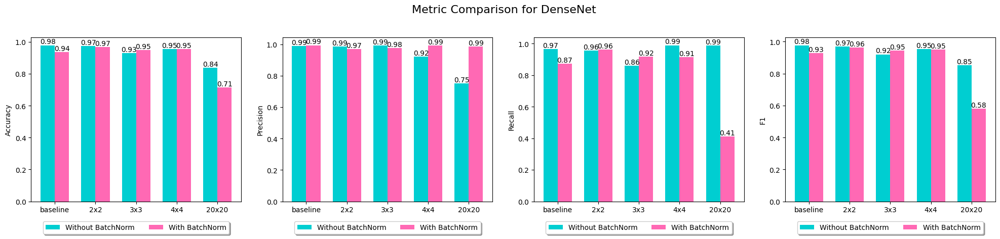

In [ ]:
# Without BatchNorm
accuracy = [accuracy_baseline_densenet, accuracy_2x2_densenet121, accuracy_3x3_densenet121, accuracy_4x4_densenet121, accuracy_20x20_densenet121]
precision = [precision_baseline_densenet, precision_2x2_densenet121, precision_3x3_densenet121, precision_4x4_densenet121, precision_20x20_densenet121]
recall = [recall_baseline_densenet, recall_2x2_densenet121, recall_3x3_densenet121, recall_4x4_densenet121, recall_20x20_densenet121]
f1 = [f1_baseline_densenet, f1_2x2_densenet121, f1_3x3_densenet121, f1_4x4_densenet121, f1_20x20_densenet121]

# With BatchNorm
accuracy_batchnorm = [accuracy_baseline_densenet_batchnorm, accuracy_2x2_densenet_batchnorm, accuracy_3x3_densenet_batchnorm, accuracy_4x4_densenet_batchnorm, accuracy_20x20_densenet_batchnorm]
precision_batchnorm = [precision_baseline_densenet_batchnorm, precision_2x2_densenet_batchnorm, precision_3x3_densenet_batchnorm, precision_4x4_densenet_batchnorm, precision_20x20_densenet_batchnorm]
recall_batchnorm = [recall_baseline_densenet_batchnorm, recall_2x2_densenet_batchnorm, recall_3x3_densenet_batchnorm, recall_4x4_densenet_batchnorm, recall_20x20_densenet_batchnorm]
f1_batchnorm = [f1_baseline_densenet_batchnorm, f1_2x2_densenet_batchnorm, f1_3x3_densenet_batchnorm, f1_4x4_densenet_batchnorm, f1_20x20_densenet_batchnorm]

plot_metric_comparison("DenseNet" , permutation_types, metrics, accuracy, accuracy_batchnorm, precision, precision_batchnorm, recall, recall_batchnorm, f1, f1_batchnorm)

## **Epoch Exploration-**

In [ ]:
def plot_metrics_vs_epochs(results_num_epochs, permutation_type):
    # Extract F1 scores and Accuracy from results dictionary
    f1_scores = [results_num_epochs[num_epochs]['f1'] for num_epochs in range(1, 7)]
    accuracies = [results_num_epochs[num_epochs]['accuracy'] for num_epochs in range(1, 7)]

    # Plotting
    plt.figure(figsize=(10, 6))

    # Plot F1 scores
    plt.bar(range(1, 7), f1_scores, color='#00CED1', alpha=0.5, label='F1 Score')

    # Plot Accuracy
    plt.plot(range(1, 7), accuracies, color='#FF69B4', marker='o', label='Accuracy')

    # Adding labels and title
    plt.xlabel('Number of Epochs')
    plt.ylabel('Score')
    plt.title(f'F1 Score and Accuracy vs. Number of Epochs for {permutation_type}')
    plt.legend()

    plt.show()

### **Baseline**
#### **GoogleNet**

In [ ]:
results_googlenet_num_epochs = {}

for num_epochs in range(1, 7):
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    print(f"Training for {num_epochs} epochs...")
    train_model(googlenet, train_loader, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader)

    results_googlenet_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 1 epochs...
Epoch 1/1, Iteration 1, Train Loss: 0.7142
Epoch 1/1, Iteration 100, Train Loss: 0.3805
Epoch 1/1, Iteration 200, Train Loss: 0.0162
Training completed.
Final Training Accuracy: 0.9440

Test Set Evaluation Metrics:
Accuracy: 0.915
Precision: 0.8530066815144766
Recall: 0.9948051948051948
F1 Score: 0.9184652278177458
Confusion Matrix:
[[349  66]
 [  2 383]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8153
Epoch 1/2, Iteration 100, Train Loss: 0.0437
Epoch 1/2, Iteration 200, Train Loss: 0.0498
Epoch 2/2, Iteration 1, Train Loss: 0.0057
Epoch 2/2, Iteration 100, Train Loss: 0.0836
Epoch 2/2, Iteration 200, Train Loss: 0.0511
Training completed.
Final Training Accuracy: 0.9634

Test Set Evaluation Metrics:
Accuracy: 0.98125
Precision: 0.9868421052631579
Recall: 0.974025974025974
F1 Score: 0.9803921568627451
Confusion Matrix:
[[410   5]
 [ 10 375]]
Training for 2 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 3 epochs...
Epoch 1/3, Iteration 1, Train Loss: 0.6473
Epoch 1/3, Iteration 100, Train Loss: 0.0132
Epoch 1/3, Iteration 200, Train Loss: 0.0177
Epoch 2/3, Iteration 1, Train Loss: 0.0298
Epoch 2/3, Iteration 100, Train Loss: 0.0376
Epoch 2/3, Iteration 200, Train Loss: 0.0058
Epoch 3/3, Iteration 1, Train Loss: 0.0549
Epoch 3/3, Iteration 100, Train Loss: 0.2311
Epoch 3/3, Iteration 200, Train Loss: 0.0073
Training completed.
Final Training Accuracy: 0.9696

Test Set Evaluation Metrics:
Accuracy: 0.9775
Precision: 0.9622166246851386
Recall: 0.9922077922077922
F1 Score: 0.9769820971867007
Confusion Matrix:
[[400  15]
 [  3 382]]
Training for 3 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 4 epochs...
Epoch 1/4, Iteration 1, Train Loss: 0.7232
Epoch 1/4, Iteration 100, Train Loss: 0.0738
Epoch 1/4, Iteration 200, Train Loss: 0.1178
Epoch 2/4, Iteration 1, Train Loss: 0.1614
Epoch 2/4, Iteration 100, Train Loss: 0.0248
Epoch 2/4, Iteration 200, Train Loss: 0.1099
Epoch 3/4, Iteration 1, Train Loss: 0.0201
Epoch 3/4, Iteration 100, Train Loss: 0.0100
Epoch 3/4, Iteration 200, Train Loss: 0.0116
Epoch 4/4, Iteration 1, Train Loss: 0.0009
Epoch 4/4, Iteration 100, Train Loss: 0.0306
Epoch 4/4, Iteration 200, Train Loss: 0.0061
Training completed.
Final Training Accuracy: 0.9756

Test Set Evaluation Metrics:
Accuracy: 0.95
Precision: 0.9116945107398569
Recall: 0.9922077922077922
F1 Score: 0.9502487562189055
Confusion Matrix:
[[378  37]
 [  3 382]]
Training for 4 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 5 epochs...
Epoch 1/5, Iteration 1, Train Loss: 0.7684
Epoch 1/5, Iteration 100, Train Loss: 0.1259
Epoch 1/5, Iteration 200, Train Loss: 0.1275
Epoch 2/5, Iteration 1, Train Loss: 0.0801
Epoch 2/5, Iteration 100, Train Loss: 0.0233
Epoch 2/5, Iteration 200, Train Loss: 0.0304
Epoch 3/5, Iteration 1, Train Loss: 0.0399
Epoch 3/5, Iteration 100, Train Loss: 0.0210
Epoch 3/5, Iteration 200, Train Loss: 0.0652
Epoch 4/5, Iteration 1, Train Loss: 0.0362
Epoch 4/5, Iteration 100, Train Loss: 0.0036
Epoch 4/5, Iteration 200, Train Loss: 0.0429
Epoch 5/5, Iteration 1, Train Loss: 0.0123
Epoch 5/5, Iteration 100, Train Loss: 0.0002
Epoch 5/5, Iteration 200, Train Loss: 0.0683
Training completed.
Final Training Accuracy: 0.9812

Test Set Evaluation Metrics:
Accuracy: 0.97625
Precision: 0.9740932642487047
Recall: 0.9766233766233766
F1 Score: 0.9753566796368354
Confusion Matrix:
[[405  10]
 [  9 376]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.7119
Epoch 1/6, Iteration 100, Train Loss: 0.1942
Epoch 1/6, Iteration 200, Train Loss: 0.0276
Epoch 2/6, Iteration 1, Train Loss: 0.0684
Epoch 2/6, Iteration 100, Train Loss: 0.1626
Epoch 2/6, Iteration 200, Train Loss: 0.0461
Epoch 3/6, Iteration 1, Train Loss: 0.0354
Epoch 3/6, Iteration 100, Train Loss: 0.0366
Epoch 3/6, Iteration 200, Train Loss: 0.0257
Epoch 4/6, Iteration 1, Train Loss: 0.0043
Epoch 4/6, Iteration 100, Train Loss: 0.2311
Epoch 4/6, Iteration 200, Train Loss: 0.7425
Epoch 5/6, Iteration 1, Train Loss: 0.0569
Epoch 5/6, Iteration 100, Train Loss: 0.0042
Epoch 5/6, Iteration 200, Train Loss: 0.0103
Epoch 6/6, Iteration 1, Train Loss: 0.0171
Epoch 6/6, Iteration 100, Train Loss: 0.5719
Epoch 6/6, Iteration 200, Train Loss: 0.0017
Training completed.
Final Training Accuracy: 0.9800

Test Set Evaluation Metrics:
Accuracy: 0.985
Precision: 0.9794344473007712
Recall: 0.9896103896103896
F1 Score: 0.9844961240310078
Confusion Matrix:


In [ ]:
results_googlenet_num_epochs = {}

results_googlenet_num_epochs[1] = {'accuracy': 0.915, 'precision': 0.8530066815144766, 'recall': 0.9948051948051948, 'f1': 0.9184652278177458}
results_googlenet_num_epochs[2] = {'accuracy': 0.98125, 'precision': 0.9868421052631579, 'recall': 0.974025974025974, 'f1': 0.9803921568627451}
results_googlenet_num_epochs[3] = {'accuracy': 0.9775, 'precision': 0.9622166246851386, 'recall': 0.9922077922077922, 'f1': 0.9769820971867007}
results_googlenet_num_epochs[4] = {'accuracy': 0.95, 'precision': 0.9116945107398569, 'recall': 0.9922077922077922, 'f1': 0.9502487562189055}
results_googlenet_num_epochs[5] = {'accuracy': 0.97625, 'precision': 0.9740932642487047, 'recall': 0.9766233766233766, 'f1': 0.9753566796368354}
results_googlenet_num_epochs[6] = {'accuracy': 0.985, 'precision': 0.9794344473007712, 'recall': 0.9896103896103896, 'f1': 0.9844961240310078}

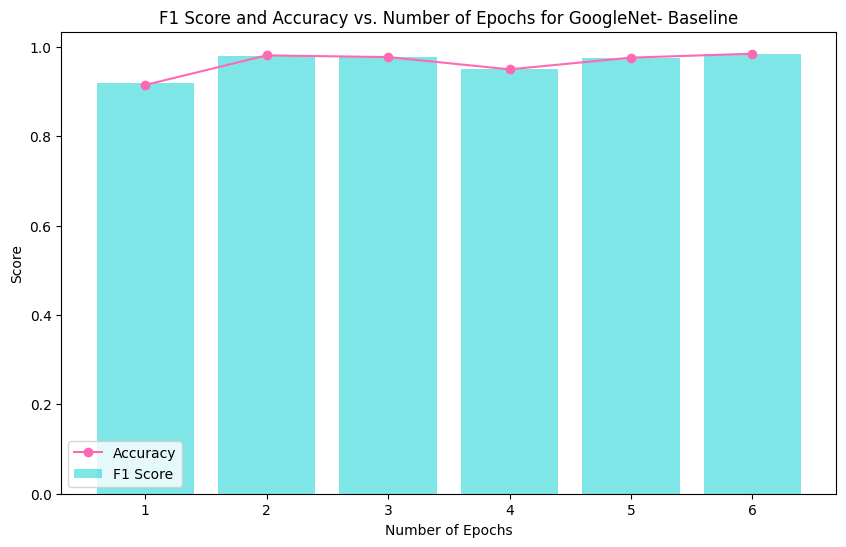

In [ ]:
plot_metrics_vs_epochs(results_googlenet_num_epochs,'GoogleNet- Baseline')

#### **DenseNet**

In [ ]:
results_densenet121_num_epochs = {}

for num_epochs in range(1, 7):
  densenet121=densenet121_model()
  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=0.001)

  print(f"Training for {num_epochs} epochs...")
  train_model(densenet121, train_loader, criterion, optimizer, num_epochs=num_epochs)

  accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(densenet121, test_loader)

  results_densenet121_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
  print(f"Training for {num_epochs} epochs completed.")
  print("")
  print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 1 epochs...
Epoch 1/1, Iteration 1, Train Loss: 0.6277
Epoch 1/1, Iteration 100, Train Loss: 0.1152
Epoch 1/1, Iteration 200, Train Loss: 0.0876
Training completed.
Final Training Accuracy: 0.9362

Test Set Evaluation Metrics:
Accuracy: 0.89125
Precision: 0.8211206896551724
Recall: 0.9896103896103896
F1 Score: 0.8975265017667844
Confusion Matrix:
[[332  83]
 [  4 381]]
Training for 1 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 2 epochs...
Epoch 1/2, Iteration 1, Train Loss: 0.6936
Epoch 1/2, Iteration 100, Train Loss: 0.0247
Epoch 1/2, Iteration 200, Train Loss: 0.2583
Epoch 2/2, Iteration 1, Train Loss: 0.1940
Epoch 2/2, Iteration 100, Train Loss: 0.0601
Epoch 2/2, Iteration 200, Train Loss: 0.0260
Training completed.
Final Training Accuracy: 0.9540

Test Set Evaluation Metrics:
Accuracy: 0.9575
Precision: 0.9443037974683545
Recall: 0.9688311688311688
F1 Score: 0.9564102564102563
Confusion Matrix:
[[393  22]
 [ 12 373]]
Training for 2 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 3 epochs...
Epoch 1/3, Iteration 1, Train Loss: 0.9452
Epoch 1/3, Iteration 100, Train Loss: 0.2935
Epoch 1/3, Iteration 200, Train Loss: 0.3745
Epoch 2/3, Iteration 1, Train Loss: 0.1224
Epoch 2/3, Iteration 100, Train Loss: 0.0217
Epoch 2/3, Iteration 200, Train Loss: 0.0612
Epoch 3/3, Iteration 1, Train Loss: 0.0588
Epoch 3/3, Iteration 100, Train Loss: 0.1213
Epoch 3/3, Iteration 200, Train Loss: 0.1187
Training completed.
Final Training Accuracy: 0.9562

Test Set Evaluation Metrics:
Accuracy: 0.95125
Precision: 0.9119047619047619
Recall: 0.9948051948051948
F1 Score: 0.9515527950310558
Confusion Matrix:
[[378  37]
 [  2 383]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.9050
Epoch 1/4, Iteration 100, Train Loss: 0.1746
Epoch 1/4, Iteration 200, Train Loss: 0.2424
Epoch 2/4, Iteration 1, Train Loss: 0.2568
Epoch 2/4, Iteration 100, Train Loss: 0.0829
Epoch 2/4, Iteration 200, Train Loss: 0.0411
Epoch 3/4, Iteration 1, Train Loss: 0.0179
Epoch 3/4, Iteration 100, Train Loss: 0.1094
Epoch 3/4, Iteration 200, Train Loss: 0.1734
Epoch 4/4, Iteration 1, Train Loss: 0.0296
Epoch 4/4, Iteration 100, Train Loss: 0.2582
Epoch 4/4, Iteration 200, Train Loss: 0.0093
Training completed.
Final Training Accuracy: 0.9731

Test Set Evaluation Metrics:
Accuracy: 0.9575
Precision: 0.9249394673123487
Recall: 0.9922077922077922
F1 Score: 0.9573934837092732
Confusion Matrix:
[[384  31]
 [  3 382]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.7038
Epoch 1/5, Iteration 100, Train Loss: 0.0820
Epoch 1/5, Iteration 200, Train Loss: 0.1095
Epoch 2/5, Iteration 1, Train Loss: 0.0879
Epoch 2/5, Iteration 100, Train Loss: 0.2127
Epoch 2/5, Iteration 200, Train Loss: 0.1985
Epoch 3/5, Iteration 1, Train Loss: 0.5916
Epoch 3/5, Iteration 100, Train Loss: 0.0152
Epoch 3/5, Iteration 200, Train Loss: 0.0130
Epoch 4/5, Iteration 1, Train Loss: 0.0289
Epoch 4/5, Iteration 100, Train Loss: 0.0628
Epoch 4/5, Iteration 200, Train Loss: 0.0308
Epoch 5/5, Iteration 1, Train Loss: 0.0009
Epoch 5/5, Iteration 100, Train Loss: 0.1571
Epoch 5/5, Iteration 200, Train Loss: 0.0143
Training completed.
Final Training Accuracy: 0.9812

Test Set Evaluation Metrics:
Accuracy: 0.99125
Precision: 0.9947643979057592
Recall: 0.987012987012987
F1 Score: 0.9908735332464146
Confusion Matrix:
[[413   2]
 [  5 380]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.7467
Epoch 1/6, Iteration 100, Train Loss: 0.1387
Epoch 1/6, Iteration 200, Train Loss: 0.1391
Epoch 2/6, Iteration 1, Train Loss: 0.0665
Epoch 2/6, Iteration 100, Train Loss: 0.0613
Epoch 2/6, Iteration 200, Train Loss: 0.0264
Epoch 3/6, Iteration 1, Train Loss: 0.3186
Epoch 3/6, Iteration 100, Train Loss: 0.0508
Epoch 3/6, Iteration 200, Train Loss: 0.0756
Epoch 4/6, Iteration 1, Train Loss: 0.0118
Epoch 4/6, Iteration 100, Train Loss: 0.0038
Epoch 4/6, Iteration 200, Train Loss: 0.1727
Epoch 5/6, Iteration 1, Train Loss: 0.0221
Epoch 5/6, Iteration 100, Train Loss: 0.1986
Epoch 5/6, Iteration 200, Train Loss: 0.0853
Epoch 6/6, Iteration 1, Train Loss: 0.0039
Epoch 6/6, Iteration 100, Train Loss: 0.0449
Epoch 6/6, Iteration 200, Train Loss: 0.0437
Training completed.
Final Training Accuracy: 0.9806

Test Set Evaluation Metrics:
Accuracy: 0.9725
Precision: 0.9548872180451128
Recall: 0.9896103896103896
F1 Score: 0.971938775510204
Confusion Matrix:


In [ ]:
results_densenet121_num_epochs = {
    1: {'accuracy': 0.89125, 'precision': 0.8211206896551724, 'recall': 0.9896103896103896, 'f1': 0.8975265017667844, 'confusion_matrix': [[332, 83], [4, 381]]},
    2: {'accuracy': 0.9575, 'precision': 0.9443037974683545, 'recall': 0.9688311688311688, 'f1': 0.9564102564102563, 'confusion_matrix': [[393, 22], [12, 373]]},
    3: {'accuracy': 0.95125, 'precision': 0.9119047619047619, 'recall': 0.9948051948051948, 'f1': 0.9515527950310558, 'confusion_matrix': [[378, 37], [2, 383]]},
    4: {'accuracy': 0.9575, 'precision': 0.9249394673123487, 'recall': 0.9922077922077922, 'f1': 0.9573934837092732, 'confusion_matrix': [[384, 31], [3, 382]]},
    5: {'accuracy': 0.99125, 'precision': 0.9947643979057592, 'recall': 0.987012987012987, 'f1': 0.9908735332464146, 'confusion_matrix': [[413, 2], [5, 380]]},
    6: {'accuracy': 0.9725, 'precision': 0.9548872180451128, 'recall': 0.9896103896103896, 'f1': 0.971938775510204, 'confusion_matrix': [[397, 18], [4, 381]]}
}

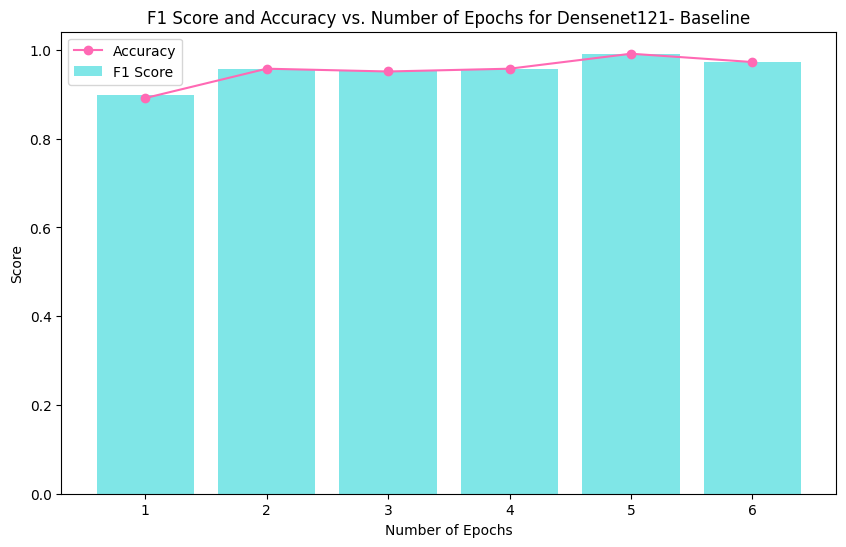

In [ ]:
plot_metrics_vs_epochs(results_densenet121_num_epochs,'Densenet121- Baseline')

### **2-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_2x2_num_epochs = {}

for num_epochs in range(1, 7):
    # Choose a loss function and optimizer

    print(f"Training for {num_epochs} epochs...")
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_model(googlenet, train_loader_2x2, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_2x2)

    results_googlenet_2x2_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.6724
Epoch 1/1, Iteration 100, Train Loss: 0.2083
Epoch 1/1, Iteration 200, Train Loss: 0.1604
Training completed.
Final Training Accuracy: 0.9368

Test Set Evaluation Metrics:
Accuracy: 0.97375
Precision: 0.9595959595959596
Recall: 0.987012987012987
F1 Score: 0.9731113956466069
Confusion Matrix:
[[399  16]
 [  5 380]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8180
Epoch 1/2, Iteration 100, Train Loss: 0.0914
Epoch 1/2, Iteration 200, Train Loss: 0.6911
Epoch 2/2, Iteration 1, Train Loss: 0.0512
Epoch 2/2, Iteration 100, Train Loss: 0.0286
Epoch 2/2, Iteration 200, Train Loss: 0.0050
Training completed.
Final Training Accuracy: 0.9521

Test Set Evaluation Metrics:
Accuracy: 0.95875
Precision: 0.9861878453038674
Recall: 0.9272727272727272
F1 Score: 0.9558232931726907
Confusion Matrix:
[[410   5]
 [ 28 357]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6299
Epoch 1/3, Iteration 100, Train Loss: 0.3847
Epoch 1/3, Iteration 200, Train Loss: 0.0854
Epoch 2/3, Iteration 1, Train Loss: 0.0644
Epoch 2/3, Iteration 100, Train Loss: 0.0511
Epoch 2/3, Iteration 200, Train Loss: 0.1163
Epoch 3/3, Iteration 1, Train Loss: 0.0279
Epoch 3/3, Iteration 100, Train Loss: 0.0440
Epoch 3/3, Iteration 200, Train Loss: 0.1692
Training completed.
Final Training Accuracy: 0.9612

Test Set Evaluation Metrics:
Accuracy: 0.97875
Precision: 1.0
Recall: 0.9558441558441558
F1 Score: 0.9774236387782205
Confusion Matrix:
[[415   0]
 [ 17 368]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.7291
Epoch 1/4, Iteration 100, Train Loss: 0.3891
Epoch 1/4, Iteration 200, Train Loss: 0.0598
Epoch 2/4, Iteration 1, Train Loss: 0.0369
Epoch 2/4, Iteration 100, Train Loss: 0.1177
Epoch 2/4, Iteration 200, Train Loss: 0.0202
Epoch 3/4, Iteration 1, Train Loss: 0.0249
Epoch 3/4, Iteration 100, Train Loss: 0.0194
Epoch 3/4, Iteration 200, Train Loss: 0.0359
Epoch 4/4, Iteration 1, Train Loss: 0.0089
Epoch 4/4, Iteration 100, Train Loss: 0.1025
Epoch 4/4, Iteration 200, Train Loss: 0.0121
Training completed.
Final Training Accuracy: 0.9737

Test Set Evaluation Metrics:
Accuracy: 0.9575
Precision: 0.9290953545232273
Recall: 0.987012987012987
F1 Score: 0.9571788413098236
Confusion Matrix:
[[386  29]
 [  5 380]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.7559
Epoch 1/5, Iteration 100, Train Loss: 0.1178
Epoch 1/5, Iteration 200, Train Loss: 0.0235
Epoch 2/5, Iteration 1, Train Loss: 0.0815
Epoch 2/5, Iteration 100, Train Loss: 0.0599
Epoch 2/5, Iteration 200, Train Loss: 0.1474
Epoch 3/5, Iteration 1, Train Loss: 0.0204
Epoch 3/5, Iteration 100, Train Loss: 0.0336
Epoch 3/5, Iteration 200, Train Loss: 0.0995
Epoch 4/5, Iteration 1, Train Loss: 0.2199
Epoch 4/5, Iteration 100, Train Loss: 0.1083
Epoch 4/5, Iteration 200, Train Loss: 0.0964
Epoch 5/5, Iteration 1, Train Loss: 0.2263
Epoch 5/5, Iteration 100, Train Loss: 0.2306
Epoch 5/5, Iteration 200, Train Loss: 0.0542
Training completed.
Final Training Accuracy: 0.9768

Test Set Evaluation Metrics:
Accuracy: 0.9675
Precision: 0.959079283887468
Recall: 0.974025974025974
F1 Score: 0.9664948453608248
Confusion Matrix:
[[399  16]
 [ 10 375]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.6129
Epoch 1/6, Iteration 100, Train Loss: 0.1209
Epoch 1/6, Iteration 200, Train Loss: 0.2029
Epoch 2/6, Iteration 1, Train Loss: 0.1392
Epoch 2/6, Iteration 100, Train Loss: 0.1632
Epoch 2/6, Iteration 200, Train Loss: 0.1027
Epoch 3/6, Iteration 1, Train Loss: 0.0438
Epoch 3/6, Iteration 100, Train Loss: 0.0525
Epoch 3/6, Iteration 200, Train Loss: 0.0455
Epoch 4/6, Iteration 1, Train Loss: 0.0772
Epoch 4/6, Iteration 100, Train Loss: 0.0280
Epoch 4/6, Iteration 200, Train Loss: 0.0417
Epoch 5/6, Iteration 1, Train Loss: 0.0917
Epoch 5/6, Iteration 100, Train Loss: 0.0009
Epoch 5/6, Iteration 200, Train Loss: 0.0074
Epoch 6/6, Iteration 1, Train Loss: 0.0094
Epoch 6/6, Iteration 100, Train Loss: 0.1213
Epoch 6/6, Iteration 200, Train Loss: 0.1097
Training completed.
Final Training Accuracy: 0.9765

Test Set Evaluation Metrics:
Accuracy: 0.985
Precision: 0.9844155844155844
Recall: 0.9844155844155844
F1 Score: 0.9844155844155844
Confusion Matrix:


In [ ]:
results_googlenet_2x2_num_epochs = {
    1: {'accuracy': 0.97375, 'precision': 0.9595959595959596, 'recall': 0.987012987012987, 'f1': 0.9731113956466069, 'confusion_matrix': [[399, 16], [5, 380]]},
    2: {'accuracy': 0.95875, 'precision': 0.9861878453038674, 'recall': 0.9272727272727272, 'f1': 0.9558232931726907, 'confusion_matrix': [[410, 5], [28, 357]]},
    3: {'accuracy': 0.97875, 'precision': 1.0, 'recall': 0.9558441558441558, 'f1': 0.9774236387782205, 'confusion_matrix': [[415, 0], [17, 368]]},
    4: {'accuracy': 0.9575, 'precision': 0.9290953545232273, 'recall': 0.987012987012987, 'f1': 0.9571788413098236, 'confusion_matrix': [[386, 29], [5, 380]]},
    5: {'accuracy': 0.9675, 'precision': 0.959079283887468, 'recall': 0.974025974025974, 'f1': 0.9664948453608248, 'confusion_matrix': [[399, 16], [10, 375]]},
    6: {'accuracy': 0.985, 'precision': 0.9844155844155844, 'recall': 0.9844155844155844, 'f1': 0.9844155844155844, 'confusion_matrix': [[409, 6], [6, 379]]}
}


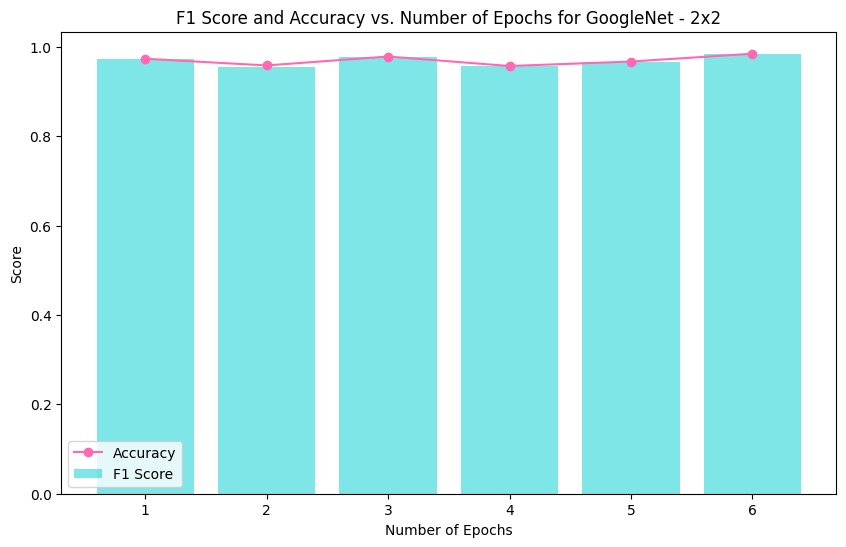

In [ ]:
plot_metrics_vs_epochs(results_googlenet_2x2_num_epochs,'GoogleNet - 2x2')

#### **DenseNet**

In [ ]:
results_densenet121_2x2_num_epochs = {}

for num_epochs in range(1, 7):
    densenet121=densenet121_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(densenet121.parameters(), lr=0.001)

    print(f"Training for {num_epochs} epochs...")
    # Train the model
    train_model(densenet121, train_loader_2x2, criterion, optimizer, num_epochs=num_epochs)

    # Test the model
    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(densenet121, test_loader_2x2)

    # Store results in the dictionary
    results_densenet121_2x2_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...
Epoch 1/1, Iteration 1, Train Loss: 0.5984
Epoch 1/1, Iteration 100, Train Loss: 0.2757
Epoch 1/1, Iteration 200, Train Loss: 0.3620
Training completed.
Final Training Accuracy: 0.9362

Test Set Evaluation Metrics:
Accuracy: 0.90625
Precision: 0.984375
Recall: 0.8181818181818182
F1 Score: 0.8936170212765957
Confusion Matrix:
[[410   5]
 [ 70 315]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7401
Epoch 1/2, Iteration 100, Train Loss: 0.2627
Epoch 1/2, Iteration 200, Train Loss: 0.1701
Epoch 2/2, Iteration 1, Train Loss: 0.1808
Epoch 2/2, Iteration 100, Train Loss: 0.1950
Epoch 2/2, Iteration 200, Train Loss: 0.0274
Training completed.
Final Training Accuracy: 0.9487

Test Set Evaluation Metrics:
Accuracy: 0.925
Precision: 0.8701594533029613
Recall: 0.9922077922077922
F1 Score: 0.9271844660194175
Confusion Matrix:
[[358  57]
 [  3 382]]
Training for 2 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 3 epochs...
Epoch 1/3, Iteration 1, Train Loss: 0.7716
Epoch 1/3, Iteration 100, Train Loss: 0.2969
Epoch 1/3, Iteration 200, Train Loss: 0.4759
Epoch 2/3, Iteration 1, Train Loss: 0.2151
Epoch 2/3, Iteration 100, Train Loss: 0.2012
Epoch 2/3, Iteration 200, Train Loss: 0.0811
Epoch 3/3, Iteration 1, Train Loss: 0.2975
Epoch 3/3, Iteration 100, Train Loss: 0.1949
Epoch 3/3, Iteration 200, Train Loss: 0.0219
Training completed.
Final Training Accuracy: 0.9565

Test Set Evaluation Metrics:
Accuracy: 0.9825
Precision: 0.9868766404199475
Recall: 0.9766233766233766
F1 Score: 0.9817232375979112
Confusion Matrix:
[[410   5]
 [  9 376]]
Training for 3 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 4 epochs...
Epoch 1/4, Iteration 1, Train Loss: 0.5632
Epoch 1/4, Iteration 100, Train Loss: 0.0254
Epoch 1/4, Iteration 200, Train Loss: 0.0769
Epoch 2/4, Iteration 1, Train Loss: 0.0670
Epoch 2/4, Iteration 100, Train Loss: 0.1036
Epoch 2/4, Iteration 200, Train Loss: 0.5739
Epoch 3/4, Iteration 1, Train Loss: 0.0749
Epoch 3/4, Iteration 100, Train Loss: 0.0151
Epoch 3/4, Iteration 200, Train Loss: 0.0344
Epoch 4/4, Iteration 1, Train Loss: 0.0855
Epoch 4/4, Iteration 100, Train Loss: 0.0474
Epoch 4/4, Iteration 200, Train Loss: 0.0536
Training completed.
Final Training Accuracy: 0.9718

Test Set Evaluation Metrics:
Accuracy: 0.95375
Precision: 0.9202898550724637
Recall: 0.9896103896103896
F1 Score: 0.9536921151439298
Confusion Matrix:
[[382  33]
 [  4 381]]
Training for 4 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 5 epochs...
Epoch 1/5, Iteration 1, Train Loss: 0.7199
Epoch 1/5, Iteration 100, Train Loss: 0.3108
Epoch 1/5, Iteration 200, Train Loss: 0.2489
Epoch 2/5, Iteration 1, Train Loss: 0.0969
Epoch 2/5, Iteration 100, Train Loss: 0.1797
Epoch 2/5, Iteration 200, Train Loss: 0.0151
Epoch 3/5, Iteration 1, Train Loss: 0.1212
Epoch 3/5, Iteration 100, Train Loss: 0.0810
Epoch 3/5, Iteration 200, Train Loss: 0.0298
Epoch 4/5, Iteration 1, Train Loss: 0.0184
Epoch 4/5, Iteration 100, Train Loss: 0.1384
Epoch 4/5, Iteration 200, Train Loss: 0.0380
Epoch 5/5, Iteration 1, Train Loss: 0.1133
Epoch 5/5, Iteration 100, Train Loss: 0.1038
Epoch 5/5, Iteration 200, Train Loss: 0.0463
Training completed.
Final Training Accuracy: 0.9709

Test Set Evaluation Metrics:
Accuracy: 0.97375
Precision: 0.9619289340101523
Recall: 0.9844155844155844
F1 Score: 0.9730423620025674
Confusion Matrix:
[[400  15]
 [  6 379]]
Training for 5 epochs completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 6 epochs...
Epoch 1/6, Iteration 1, Train Loss: 0.6839
Epoch 1/6, Iteration 100, Train Loss: 0.1213
Epoch 1/6, Iteration 200, Train Loss: 0.0554
Epoch 2/6, Iteration 1, Train Loss: 0.1061
Epoch 2/6, Iteration 100, Train Loss: 0.0176
Epoch 2/6, Iteration 200, Train Loss: 0.0832
Epoch 3/6, Iteration 1, Train Loss: 0.2147
Epoch 3/6, Iteration 100, Train Loss: 0.2153
Epoch 3/6, Iteration 200, Train Loss: 0.1403
Epoch 4/6, Iteration 1, Train Loss: 0.1082
Epoch 4/6, Iteration 100, Train Loss: 0.0094
Epoch 4/6, Iteration 200, Train Loss: 0.0341
Epoch 5/6, Iteration 1, Train Loss: 0.0473
Epoch 5/6, Iteration 100, Train Loss: 0.0043
Epoch 5/6, Iteration 200, Train Loss: 0.0363
Epoch 6/6, Iteration 1, Train Loss: 0.1748
Epoch 6/6, Iteration 100, Train Loss: 0.0280
Epoch 6/6, Iteration 200, Train Loss: 0.1024
Training completed.
Final Training Accuracy: 0.9603

Test Set Evaluation Metrics:
Accuracy: 0.975
Precision: 0.9765013054830287
Recall: 0.9714285714285714
F1 Score: 0.9739583333

In [ ]:
results_densenet121_2x2_num_epochs = {
    1: {'accuracy': 0.90625, 'precision': 0.984375, 'recall': 0.8181818181818182, 'f1': 0.8936170212765957, 'confusion_matrix': [[410, 5], [70, 315]]},
    2: {'accuracy': 0.925, 'precision': 0.8701594533029613, 'recall': 0.9922077922077922, 'f1': 0.9271844660194175, 'confusion_matrix': [[358, 57], [3, 382]]},
    3: {'accuracy': 0.9825, 'precision': 0.9868766404199475, 'recall': 0.9766233766233766, 'f1': 0.9817232375979112, 'confusion_matrix': [[410, 5], [9, 376]]},
    4: {'accuracy': 0.95375, 'precision': 0.9202898550724637, 'recall': 0.9896103896103896, 'f1': 0.9536921151439298, 'confusion_matrix': [[382, 33], [4, 381]]},
    5: {'accuracy': 0.97375, 'precision': 0.9619289340101523, 'recall': 0.9844155844155844, 'f1': 0.9730423620025674, 'confusion_matrix': [[400, 15], [6, 379]]},
    6: {'accuracy': 0.975, 'precision': 0.9765013054830287, 'recall': 0.9714285714285714, 'f1': 0.9739583333333335, 'confusion_matrix': [[406, 9], [11, 374]]}
}

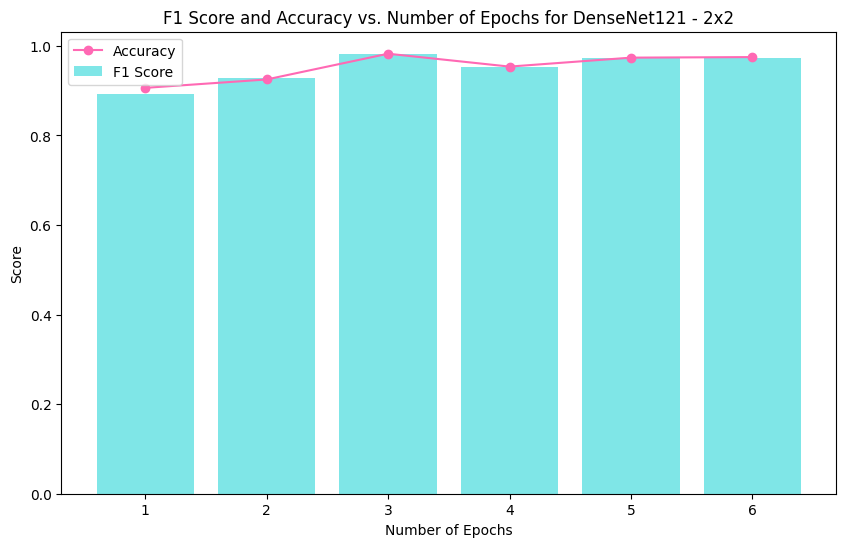

In [ ]:
plot_metrics_vs_epochs(results_densenet121_2x2_num_epochs,'DenseNet121 - 2x2')

### **3-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_3x3_num_epochs = {}

for num_epochs in range(1, 7):
    print(f"Training for {num_epochs} epochs...")
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_model(googlenet, train_loader_3x3, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_3x3)

    results_googlenet_3x3_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.7299
Epoch 1/1, Iteration 100, Train Loss: 0.2662
Epoch 1/1, Iteration 200, Train Loss: 0.1217
Training completed.
Final Training Accuracy: 0.9224

Test Set Evaluation Metrics:
Accuracy: 0.955
Precision: 0.9266503667481663
Recall: 0.9844155844155844
F1 Score: 0.9546599496221663
Confusion Matrix:
[[385  30]
 [  6 379]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6902
Epoch 1/2, Iteration 100, Train Loss: 0.1942
Epoch 1/2, Iteration 200, Train Loss: 0.0776
Epoch 2/2, Iteration 1, Train Loss: 0.0102
Epoch 2/2, Iteration 100, Train Loss: 0.2391
Epoch 2/2, Iteration 200, Train Loss: 0.1454
Training completed.
Final Training Accuracy: 0.9402

Test Set Evaluation Metrics:
Accuracy: 0.97125
Precision: 0.9641025641025641
Recall: 0.9766233766233766
F1 Score: 0.9703225806451613
Confusion Matrix:
[[401  14]
 [  9 376]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7654
Epoch 1/3, Iteration 100, Train Loss: 0.0352
Epoch 1/3, Iteration 200, Train Loss: 0.1237
Epoch 2/3, Iteration 1, Train Loss: 0.0332
Epoch 2/3, Iteration 100, Train Loss: 0.3753
Epoch 2/3, Iteration 200, Train Loss: 0.1029
Epoch 3/3, Iteration 1, Train Loss: 0.0358
Epoch 3/3, Iteration 100, Train Loss: 0.0713
Epoch 3/3, Iteration 200, Train Loss: 0.1379
Training completed.
Final Training Accuracy: 0.9671

Test Set Evaluation Metrics:
Accuracy: 0.93875
Precision: 0.9912280701754386
Recall: 0.8805194805194805
F1 Score: 0.9325997248968363
Confusion Matrix:
[[412   3]
 [ 46 339]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.7308
Epoch 1/4, Iteration 100, Train Loss: 0.0327
Epoch 1/4, Iteration 200, Train Loss: 0.2492
Epoch 2/4, Iteration 1, Train Loss: 0.0096
Epoch 2/4, Iteration 100, Train Loss: 0.0333
Epoch 2/4, Iteration 200, Train Loss: 0.2497
Epoch 3/4, Iteration 1, Train Loss: 0.2958
Epoch 3/4, Iteration 100, Train Loss: 0.0499
Epoch 3/4, Iteration 200, Train Loss: 0.3674
Epoch 4/4, Iteration 1, Train Loss: 0.0702
Epoch 4/4, Iteration 100, Train Loss: 0.0985
Epoch 4/4, Iteration 200, Train Loss: 0.0360
Training completed.
Final Training Accuracy: 0.9634

Test Set Evaluation Metrics:
Accuracy: 0.93125
Precision: 0.880184331797235
Recall: 0.9922077922077922
F1 Score: 0.9328449328449329
Confusion Matrix:
[[363  52]
 [  3 382]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.6483
Epoch 1/5, Iteration 100, Train Loss: 0.3986
Epoch 1/5, Iteration 200, Train Loss: 0.1026
Epoch 2/5, Iteration 1, Train Loss: 0.0757
Epoch 2/5, Iteration 100, Train Loss: 0.0968
Epoch 2/5, Iteration 200, Train Loss: 0.0552
Epoch 3/5, Iteration 1, Train Loss: 0.0939
Epoch 3/5, Iteration 100, Train Loss: 0.0073
Epoch 3/5, Iteration 200, Train Loss: 0.1739
Epoch 4/5, Iteration 1, Train Loss: 0.3136
Epoch 4/5, Iteration 100, Train Loss: 0.0379
Epoch 4/5, Iteration 200, Train Loss: 0.0083
Epoch 5/5, Iteration 1, Train Loss: 0.0210
Epoch 5/5, Iteration 100, Train Loss: 0.0938
Epoch 5/5, Iteration 200, Train Loss: 0.1542
Training completed.
Final Training Accuracy: 0.9678

Test Set Evaluation Metrics:
Accuracy: 0.905
Precision: 0.8410596026490066
Recall: 0.9896103896103896
F1 Score: 0.9093078758949881
Confusion Matrix:
[[343  72]
 [  4 381]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.6988
Epoch 1/6, Iteration 100, Train Loss: 0.1931
Epoch 1/6, Iteration 200, Train Loss: 0.3493
Epoch 2/6, Iteration 1, Train Loss: 0.1512
Epoch 2/6, Iteration 100, Train Loss: 0.0199
Epoch 2/6, Iteration 200, Train Loss: 0.1699
Epoch 3/6, Iteration 1, Train Loss: 0.0801
Epoch 3/6, Iteration 100, Train Loss: 0.0256
Epoch 3/6, Iteration 200, Train Loss: 0.2354
Epoch 4/6, Iteration 1, Train Loss: 0.0104
Epoch 4/6, Iteration 100, Train Loss: 0.1308
Epoch 4/6, Iteration 200, Train Loss: 0.0102
Epoch 5/6, Iteration 1, Train Loss: 0.0587
Epoch 5/6, Iteration 100, Train Loss: 0.0711
Epoch 5/6, Iteration 200, Train Loss: 0.0433
Epoch 6/6, Iteration 1, Train Loss: 0.0055
Epoch 6/6, Iteration 100, Train Loss: 0.0182
Epoch 6/6, Iteration 200, Train Loss: 0.0011
Training completed.
Final Training Accuracy: 0.9834

Test Set Evaluation Metrics:
Accuracy: 0.915
Precision: 0.8561797752808988
Recall: 0.9896103896103896
F1 Score: 0.9180722891566264
Confusion Matrix:


In [ ]:
results_googlenet_3x3_num_epochs = {
    1: {'accuracy': 0.955, 'precision': 0.9266503667481663, 'recall': 0.9844155844155844, 'f1': 0.9546599496221663, 'confusion_matrix': [[385, 30], [6, 379]]},
    2: {'accuracy': 0.97125, 'precision': 0.9641025641025641, 'recall': 0.9766233766233766, 'f1': 0.9703225806451613, 'confusion_matrix': [[401, 14], [9, 376]]},
    3: {'accuracy': 0.93875, 'precision': 0.9912280701754386, 'recall': 0.8805194805194805, 'f1': 0.9325997248968363, 'confusion_matrix': [[412, 3], [46, 339]]},
    4: {'accuracy': 0.93125, 'precision': 0.880184331797235, 'recall': 0.9922077922077922, 'f1': 0.9328449328449329, 'confusion_matrix': [[363, 52], [3, 382]]},
    5: {'accuracy': 0.905, 'precision': 0.8410596026490066, 'recall': 0.9896103896103896, 'f1': 0.9093078758949881, 'confusion_matrix': [[343, 72], [4, 381]]},
    6: {'accuracy': 0.915, 'precision': 0.8561797752808988, 'recall': 0.9896103896103896, 'f1': 0.9180722891566264, 'confusion_matrix': [[351, 64], [4, 381]]}
}


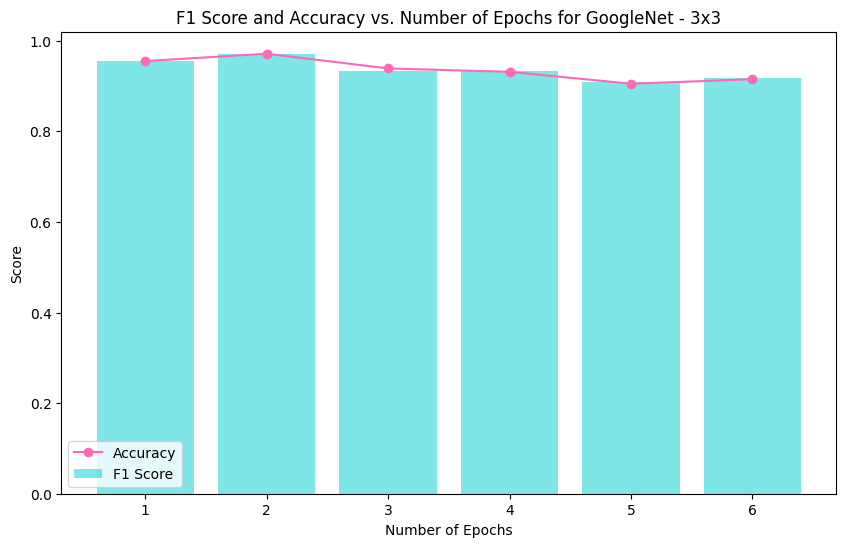

In [ ]:
plot_metrics_vs_epochs(results_googlenet_3x3_num_epochs,'GoogleNet - 3x3')

#### **DenseNet**

In [ ]:
results_densenet121_3x3_num_epochs = {}

for num_epochs in range(1, 7):
    print(f"Training for {num_epochs} epochs...")
    densenet121=densenet121_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(densenet121.parameters(), lr=0.001)

    train_model(densenet121, train_loader_3x3, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(densenet121, test_loader_3x3)

    results_densenet121_3x3_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.6988
Epoch 1/1, Iteration 100, Train Loss: 0.1095
Epoch 1/1, Iteration 200, Train Loss: 0.6312
Training completed.
Final Training Accuracy: 0.9039

Test Set Evaluation Metrics:
Accuracy: 0.91875
Precision: 0.9145077720207254
Recall: 0.9168831168831169
F1 Score: 0.9156939040207521
Confusion Matrix:
[[382  33]
 [ 32 353]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6246
Epoch 1/2, Iteration 100, Train Loss: 0.0802
Epoch 1/2, Iteration 200, Train Loss: 0.0098
Epoch 2/2, Iteration 1, Train Loss: 0.1499
Epoch 2/2, Iteration 100, Train Loss: 0.2210
Epoch 2/2, Iteration 200, Train Loss: 0.5825
Training completed.
Final Training Accuracy: 0.9393

Test Set Evaluation Metrics:
Accuracy: 0.75125
Precision: 0.6592465753424658
Recall: 1.0
F1 Score: 0.7946336429308566
Confusion Matrix:
[[216 199]
 [  0 385]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7602
Epoch 1/3, Iteration 100, Train Loss: 0.5039
Epoch 1/3, Iteration 200, Train Loss: 0.3406
Epoch 2/3, Iteration 1, Train Loss: 0.1444
Epoch 2/3, Iteration 100, Train Loss: 0.1219
Epoch 2/3, Iteration 200, Train Loss: 0.0611
Epoch 3/3, Iteration 1, Train Loss: 0.0581
Epoch 3/3, Iteration 100, Train Loss: 0.1011
Epoch 3/3, Iteration 200, Train Loss: 0.0968
Training completed.
Final Training Accuracy: 0.9249

Test Set Evaluation Metrics:
Accuracy: 0.9125
Precision: 0.9565217391304348
Recall: 0.8571428571428571
F1 Score: 0.904109589041096
Confusion Matrix:
[[400  15]
 [ 55 330]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.6536
Epoch 1/4, Iteration 100, Train Loss: 0.2514
Epoch 1/4, Iteration 200, Train Loss: 0.0379
Epoch 2/4, Iteration 1, Train Loss: 0.2742
Epoch 2/4, Iteration 100, Train Loss: 0.0678
Epoch 2/4, Iteration 200, Train Loss: 0.0873
Epoch 3/4, Iteration 1, Train Loss: 0.0871
Epoch 3/4, Iteration 100, Train Loss: 0.1674
Epoch 3/4, Iteration 200, Train Loss: 0.0042
Epoch 4/4, Iteration 1, Train Loss: 0.0336
Epoch 4/4, Iteration 100, Train Loss: 0.0782
Epoch 4/4, Iteration 200, Train Loss: 0.1055
Training completed.
Final Training Accuracy: 0.9571

Test Set Evaluation Metrics:
Accuracy: 0.94375
Precision: 0.9009433962264151
Recall: 0.9922077922077922
F1 Score: 0.9443757725587144
Confusion Matrix:
[[373  42]
 [  3 382]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.5515
Epoch 1/5, Iteration 100, Train Loss: 0.1003
Epoch 1/5, Iteration 200, Train Loss: 0.4434
Epoch 2/5, Iteration 1, Train Loss: 0.0851
Epoch 2/5, Iteration 100, Train Loss: 0.0323
Epoch 2/5, Iteration 200, Train Loss: 0.1412
Epoch 3/5, Iteration 1, Train Loss: 0.0990
Epoch 3/5, Iteration 100, Train Loss: 0.2572
Epoch 3/5, Iteration 200, Train Loss: 0.0459
Epoch 4/5, Iteration 1, Train Loss: 0.0235
Epoch 4/5, Iteration 100, Train Loss: 0.0807
Epoch 4/5, Iteration 200, Train Loss: 1.0802
Epoch 5/5, Iteration 1, Train Loss: 0.0221
Epoch 5/5, Iteration 100, Train Loss: 0.3416
Epoch 5/5, Iteration 200, Train Loss: 0.0082
Training completed.
Final Training Accuracy: 0.9653

Test Set Evaluation Metrics:
Accuracy: 0.95375
Precision: 0.9603174603174603
Recall: 0.9428571428571428
F1 Score: 0.9515072083879424
Confusion Matrix:
[[400  15]
 [ 22 363]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.7443
Epoch 1/6, Iteration 100, Train Loss: 0.2597
Epoch 1/6, Iteration 200, Train Loss: 0.3863
Epoch 2/6, Iteration 1, Train Loss: 0.0657
Epoch 2/6, Iteration 100, Train Loss: 0.1820
Epoch 2/6, Iteration 200, Train Loss: 0.0858
Epoch 3/6, Iteration 1, Train Loss: 0.2527
Epoch 3/6, Iteration 100, Train Loss: 0.0577
Epoch 3/6, Iteration 200, Train Loss: 0.0802
Epoch 4/6, Iteration 1, Train Loss: 0.1738
Epoch 4/6, Iteration 100, Train Loss: 0.0098
Epoch 4/6, Iteration 200, Train Loss: 0.0060
Epoch 5/6, Iteration 1, Train Loss: 0.0906
Epoch 5/6, Iteration 100, Train Loss: 0.0426
Epoch 5/6, Iteration 200, Train Loss: 0.2565
Epoch 6/6, Iteration 1, Train Loss: 0.2558
Epoch 6/6, Iteration 100, Train Loss: 0.2024
Epoch 6/6, Iteration 200, Train Loss: 0.0657
Training completed.
Final Training Accuracy: 0.9571

Test Set Evaluation Metrics:
Accuracy: 0.93625
Precision: 0.9744318181818182
Recall: 0.8909090909090909
F1 Score: 0.9308005427408413
Confusion Matrix

In [ ]:
results_densenet121_3x3_num_epochs = {
    1: {'accuracy': 0.91875, 'precision': 0.9145077720207254, 'recall': 0.9168831168831169, 'f1': 0.9156939040207521, 'confusion_matrix': [[382, 33], [32, 353]]},
    2: {'accuracy': 0.75125, 'precision': 0.6592465753424658, 'recall': 1.0, 'f1': 0.7946336429308566, 'confusion_matrix': [[216, 199], [0, 385]]},
    3: {'accuracy': 0.9125, 'precision': 0.9565217391304348, 'recall': 0.8571428571428571, 'f1': 0.904109589041096, 'confusion_matrix': [[400, 15], [55, 330]]},
    4: {'accuracy': 0.94375, 'precision': 0.9009433962264151, 'recall': 0.9922077922077922, 'f1': 0.9443757725587144, 'confusion_matrix': [[373, 42], [3, 382]]},
    5: {'accuracy': 0.95375, 'precision': 0.9603174603174603, 'recall': 0.9428571428571428, 'f1': 0.9515072083879424, 'confusion_matrix': [[400, 15], [22, 363]]},
    6: {'accuracy': 0.93625, 'precision': 0.9744318181818182, 'recall': 0.8909090909090909, 'f1': 0.9308005427408413, 'confusion_matrix': [[406, 9], [42, 343]]}
}

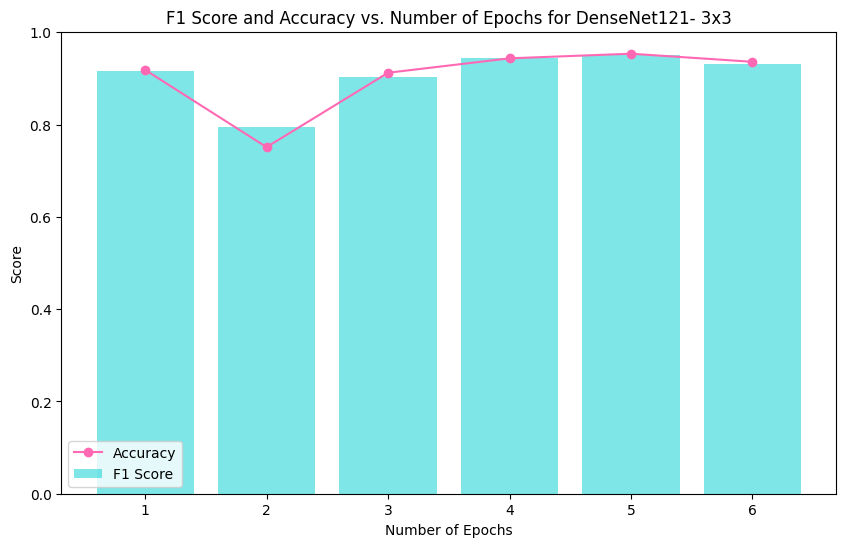

In [ ]:
plot_metrics_vs_epochs(results_densenet121_3x3_num_epochs,'DenseNet121- 3x3')

### **4-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_4x4_num_epochs = {}

for num_epochs in range(1, 7):
    print(f"Training for {num_epochs} epochs...")
    googlenet=googlenet_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_model(googlenet, train_loader_4x4, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_4x4)

    results_googlenet_4x4_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.6836
Epoch 1/1, Iteration 100, Train Loss: 0.2582
Epoch 1/1, Iteration 200, Train Loss: 0.0336
Training completed.
Final Training Accuracy: 0.9155

Test Set Evaluation Metrics:
Accuracy: 0.955
Precision: 0.9440203562340967
Recall: 0.9636363636363636
F1 Score: 0.9537275064267353
Confusion Matrix:
[[393  22]
 [ 14 371]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7296
Epoch 1/2, Iteration 100, Train Loss: 0.2664
Epoch 1/2, Iteration 200, Train Loss: 0.0194
Epoch 2/2, Iteration 1, Train Loss: 0.0234
Epoch 2/2, Iteration 100, Train Loss: 0.2923
Epoch 2/2, Iteration 200, Train Loss: 0.1406
Training completed.
Final Training Accuracy: 0.9412

Test Set Evaluation Metrics:
Accuracy: 0.95
Precision: 0.994269340974212
Recall: 0.9012987012987013
F1 Score: 0.9455040871934605
Confusion Matrix:
[[413   2]
 [ 38 347]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7374
Epoch 1/3, Iteration 100, Train Loss: 0.6101
Epoch 1/3, Iteration 200, Train Loss: 0.1667
Epoch 2/3, Iteration 1, Train Loss: 0.1002
Epoch 2/3, Iteration 100, Train Loss: 0.0486
Epoch 2/3, Iteration 200, Train Loss: 0.0952
Epoch 3/3, Iteration 1, Train Loss: 0.0102
Epoch 3/3, Iteration 100, Train Loss: 0.0811
Epoch 3/3, Iteration 200, Train Loss: 0.0555
Training completed.
Final Training Accuracy: 0.9537

Test Set Evaluation Metrics:
Accuracy: 0.975
Precision: 0.9765013054830287
Recall: 0.9714285714285714
F1 Score: 0.9739583333333335
Confusion Matrix:
[[406   9]
 [ 11 374]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.6544
Epoch 1/4, Iteration 100, Train Loss: 0.2850
Epoch 1/4, Iteration 200, Train Loss: 0.1500
Epoch 2/4, Iteration 1, Train Loss: 0.0568
Epoch 2/4, Iteration 100, Train Loss: 0.3015
Epoch 2/4, Iteration 200, Train Loss: 0.0888
Epoch 3/4, Iteration 1, Train Loss: 0.3092
Epoch 3/4, Iteration 100, Train Loss: 0.2993
Epoch 3/4, Iteration 200, Train Loss: 0.1173
Epoch 4/4, Iteration 1, Train Loss: 0.0514
Epoch 4/4, Iteration 100, Train Loss: 0.0466
Epoch 4/4, Iteration 200, Train Loss: 0.0403
Training completed.
Final Training Accuracy: 0.9681

Test Set Evaluation Metrics:
Accuracy: 0.96625
Precision: 0.9972222222222222
Recall: 0.9324675324675324
F1 Score: 0.963758389261745
Confusion Matrix:
[[414   1]
 [ 26 359]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.7331
Epoch 1/5, Iteration 100, Train Loss: 0.1435
Epoch 1/5, Iteration 200, Train Loss: 0.1322
Epoch 2/5, Iteration 1, Train Loss: 0.0502
Epoch 2/5, Iteration 100, Train Loss: 0.0402
Epoch 2/5, Iteration 200, Train Loss: 0.1950
Epoch 3/5, Iteration 1, Train Loss: 0.0742
Epoch 3/5, Iteration 100, Train Loss: 0.0137
Epoch 3/5, Iteration 200, Train Loss: 0.0130
Epoch 4/5, Iteration 1, Train Loss: 0.2079
Epoch 4/5, Iteration 100, Train Loss: 0.1509
Epoch 4/5, Iteration 200, Train Loss: 0.1216
Epoch 5/5, Iteration 1, Train Loss: 0.0722
Epoch 5/5, Iteration 100, Train Loss: 0.0029
Epoch 5/5, Iteration 200, Train Loss: 0.2372
Training completed.
Final Training Accuracy: 0.9634

Test Set Evaluation Metrics:
Accuracy: 0.97
Precision: 0.989159891598916
Recall: 0.948051948051948
F1 Score: 0.9681697612732095
Confusion Matrix:
[[411   4]
 [ 20 365]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.7810
Epoch 1/6, Iteration 100, Train Loss: 0.3886
Epoch 1/6, Iteration 200, Train Loss: 0.0534
Epoch 2/6, Iteration 1, Train Loss: 0.1317
Epoch 2/6, Iteration 100, Train Loss: 0.0877
Epoch 2/6, Iteration 200, Train Loss: 0.0760
Epoch 3/6, Iteration 1, Train Loss: 0.2980
Epoch 3/6, Iteration 100, Train Loss: 0.0171
Epoch 3/6, Iteration 200, Train Loss: 0.1245
Epoch 4/6, Iteration 1, Train Loss: 0.1080
Epoch 4/6, Iteration 100, Train Loss: 0.0121
Epoch 4/6, Iteration 200, Train Loss: 0.1180
Epoch 5/6, Iteration 1, Train Loss: 0.0355
Epoch 5/6, Iteration 100, Train Loss: 0.0618
Epoch 5/6, Iteration 200, Train Loss: 0.0479
Epoch 6/6, Iteration 1, Train Loss: 0.0047
Epoch 6/6, Iteration 100, Train Loss: 0.0018
Epoch 6/6, Iteration 200, Train Loss: 0.0028
Training completed.
Final Training Accuracy: 0.9768

Test Set Evaluation Metrics:
Accuracy: 0.9425
Precision: 0.9884726224783862
Recall: 0.8909090909090909
F1 Score: 0.9371584699453551
Confusion Matrix:

In [ ]:
results_googlenet_4x4_num_epochs = {
    1: {'accuracy': 0.955, 'precision': 0.9440203562340967, 'recall': 0.9636363636363636, 'f1': 0.9537275064267353, 'confusion_matrix': [[393, 22], [14, 371]]},
    2: {'accuracy': 0.95, 'precision': 0.994269340974212, 'recall': 0.9012987012987013, 'f1': 0.9455040871934605, 'confusion_matrix': [[413, 2], [38, 347]]},
    3: {'accuracy': 0.975, 'precision': 0.9765013054830287, 'recall': 0.9714285714285714, 'f1': 0.9739583333333335, 'confusion_matrix': [[406, 9], [11, 374]]},
    4: {'accuracy': 0.96625, 'precision': 0.9972222222222222, 'recall': 0.9324675324675324, 'f1': 0.963758389261745, 'confusion_matrix': [[414, 1], [26, 359]]},
    5: {'accuracy': 0.97, 'precision': 0.989159891598916, 'recall': 0.948051948051948, 'f1': 0.9681697612732095, 'confusion_matrix': [[411, 4], [20, 365]]},
    6: {'accuracy': 0.9425, 'precision': 0.9884726224783862, 'recall': 0.8909090909090909, 'f1': 0.9371584699453551, 'confusion_matrix': [[411, 4], [42, 343]]}
}

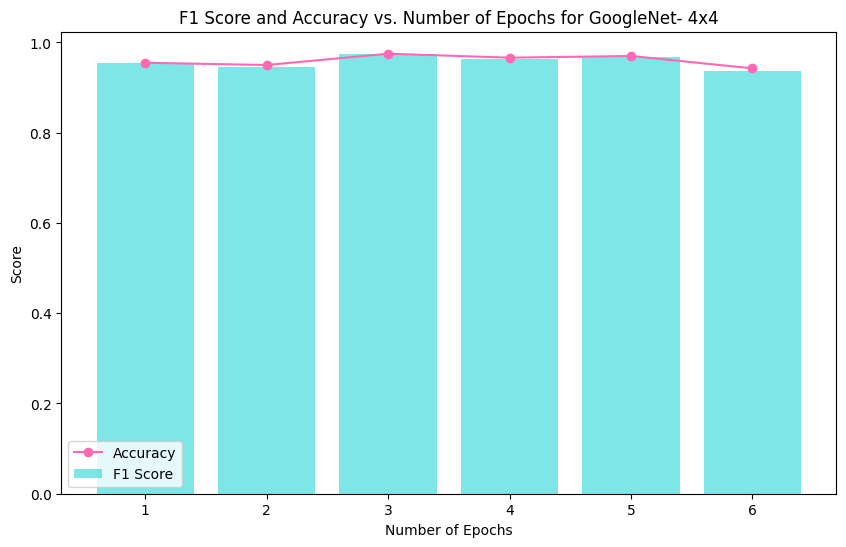

In [ ]:
plot_metrics_vs_epochs(results_googlenet_4x4_num_epochs,'GoogleNet- 4x4')

#### **DenseNet**

In [ ]:
results_densenet121_4x4_num_epochs = {}

for num_epochs in range(1, 7):
    print(f"Training for {num_epochs} epochs...")
    densenet121=densenet121_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(densenet121.parameters(), lr=0.001)

    train_model(densenet121, train_loader_4x4, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(densenet121, test_loader_4x4)

    # Store results in the dictionary
    results_densenet121_4x4_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.6789
Epoch 1/1, Iteration 100, Train Loss: 0.1449
Epoch 1/1, Iteration 200, Train Loss: 0.3244
Training completed.
Final Training Accuracy: 0.8942

Test Set Evaluation Metrics:
Accuracy: 0.5075
Precision: 0.4942233632862644
Recall: 1.0
F1 Score: 0.6615120274914089
Confusion Matrix:
[[ 21 394]
 [  0 385]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.8586
Epoch 1/2, Iteration 100, Train Loss: 0.2262
Epoch 1/2, Iteration 200, Train Loss: 0.3068
Epoch 2/2, Iteration 1, Train Loss: 0.6437
Epoch 2/2, Iteration 100, Train Loss: 0.0383
Epoch 2/2, Iteration 200, Train Loss: 0.1491
Training completed.
Final Training Accuracy: 0.9271

Test Set Evaluation Metrics:
Accuracy: 0.955
Precision: 0.9604221635883905
Recall: 0.9454545454545454
F1 Score: 0.9528795811518325
Confusion Matrix:
[[400  15]
 [ 21 364]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6800
Epoch 1/3, Iteration 100, Train Loss: 0.3423
Epoch 1/3, Iteration 200, Train Loss: 0.4528
Epoch 2/3, Iteration 1, Train Loss: 0.0800
Epoch 2/3, Iteration 100, Train Loss: 0.0589
Epoch 2/3, Iteration 200, Train Loss: 0.6300
Epoch 3/3, Iteration 1, Train Loss: 0.0640
Epoch 3/3, Iteration 100, Train Loss: 0.2639
Epoch 3/3, Iteration 200, Train Loss: 0.3830
Training completed.
Final Training Accuracy: 0.9277

Test Set Evaluation Metrics:
Accuracy: 0.8475
Precision: 0.7603960396039604
Recall: 0.9974025974025974
F1 Score: 0.8629213483146068
Confusion Matrix:
[[294 121]
 [  1 384]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.7095
Epoch 1/4, Iteration 100, Train Loss: 0.3190
Epoch 1/4, Iteration 200, Train Loss: 0.0476
Epoch 2/4, Iteration 1, Train Loss: 0.3045
Epoch 2/4, Iteration 100, Train Loss: 0.1218
Epoch 2/4, Iteration 200, Train Loss: 0.2607
Epoch 3/4, Iteration 1, Train Loss: 0.1823
Epoch 3/4, Iteration 100, Train Loss: 0.1651
Epoch 3/4, Iteration 200, Train Loss: 0.0980
Epoch 4/4, Iteration 1, Train Loss: 0.0936
Epoch 4/4, Iteration 100, Train Loss: 0.1507
Epoch 4/4, Iteration 200, Train Loss: 0.0178
Training completed.
Final Training Accuracy: 0.9471

Test Set Evaluation Metrics:
Accuracy: 0.95375
Precision: 0.9182692307692307
Recall: 0.9922077922077922
F1 Score: 0.9538077403245943
Confusion Matrix:
[[381  34]
 [  3 382]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.7414
Epoch 1/5, Iteration 100, Train Loss: 0.2181
Epoch 1/5, Iteration 200, Train Loss: 0.0333
Epoch 2/5, Iteration 1, Train Loss: 0.3618
Epoch 2/5, Iteration 100, Train Loss: 0.3586
Epoch 2/5, Iteration 200, Train Loss: 0.1188
Epoch 3/5, Iteration 1, Train Loss: 0.0915
Epoch 3/5, Iteration 100, Train Loss: 0.2442
Epoch 3/5, Iteration 200, Train Loss: 0.4276
Epoch 4/5, Iteration 1, Train Loss: 0.0492
Epoch 4/5, Iteration 100, Train Loss: 0.0770
Epoch 4/5, Iteration 200, Train Loss: 0.0550
Epoch 5/5, Iteration 1, Train Loss: 0.1025
Epoch 5/5, Iteration 100, Train Loss: 0.0149
Epoch 5/5, Iteration 200, Train Loss: 0.0219
Training completed.
Final Training Accuracy: 0.9528

Test Set Evaluation Metrics:
Accuracy: 0.9775
Precision: 0.9717223650385605
Recall: 0.9818181818181818
F1 Score: 0.9767441860465116
Confusion Matrix:
[[404  11]
 [  7 378]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.7764
Epoch 1/6, Iteration 100, Train Loss: 0.3687
Epoch 1/6, Iteration 200, Train Loss: 0.4292
Epoch 2/6, Iteration 1, Train Loss: 0.1549
Epoch 2/6, Iteration 100, Train Loss: 0.0700
Epoch 2/6, Iteration 200, Train Loss: 0.0671
Epoch 3/6, Iteration 1, Train Loss: 0.1152
Epoch 3/6, Iteration 100, Train Loss: 0.4795
Epoch 3/6, Iteration 200, Train Loss: 0.5329
Epoch 4/6, Iteration 1, Train Loss: 0.1705
Epoch 4/6, Iteration 100, Train Loss: 0.0505
Epoch 4/6, Iteration 200, Train Loss: 0.0036
Epoch 5/6, Iteration 1, Train Loss: 0.0302
Epoch 5/6, Iteration 100, Train Loss: 0.0634
Epoch 5/6, Iteration 200, Train Loss: 0.0762
Epoch 6/6, Iteration 1, Train Loss: 0.0927
Epoch 6/6, Iteration 100, Train Loss: 0.0096
Epoch 6/6, Iteration 200, Train Loss: 0.0252
Training completed.
Final Training Accuracy: 0.9574

Test Set Evaluation Metrics:
Accuracy: 0.94875
Precision: 0.9257425742574258
Recall: 0.9714285714285714
F1 Score: 0.9480354879594424
Confusion Matrix

In [ ]:
results_densenet121_4x4_num_epochs = {
    1: {'accuracy': 0.5075, 'precision': 0.4942233632862644, 'recall': 1.0, 'f1': 0.6615120274914089, 'confusion_matrix': [[21, 394], [0, 385]]},
    2: {'accuracy': 0.955, 'precision': 0.9604221635883905, 'recall': 0.9454545454545454, 'f1': 0.9528795811518325, 'confusion_matrix': [[400, 15], [21, 364]]},
    3: {'accuracy': 0.8475, 'precision': 0.7603960396039604, 'recall': 0.9974025974025974, 'f1': 0.8629213483146068, 'confusion_matrix': [[294, 121], [1, 384]]},
    4: {'accuracy': 0.95375, 'precision': 0.9182692307692307, 'recall': 0.9922077922077922, 'f1': 0.9538077403245943, 'confusion_matrix': [[381, 34], [3, 382]]},
    5: {'accuracy': 0.9775, 'precision': 0.9717223650385605, 'recall': 0.9818181818181818, 'f1': 0.9767441860465116, 'confusion_matrix': [[404, 11], [7, 378]]},
    6: {'accuracy': 0.94875, 'precision': 0.9257425742574258, 'recall': 0.9714285714285714, 'f1': 0.9480354879594424, 'confusion_matrix': [[385, 30], [11, 374]]}
}

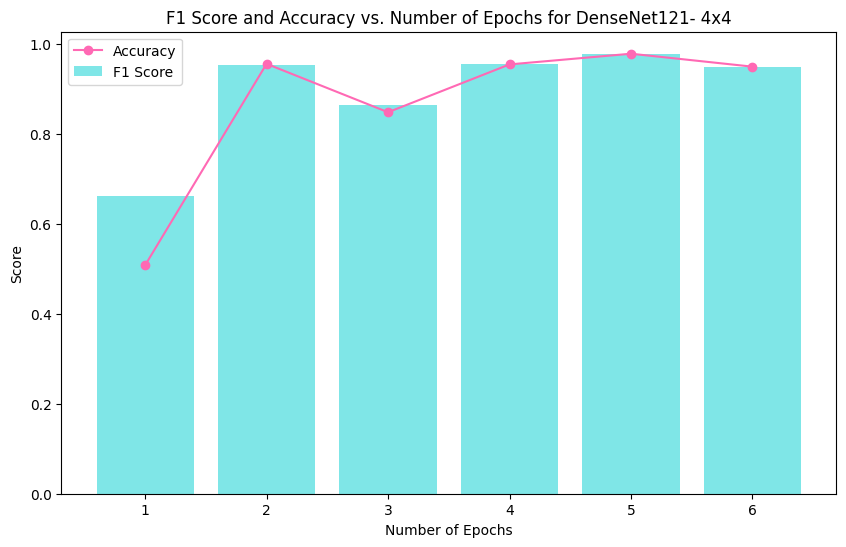

In [ ]:
plot_metrics_vs_epochs(results_densenet121_4x4_num_epochs,'DenseNet121- 4x4')

### **20-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_20x20_num_epochs = {}

for num_epochs in range(1, 7):
    print(f"Training for {num_epochs} epochs...")
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_model(googlenet, train_loader_20x20, criterion, optimizer, num_epochs=num_epochs)
    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_20x20)

    # Store results in the dictionary
    results_googlenet_20x20_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.7230
Epoch 1/1, Iteration 100, Train Loss: 0.5208
Epoch 1/1, Iteration 200, Train Loss: 0.7089
Training completed.
Final Training Accuracy: 0.7847

Test Set Evaluation Metrics:
Accuracy: 0.745
Precision: 0.6806387225548902
Recall: 0.8857142857142857
F1 Score: 0.7697516930022573
Confusion Matrix:
[[255 160]
 [ 44 341]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.6939
Epoch 1/2, Iteration 100, Train Loss: 0.2728
Epoch 1/2, Iteration 200, Train Loss: 0.2233
Epoch 2/2, Iteration 1, Train Loss: 0.2492
Epoch 2/2, Iteration 100, Train Loss: 0.5406
Epoch 2/2, Iteration 200, Train Loss: 0.3235
Training completed.
Final Training Accuracy: 0.8783

Test Set Evaluation Metrics:
Accuracy: 0.63875
Precision: 0.5718562874251497
Recall: 0.9922077922077922
F1 Score: 0.7255460588793923
Confusion Matrix:
[[129 286]
 [  3 382]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.5947
Epoch 1/3, Iteration 100, Train Loss: 0.3471
Epoch 1/3, Iteration 200, Train Loss: 0.4208
Epoch 2/3, Iteration 1, Train Loss: 0.6673
Epoch 2/3, Iteration 100, Train Loss: 0.4042
Epoch 2/3, Iteration 200, Train Loss: 0.3921
Epoch 3/3, Iteration 1, Train Loss: 0.2863
Epoch 3/3, Iteration 100, Train Loss: 0.3294
Epoch 3/3, Iteration 200, Train Loss: 0.4169
Training completed.
Final Training Accuracy: 0.8992

Test Set Evaluation Metrics:
Accuracy: 0.9075
Precision: 0.9237057220708447
Recall: 0.8805194805194805
F1 Score: 0.9015957446808511
Confusion Matrix:
[[387  28]
 [ 46 339]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.6296
Epoch 1/4, Iteration 100, Train Loss: 0.2852
Epoch 1/4, Iteration 200, Train Loss: 0.2650
Epoch 2/4, Iteration 1, Train Loss: 0.2390
Epoch 2/4, Iteration 100, Train Loss: 0.1527
Epoch 2/4, Iteration 200, Train Loss: 0.2450
Epoch 3/4, Iteration 1, Train Loss: 0.1928
Epoch 3/4, Iteration 100, Train Loss: 0.3907
Epoch 3/4, Iteration 200, Train Loss: 0.2171
Epoch 4/4, Iteration 1, Train Loss: 0.2406
Epoch 4/4, Iteration 100, Train Loss: 0.0840
Epoch 4/4, Iteration 200, Train Loss: 0.1318
Training completed.
Final Training Accuracy: 0.9255

Test Set Evaluation Metrics:
Accuracy: 0.90125
Precision: 0.9636363636363636
Recall: 0.825974025974026
F1 Score: 0.8895104895104895
Confusion Matrix:
[[403  12]
 [ 67 318]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.7364
Epoch 1/5, Iteration 100, Train Loss: 0.3914
Epoch 1/5, Iteration 200, Train Loss: 0.6184
Epoch 2/5, Iteration 1, Train Loss: 0.2336
Epoch 2/5, Iteration 100, Train Loss: 0.2431
Epoch 2/5, Iteration 200, Train Loss: 0.1016
Epoch 3/5, Iteration 1, Train Loss: 0.2348
Epoch 3/5, Iteration 100, Train Loss: 0.0671
Epoch 3/5, Iteration 200, Train Loss: 0.2371
Epoch 4/5, Iteration 1, Train Loss: 0.4050
Epoch 4/5, Iteration 100, Train Loss: 0.1271
Epoch 4/5, Iteration 200, Train Loss: 0.2566
Epoch 5/5, Iteration 1, Train Loss: 0.0971
Epoch 5/5, Iteration 100, Train Loss: 0.0416
Epoch 5/5, Iteration 200, Train Loss: 0.8795
Training completed.
Final Training Accuracy: 0.9402

Test Set Evaluation Metrics:
Accuracy: 0.91875
Precision: 0.9395604395604396
Recall: 0.8883116883116883
F1 Score: 0.9132176234979974
Confusion Matrix:
[[393  22]
 [ 43 342]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.6821
Epoch 1/6, Iteration 100, Train Loss: 0.7995
Epoch 1/6, Iteration 200, Train Loss: 0.5203
Epoch 2/6, Iteration 1, Train Loss: 0.3534
Epoch 2/6, Iteration 100, Train Loss: 0.2234
Epoch 2/6, Iteration 200, Train Loss: 0.3752
Epoch 3/6, Iteration 1, Train Loss: 0.2936
Epoch 3/6, Iteration 100, Train Loss: 0.1184
Epoch 3/6, Iteration 200, Train Loss: 0.1158
Epoch 4/6, Iteration 1, Train Loss: 0.3133
Epoch 4/6, Iteration 100, Train Loss: 0.3019
Epoch 4/6, Iteration 200, Train Loss: 0.2106
Epoch 5/6, Iteration 1, Train Loss: 0.0891
Epoch 5/6, Iteration 100, Train Loss: 0.1668
Epoch 5/6, Iteration 200, Train Loss: 0.0491
Epoch 6/6, Iteration 1, Train Loss: 0.2719
Epoch 6/6, Iteration 100, Train Loss: 0.0907
Epoch 6/6, Iteration 200, Train Loss: 0.0406
Training completed.
Final Training Accuracy: 0.9387

Test Set Evaluation Metrics:
Accuracy: 0.9
Precision: 0.9692307692307692
Recall: 0.8181818181818182
F1 Score: 0.8873239436619719
Confusion Matrix:
[[

In [ ]:
results_googlenet_20x20_num_epochs = {
    1: {'accuracy': 0.745, 'precision': 0.6806387225548902, 'recall': 0.8857142857142857, 'f1': 0.7697516930022573, 'confusion_matrix': [[255, 160], [44, 341]]},
    2: {'accuracy': 0.63875, 'precision': 0.5718562874251497, 'recall': 0.9922077922077922, 'f1': 0.7255460588793923, 'confusion_matrix': [[129, 286], [3, 382]]},
    3: {'accuracy': 0.9075, 'precision': 0.9237057220708447, 'recall': 0.8805194805194805, 'f1': 0.9015957446808511, 'confusion_matrix': [[387, 28], [46, 339]]},
    4: {'accuracy': 0.90125, 'precision': 0.9636363636363636, 'recall': 0.825974025974026, 'f1': 0.8895104895104895, 'confusion_matrix': [[403, 12], [67, 318]]},
    5: {'accuracy': 0.91875, 'precision': 0.9395604395604396, 'recall': 0.8883116883116883, 'f1': 0.9132176234979974, 'confusion_matrix': [[393, 22], [43, 342]]},
    6: {'accuracy': 0.9, 'precision': 0.9692307692307692, 'recall': 0.8181818181818182, 'f1': 0.8873239436619719, 'confusion_matrix': [[405, 10], [70, 315]]}
}

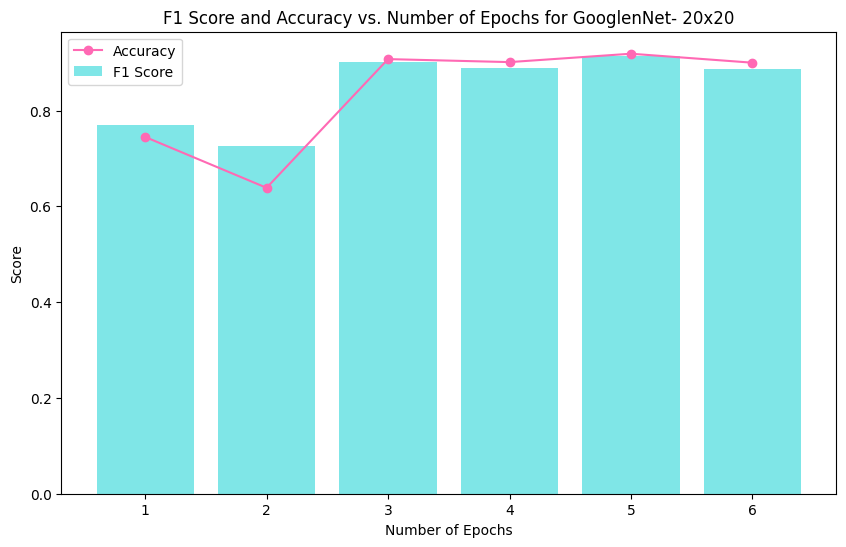

In [ ]:
plot_metrics_vs_epochs(results_googlenet_20x20_num_epochs,'GooglenNet- 20x20')

#### **DenseNet**

In [ ]:
results_densenet121_20x20_num_epochs = {}

for num_epochs in range(1, 7):
    print(f"Training for {num_epochs} epochs...")
    densenet121=densenet121_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(densenet121.parameters(), lr=0.001)

    train_model(densenet121, train_loader_20x20, criterion, optimizer, num_epochs=num_epochs)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(densenet121, test_loader_20x20)

    # Store results in the dictionary
    results_densenet121_20x20_num_epochs[num_epochs] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {num_epochs} epochs completed.")
    print("")
    print("")

Training for 1 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/1, Iteration 1, Train Loss: 0.6538
Epoch 1/1, Iteration 100, Train Loss: 0.3838
Epoch 1/1, Iteration 200, Train Loss: 0.3396
Training completed.
Final Training Accuracy: 0.7722

Test Set Evaluation Metrics:
Accuracy: 0.855
Precision: 0.7867803837953091
Recall: 0.9584415584415584
F1 Score: 0.8641686182669789
Confusion Matrix:
[[315 100]
 [ 16 369]]
Training for 1 epochs completed.


Training for 2 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/2, Iteration 1, Train Loss: 0.7389
Epoch 1/2, Iteration 100, Train Loss: 0.4733
Epoch 1/2, Iteration 200, Train Loss: 0.2081
Epoch 2/2, Iteration 1, Train Loss: 0.3477
Epoch 2/2, Iteration 100, Train Loss: 0.2235
Epoch 2/2, Iteration 200, Train Loss: 0.0595
Training completed.
Final Training Accuracy: 0.8626

Test Set Evaluation Metrics:
Accuracy: 0.9025
Precision: 0.896640826873385
Recall: 0.9012987012987013
F1 Score: 0.8989637305699482
Confusion Matrix:
[[375  40]
 [ 38 347]]
Training for 2 epochs completed.


Training for 3 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7343
Epoch 1/3, Iteration 100, Train Loss: 0.3148
Epoch 1/3, Iteration 200, Train Loss: 0.2030
Epoch 2/3, Iteration 1, Train Loss: 0.3810
Epoch 2/3, Iteration 100, Train Loss: 0.2435
Epoch 2/3, Iteration 200, Train Loss: 0.4424
Epoch 3/3, Iteration 1, Train Loss: 0.2270
Epoch 3/3, Iteration 100, Train Loss: 0.2166
Epoch 3/3, Iteration 200, Train Loss: 0.0812
Training completed.
Final Training Accuracy: 0.8870

Test Set Evaluation Metrics:
Accuracy: 0.78
Precision: 0.6876122082585279
Recall: 0.9948051948051948
F1 Score: 0.8131634819532909
Confusion Matrix:
[[241 174]
 [  2 383]]
Training for 3 epochs completed.


Training for 4 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/4, Iteration 1, Train Loss: 0.7677
Epoch 1/4, Iteration 100, Train Loss: 0.2678
Epoch 1/4, Iteration 200, Train Loss: 0.2919
Epoch 2/4, Iteration 1, Train Loss: 0.5984
Epoch 2/4, Iteration 100, Train Loss: 0.3590
Epoch 2/4, Iteration 200, Train Loss: 0.4643
Epoch 3/4, Iteration 1, Train Loss: 0.2506
Epoch 3/4, Iteration 100, Train Loss: 0.1083
Epoch 3/4, Iteration 200, Train Loss: 0.2876
Epoch 4/4, Iteration 1, Train Loss: 0.1751
Epoch 4/4, Iteration 100, Train Loss: 0.3139
Epoch 4/4, Iteration 200, Train Loss: 0.6387
Training completed.
Final Training Accuracy: 0.9086

Test Set Evaluation Metrics:
Accuracy: 0.74125
Precision: 0.6513605442176871
Recall: 0.9948051948051948
F1 Score: 0.7872559095580678
Confusion Matrix:
[[210 205]
 [  2 383]]
Training for 4 epochs completed.


Training for 5 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/5, Iteration 1, Train Loss: 0.6501
Epoch 1/5, Iteration 100, Train Loss: 0.6609
Epoch 1/5, Iteration 200, Train Loss: 0.6606
Epoch 2/5, Iteration 1, Train Loss: 0.2721
Epoch 2/5, Iteration 100, Train Loss: 0.0977
Epoch 2/5, Iteration 200, Train Loss: 0.0318
Epoch 3/5, Iteration 1, Train Loss: 0.3400
Epoch 3/5, Iteration 100, Train Loss: 0.2368
Epoch 3/5, Iteration 200, Train Loss: 0.2928
Epoch 4/5, Iteration 1, Train Loss: 0.4361
Epoch 4/5, Iteration 100, Train Loss: 0.4106
Epoch 4/5, Iteration 200, Train Loss: 0.2625
Epoch 5/5, Iteration 1, Train Loss: 0.4109
Epoch 5/5, Iteration 100, Train Loss: 0.0802
Epoch 5/5, Iteration 200, Train Loss: 0.2286
Training completed.
Final Training Accuracy: 0.9268

Test Set Evaluation Metrics:
Accuracy: 0.925
Precision: 0.935656836461126
Recall: 0.9064935064935065
F1 Score: 0.9208443271767809
Confusion Matrix:
[[391  24]
 [ 36 349]]
Training for 5 epochs completed.


Training for 6 epochs...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/6, Iteration 1, Train Loss: 0.7506
Epoch 1/6, Iteration 100, Train Loss: 0.5466
Epoch 1/6, Iteration 200, Train Loss: 0.3083
Epoch 2/6, Iteration 1, Train Loss: 0.2507
Epoch 2/6, Iteration 100, Train Loss: 0.1071
Epoch 2/6, Iteration 200, Train Loss: 1.0500
Epoch 3/6, Iteration 1, Train Loss: 0.2309
Epoch 3/6, Iteration 100, Train Loss: 0.3524
Epoch 3/6, Iteration 200, Train Loss: 0.4094
Epoch 4/6, Iteration 1, Train Loss: 0.0564
Epoch 4/6, Iteration 100, Train Loss: 0.0836
Epoch 4/6, Iteration 200, Train Loss: 0.0491
Epoch 5/6, Iteration 1, Train Loss: 0.1367
Epoch 5/6, Iteration 100, Train Loss: 0.5777
Epoch 5/6, Iteration 200, Train Loss: 0.0692
Epoch 6/6, Iteration 1, Train Loss: 0.1798
Epoch 6/6, Iteration 100, Train Loss: 0.1199
Epoch 6/6, Iteration 200, Train Loss: 0.5508
Training completed.
Final Training Accuracy: 0.9165

Test Set Evaluation Metrics:
Accuracy: 0.46125
Precision: 0.4430693069306931
Recall: 0.4649350649350649
F1 Score: 0.45373891001267425
Confusion Matri

In [ ]:
results_densenet121_20x20_num_epochs = {
    1: {'accuracy': 0.855, 'precision': 0.7867803837953091, 'recall': 0.9584415584415584, 'f1': 0.8641686182669789, 'confusion_matrix': [[315, 100], [16, 369]]},
    2: {'accuracy': 0.9025, 'precision': 0.896640826873385, 'recall': 0.9012987012987013, 'f1': 0.8989637305699482, 'confusion_matrix': [[375, 40], [38, 347]]},
    3: {'accuracy': 0.78, 'precision': 0.6876122082585279, 'recall': 0.9948051948051948, 'f1': 0.8131634819532909, 'confusion_matrix': [[241, 174], [2, 383]]},
    4: {'accuracy': 0.74125, 'precision': 0.6513605442176871, 'recall': 0.9948051948051948, 'f1': 0.7872559095580678, 'confusion_matrix': [[210, 205], [2, 383]]},
    5: {'accuracy': 0.925, 'precision': 0.935656836461126, 'recall': 0.9064935064935065, 'f1': 0.9208443271767809, 'confusion_matrix': [[391, 24], [36, 349]]},
    6: {'accuracy': 0.46125, 'precision': 0.4430693069306931, 'recall': 0.4649350649350649, 'f1': 0.45373891001267425, 'confusion_matrix': [[190, 225], [206, 179]]}
}

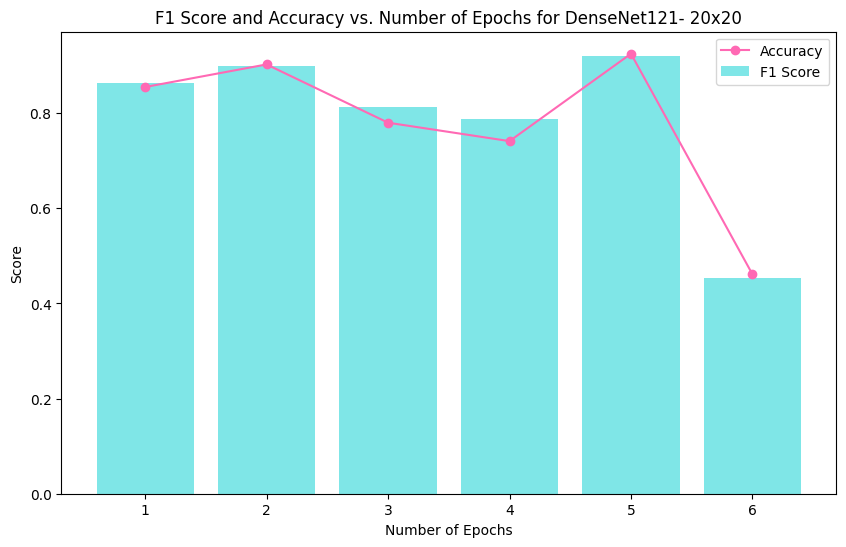

In [ ]:
plot_metrics_vs_epochs(results_densenet121_20x20_num_epochs,'DenseNet121- 20x20')

## **Batch Size Exploration**

In [ ]:
batch_sizes=[4,8,16,32,64]
for batch_size in batch_sizes:
  print(batch_size)

4
8
16
32
64


In [ ]:
def plot_metrics_vs_batchsize(results_batch_size, permutation_type):
    # Extract F1 scores and Accuracy from results dictionary
    f1_scores = [results_batch_size[batch_size]['f1'] for batch_size in [4,8,16,32,64]]
    accuracies = [results_batch_size[batch_size]['accuracy'] for batch_size in [4,8,16,32,64]]

    # Plotting
    plt.figure(figsize=(10, 6))

    # Plot F1 scores
    plt.bar([4,8,16,32,64], f1_scores, color='#00CED1', alpha=0.5, label='F1 Score')

    # Plot Accuracy
    plt.plot([4,8,16,32,64], accuracies, color='#FF69B4', marker='o', label='Accuracy')

    # Adding labels and title
    plt.xlabel('Batch Size')
    plt.ylabel('Score')
    plt.title(f'F1 Score and Accuracy vs. Batch Size for {permutation_type}')
    plt.legend()

    # Set x-axis ticks explicitly to batch sizes
    plt.xticks([4,8,16,32,64])

    plt.show()


### **Baseline**
#### **GoogleNet**

In [ ]:
results_googlenet_batch_size = {}

for batch_size in batch_sizes:
    print(f"Training for {batch_size} batch size...")
    googlenet = googlenet_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

    # Train the model
    train_model(googlenet, train_loader, criterion, optimizer, num_epochs=3)
    print(f"Training for {batch_size} batch size completed.")

    print(f"Testing for batch size {batch_size}...")

    # Test the model
    accuracy, precision, recall, f1, confusion_matrix = test_model(googlenet, test_loader)

    # Store results in the dictionary
    results_googlenet_batch_size[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }

    print(f"Testing for batch size {batch_size} completed.")
    print("")
    print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.5904
Epoch 1/3, Iteration 100, Train Loss: 0.8385
Epoch 1/3, Iteration 200, Train Loss: 0.1269
Epoch 1/3, Iteration 300, Train Loss: 0.2685
Epoch 1/3, Iteration 400, Train Loss: 0.1158
Epoch 1/3, Iteration 500, Train Loss: 0.1680
Epoch 1/3, Iteration 600, Train Loss: 0.1580
Epoch 1/3, Iteration 700, Train Loss: 0.1348
Epoch 2/3, Iteration 1, Train Loss: 0.0554
Epoch 2/3, Iteration 100, Train Loss: 0.9197
Epoch 2/3, Iteration 200, Train Loss: 0.0111
Epoch 2/3, Iteration 300, Train Loss: 0.0323
Epoch 2/3, Iteration 400, Train Loss: 0.0470
Epoch 2/3, Iteration 500, Train Loss: 0.0315
Epoch 2/3, Iteration 600, Train Loss: 0.2847
Epoch 2/3, Iteration 700, Train Loss: 0.1848
Epoch 3/3, Iteration 1, Train Loss: 0.0196
Epoch 3/3, Iteration 100, Train Loss: 0.2945
Epoch 3/3, Iteration 200, Train Loss: 0.0966
Epoch 3/3, Iteration 300, Train Loss: 1.1394
Epoch 3/3, Iteration 400, Train Loss: 0.3945
Epoch 3/3, Iteration 500, Train Loss: 0.2168
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7748
Epoch 1/3, Iteration 100, Train Loss: 0.9374
Epoch 1/3, Iteration 200, Train Loss: 1.2325
Epoch 1/3, Iteration 300, Train Loss: 0.0435
Epoch 1/3, Iteration 400, Train Loss: 0.0527
Epoch 2/3, Iteration 1, Train Loss: 0.0979
Epoch 2/3, Iteration 100, Train Loss: 0.1230
Epoch 2/3, Iteration 200, Train Loss: 0.0779
Epoch 2/3, Iteration 300, Train Loss: 0.0691
Epoch 2/3, Iteration 400, Train Loss: 0.0448
Epoch 3/3, Iteration 1, Train Loss: 0.0479
Epoch 3/3, Iteration 100, Train Loss: 0.1742
Epoch 3/3, Iteration 200, Train Loss: 0.2662
Epoch 3/3, Iteration 300, Train Loss: 0.0266
Epoch 3/3, Iteration 400, Train Loss: 0.0215
Training completed.
Final Training Accuracy: 0.9596

Test Set Evaluation Metrics:
Accuracy: 0.95625
Precision: 0.9247572815533981
Recall: 0.9896103896103896
F1 Score: 0.9560853199498119
Confusion Matrix:
[[384  31]
 [  4 381]]
Training for 8 batch size completed.


Training for 16 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6697
Epoch 1/3, Iteration 100, Train Loss: 0.0892
Epoch 1/3, Iteration 200, Train Loss: 0.1279
Epoch 2/3, Iteration 1, Train Loss: 0.0131
Epoch 2/3, Iteration 100, Train Loss: 0.1343
Epoch 2/3, Iteration 200, Train Loss: 0.0276
Epoch 3/3, Iteration 1, Train Loss: 0.0143
Epoch 3/3, Iteration 100, Train Loss: 0.0119
Epoch 3/3, Iteration 200, Train Loss: 0.0162
Training completed.
Final Training Accuracy: 0.9753

Test Set Evaluation Metrics:
Accuracy: 0.99125
Precision: 0.9896373056994818
Recall: 0.9922077922077922
F1 Score: 0.9909208819714656
Confusion Matrix:
[[411   4]
 [  3 382]]
Training for 16 batch size completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7267
Epoch 1/3, Iteration 100, Train Loss: 0.0237
Epoch 2/3, Iteration 1, Train Loss: 0.0173
Epoch 2/3, Iteration 100, Train Loss: 0.2043
Epoch 3/3, Iteration 1, Train Loss: 0.0273
Epoch 3/3, Iteration 100, Train Loss: 0.0045
Training completed.
Final Training Accuracy: 0.9853

Test Set Evaluation Metrics:
Accuracy: 0.9875
Precision: 0.9947229551451188
Recall: 0.9792207792207792
F1 Score: 0.9869109947643979
Confusion Matrix:
[[413   2]
 [  8 377]]
Training for 32 batch size completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6754
Epoch 2/3, Iteration 1, Train Loss: 0.0110
Epoch 3/3, Iteration 1, Train Loss: 0.0028
Training completed.
Final Training Accuracy: 0.9906

Test Set Evaluation Metrics:
Accuracy: 0.985
Precision: 0.9920844327176781
Recall: 0.9766233766233766
F1 Score: 0.9842931937172775
Confusion Matrix:
[[412   3]
 [  9 376]]
Training for 64 batch size completed.




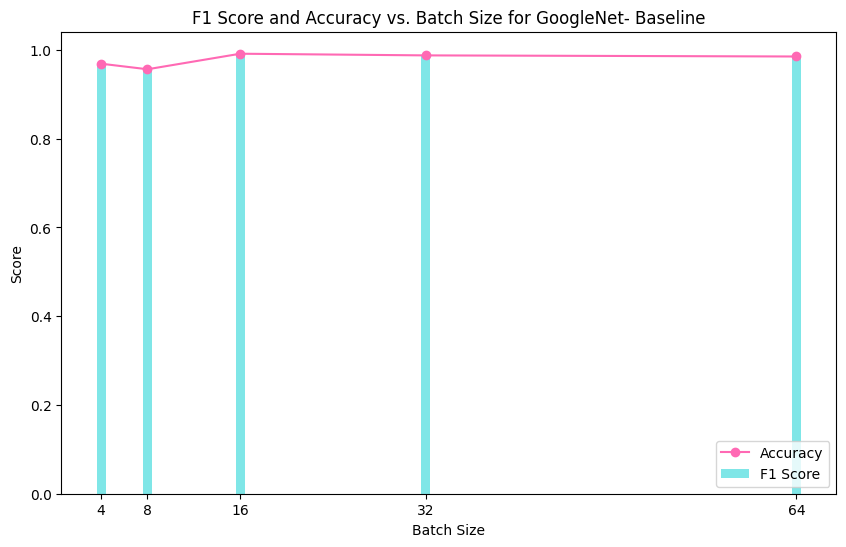

In [ ]:
results_googlenet_batch_size = {
    4: {'accuracy': 0.96875, 'f1': 0.9677},
    8: {'accuracy': 0.95625, 'f1': 0.9561},
    16: {'accuracy': 0.99125, 'f1': 0.9909},
    32: {'accuracy': 0.9875, 'f1': 0.9869},
    64: {'accuracy': 0.985, 'f1': 0.9843}
}

plot_metrics_vs_batchsize(results_googlenet_batch_size, 'GoogleNet- Baseline')

#### **DenseNet**

In [ ]:
results_densenet121_batch_size = {}

for batch_size in batch_sizes:
  print(f"Training for {batch_size} batch size...")
  densenet121=densenet121_model()

  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=0.001)

  train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
  train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
  test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
  test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

  # Train the model
  train_model(densenet121, train_loader, criterion, optimizer,num_epochs=3)
  print(f"Training for {batch_size} batch size completed.")

  print(f"Testing for batch size {batch_size}...")
  # Test the model
  accuracy, precision, recall, f1, confusion_matrix = test_model(densenet121, test_loader)

  # Store results in the dictionary
  results_densenet121_batch_size[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }
  print(f"Testing for batch size {batch_size} completed.")
  print("")
  print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 167MB/s]


Epoch 1/3, Iteration 1, Train Loss: 0.6760
Epoch 1/3, Iteration 100, Train Loss: 0.5951
Epoch 1/3, Iteration 200, Train Loss: 0.0551
Epoch 1/3, Iteration 300, Train Loss: 1.4842
Epoch 1/3, Iteration 400, Train Loss: 0.3966
Epoch 1/3, Iteration 500, Train Loss: 0.3849
Epoch 1/3, Iteration 600, Train Loss: 0.0838
Epoch 1/3, Iteration 700, Train Loss: 0.1553
Epoch 2/3, Iteration 1, Train Loss: 0.0137
Epoch 2/3, Iteration 100, Train Loss: 0.1624
Epoch 2/3, Iteration 200, Train Loss: 0.3761
Epoch 2/3, Iteration 300, Train Loss: 0.1024
Epoch 2/3, Iteration 400, Train Loss: 0.6035
Epoch 2/3, Iteration 500, Train Loss: 0.1499
Epoch 2/3, Iteration 600, Train Loss: 0.3788
Epoch 2/3, Iteration 700, Train Loss: 0.1603
Epoch 3/3, Iteration 1, Train Loss: 0.2584
Epoch 3/3, Iteration 100, Train Loss: 0.1623
Epoch 3/3, Iteration 200, Train Loss: 0.0922
Epoch 3/3, Iteration 300, Train Loss: 0.0464
Epoch 3/3, Iteration 400, Train Loss: 1.4065
Epoch 3/3, Iteration 500, Train Loss: 0.2017
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6879
Epoch 1/3, Iteration 100, Train Loss: 0.2187
Epoch 1/3, Iteration 200, Train Loss: 0.1512
Epoch 1/3, Iteration 300, Train Loss: 0.6150
Epoch 1/3, Iteration 400, Train Loss: 0.1344
Epoch 2/3, Iteration 1, Train Loss: 0.1071
Epoch 2/3, Iteration 100, Train Loss: 1.2321
Epoch 2/3, Iteration 200, Train Loss: 0.0844
Epoch 2/3, Iteration 300, Train Loss: 0.0608
Epoch 2/3, Iteration 400, Train Loss: 0.0025
Epoch 3/3, Iteration 1, Train Loss: 0.0149
Epoch 3/3, Iteration 100, Train Loss: 0.0568
Epoch 3/3, Iteration 200, Train Loss: 0.0285
Epoch 3/3, Iteration 300, Train Loss: 0.3968
Epoch 3/3, Iteration 400, Train Loss: 0.0827
Training completed.
Final Training Accuracy: 0.9387

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.9475
Precision: 0.9914040114613181
Recall: 0.8987012987012987
F1 Score: 0.9427792915531336
Confusion Matrix:
[[412   3]
 [ 39 346]]
Testing for batch size 8 completed.


Tr

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6748
Epoch 1/3, Iteration 100, Train Loss: 0.0379
Epoch 1/3, Iteration 200, Train Loss: 0.1406
Epoch 2/3, Iteration 1, Train Loss: 0.0195
Epoch 2/3, Iteration 100, Train Loss: 0.1802
Epoch 2/3, Iteration 200, Train Loss: 0.0263
Epoch 3/3, Iteration 1, Train Loss: 0.0959
Epoch 3/3, Iteration 100, Train Loss: 0.0789
Epoch 3/3, Iteration 200, Train Loss: 0.0404
Training completed.
Final Training Accuracy: 0.9709

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.98625
Precision: 0.9819587628865979
Recall: 0.9896103896103896
F1 Score: 0.9857697283311772
Confusion Matrix:
[[408   7]
 [  4 381]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7017
Epoch 1/3, Iteration 100, Train Loss: 0.1973
Epoch 2/3, Iteration 1, Train Loss: 0.0821
Epoch 2/3, Iteration 100, Train Loss: 0.1839
Epoch 3/3, Iteration 1, Train Loss: 0.0095
Epoch 3/3, Iteration 100, Train Loss: 0.0800
Training completed.
Final Training Accuracy: 0.9793

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.9475
Precision: 0.9073634204275535
Recall: 0.9922077922077922
F1 Score: 0.9478908188585607
Confusion Matrix:
[[376  39]
 [  3 382]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.8691
Epoch 2/3, Iteration 1, Train Loss: 0.0413
Epoch 3/3, Iteration 1, Train Loss: 0.0161
Training completed.
Final Training Accuracy: 0.9856

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.9875
Precision: 0.9947229551451188
Recall: 0.9792207792207792
F1 Score: 0.9869109947643979
Confusion Matrix:
[[413   2]
 [  8 377]]
Testing for batch size 64 completed.




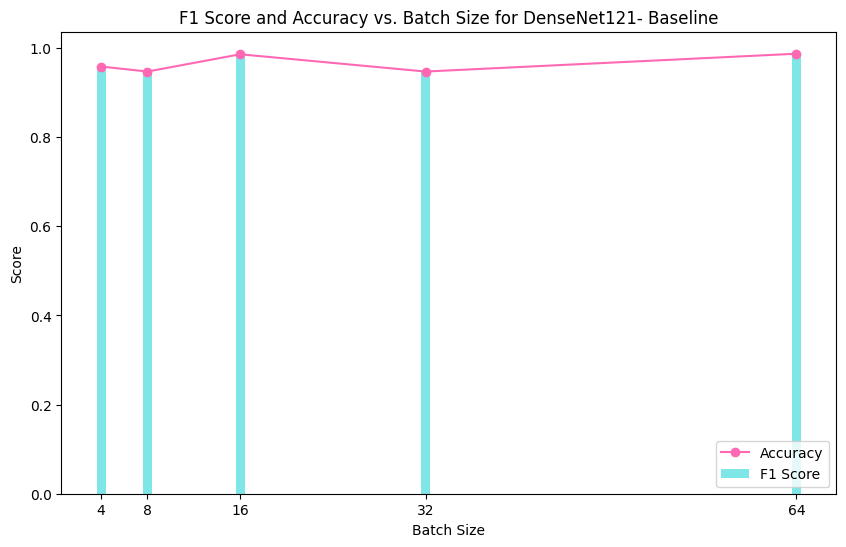

In [ ]:
results_densenet121_batch_size = {
    4: {'accuracy': 0.95875, 'f1': 0.9579},
    8: {'accuracy': 0.9475, 'f1': 0.9428},
    16: {'accuracy': 0.98625, 'f1': 0.9858},
    32: {'accuracy': 0.9475, 'f1': 0.9479},
    64: {'accuracy': 0.9875, 'f1': 0.9869}
}

plot_metrics_vs_batchsize(results_densenet121_batch_size, 'DenseNet121- Baseline')

### **2-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_batch_size_2x2 = {}

for batch_size in batch_sizes:
    print(f"Training for {batch_size} batch size...")
    googlenet = googlenet_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_dataset_2x2 = TensorDataset(X_train_tensor_2x2, y_train_tensor_2x2)
    train_loader_2x2 = DataLoader(train_dataset_2x2, batch_size=batch_size, shuffle=True)
    test_dataset_2x2 = TensorDataset(X_test_tensor_2x2, y_test_tensor_2x2)
    test_loader_2x2 = DataLoader(test_dataset_2x2, batch_size=batch_size, shuffle=True)

    # Train the model
    train_model(googlenet, train_loader_2x2, criterion, optimizer, num_epochs=3)
    print(f"Training for {batch_size} batch size completed.")

    print(f"Testing for batch size {batch_size}...")

    # Test the model
    accuracy, precision, recall, f1, confusion_matrix = test_model(googlenet, test_loader_2x2)

    # Store results in the dictionary
    results_googlenet_batch_size_2x2[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }

    print(f"Testing for batch size {batch_size} completed.")
    print("")
    print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/googlenet-1378be20.pth" to /root/.cache/torch/hub/checkpoints/googlenet-1378be20.pth
100%|██████████| 49.7M/49.7M [00:00<00:00, 158MB/s]


Epoch 1/3, Iteration 1, Train Loss: 0.7467
Epoch 1/3, Iteration 100, Train Loss: 0.4669
Epoch 1/3, Iteration 200, Train Loss: 0.0963
Epoch 1/3, Iteration 300, Train Loss: 0.9853
Epoch 1/3, Iteration 400, Train Loss: 0.3847
Epoch 1/3, Iteration 500, Train Loss: 0.8431
Epoch 1/3, Iteration 600, Train Loss: 0.0675
Epoch 1/3, Iteration 700, Train Loss: 0.0654
Epoch 2/3, Iteration 1, Train Loss: 0.2611
Epoch 2/3, Iteration 100, Train Loss: 0.3844
Epoch 2/3, Iteration 200, Train Loss: 0.0981
Epoch 2/3, Iteration 300, Train Loss: 0.5033
Epoch 2/3, Iteration 400, Train Loss: 0.0515
Epoch 2/3, Iteration 500, Train Loss: 0.5897
Epoch 2/3, Iteration 600, Train Loss: 0.7086
Epoch 2/3, Iteration 700, Train Loss: 0.2826
Epoch 3/3, Iteration 1, Train Loss: 0.4541
Epoch 3/3, Iteration 100, Train Loss: 0.0682
Epoch 3/3, Iteration 200, Train Loss: 0.3448
Epoch 3/3, Iteration 300, Train Loss: 0.4905
Epoch 3/3, Iteration 400, Train Loss: 0.2143
Epoch 3/3, Iteration 500, Train Loss: 0.0923
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7001
Epoch 1/3, Iteration 100, Train Loss: 0.3051
Epoch 1/3, Iteration 200, Train Loss: 0.2903
Epoch 1/3, Iteration 300, Train Loss: 1.1367
Epoch 1/3, Iteration 400, Train Loss: 0.0310
Epoch 2/3, Iteration 1, Train Loss: 0.0491
Epoch 2/3, Iteration 100, Train Loss: 0.0363
Epoch 2/3, Iteration 200, Train Loss: 0.1848
Epoch 2/3, Iteration 300, Train Loss: 0.0987
Epoch 2/3, Iteration 400, Train Loss: 0.1346
Epoch 3/3, Iteration 1, Train Loss: 0.0167
Epoch 3/3, Iteration 100, Train Loss: 0.0742
Epoch 3/3, Iteration 200, Train Loss: 0.0169
Epoch 3/3, Iteration 300, Train Loss: 0.0469
Epoch 3/3, Iteration 400, Train Loss: 0.0501
Training completed.
Final Training Accuracy: 0.9443

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.9375
Precision: 0.9883381924198251
Recall: 0.8805194805194805
F1 Score: 0.9313186813186813
Confusion Matrix:
[[411   4]
 [ 46 339]]
Testing for batch size 8 completed.


Tr

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7409
Epoch 1/3, Iteration 100, Train Loss: 0.1407
Epoch 1/3, Iteration 200, Train Loss: 0.1391
Epoch 2/3, Iteration 1, Train Loss: 0.0177
Epoch 2/3, Iteration 100, Train Loss: 0.1279
Epoch 2/3, Iteration 200, Train Loss: 0.1017
Epoch 3/3, Iteration 1, Train Loss: 0.0260
Epoch 3/3, Iteration 100, Train Loss: 0.1255
Epoch 3/3, Iteration 200, Train Loss: 0.0250
Training completed.
Final Training Accuracy: 0.9728

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.97625
Precision: 0.9945945945945946
Recall: 0.9558441558441558
F1 Score: 0.9748344370860927
Confusion Matrix:
[[413   2]
 [ 17 368]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7962
Epoch 1/3, Iteration 100, Train Loss: 0.2414
Epoch 2/3, Iteration 1, Train Loss: 0.0248
Epoch 2/3, Iteration 100, Train Loss: 0.0148
Epoch 3/3, Iteration 1, Train Loss: 0.0465
Epoch 3/3, Iteration 100, Train Loss: 0.0492
Training completed.
Final Training Accuracy: 0.9844

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.98375
Precision: 0.9946808510638298
Recall: 0.9714285714285714
F1 Score: 0.9829172141918529
Confusion Matrix:
[[413   2]
 [ 11 374]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7090
Epoch 2/3, Iteration 1, Train Loss: 0.0458
Epoch 3/3, Iteration 1, Train Loss: 0.0033
Training completed.
Final Training Accuracy: 0.9928

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.98625
Precision: 0.9895287958115183
Recall: 0.9818181818181818
F1 Score: 0.985658409387223
Confusion Matrix:
[[411   4]
 [  7 378]]
Testing for batch size 64 completed.




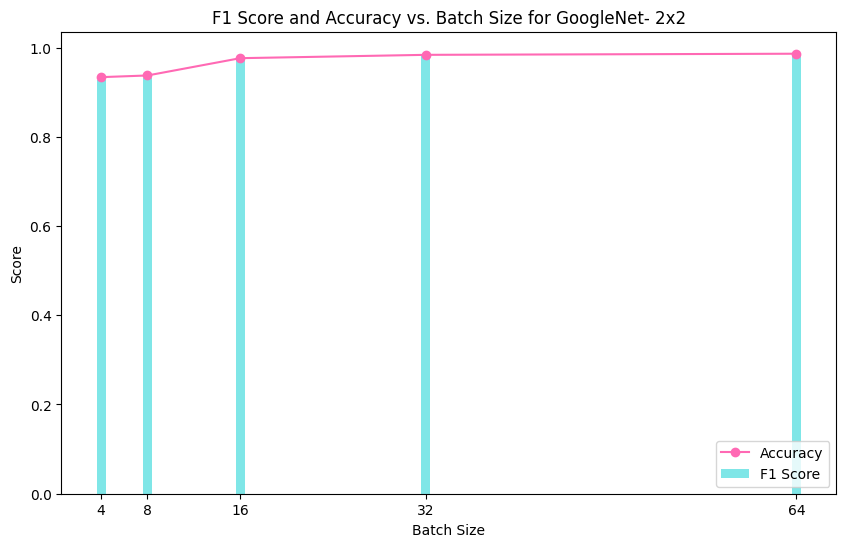

In [ ]:
results_googlenet_batch_size_2x2 = {
    4: {'accuracy': 0.93375, 'f1': 0.9275},
    8: {'accuracy': 0.9375, 'f1': 0.9313},
    16: {'accuracy': 0.97625, 'f1': 0.9748},
    32: {'accuracy': 0.98375, 'f1': 0.9829},
    64: {'accuracy': 0.98625, 'f1': 0.9857}
}

plot_metrics_vs_batchsize(results_googlenet_batch_size_2x2, 'GoogleNet- 2x2')

#### **DenseNet**

In [ ]:
results_densenet121_batch_size_2x2 = {}

for batch_size in batch_sizes:
  print(f"Training for {batch_size} batch size...")
  densenet121=densenet121_model()

  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=0.001)

  train_dataset_2x2 = TensorDataset(X_train_tensor_2x2, y_train_tensor_2x2)
  train_loader_2x2 = DataLoader(train_dataset_2x2, batch_size=batch_size, shuffle=True)
  test_dataset_2x2 = TensorDataset(X_test_tensor_2x2, y_test_tensor_2x2)
  test_loader_2x2 = DataLoader(test_dataset_2x2, batch_size=batch_size, shuffle=True)

  # Train the model
  train_model(densenet121, train_loader_2x2, criterion, optimizer,num_epochs=3)
  print(f"Training for {batch_size} batch size completed.")

  print(f"Testing for batch size {batch_size}...")
  # Test the model
  accuracy, precision, recall, f1, confusion_matrix = test_model(densenet121, test_loader_2x2)

  # Store results in the dictionary
  results_densenet121_batch_size_2x2[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }
  print(f"Testing for batch size {batch_size} completed.")
  print("")
  print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 156MB/s]


Epoch 1/3, Iteration 1, Train Loss: 0.6923
Epoch 1/3, Iteration 100, Train Loss: 0.2562
Epoch 1/3, Iteration 200, Train Loss: 0.1610
Epoch 1/3, Iteration 300, Train Loss: 0.2100
Epoch 1/3, Iteration 400, Train Loss: 1.2479
Epoch 1/3, Iteration 500, Train Loss: 0.3490
Epoch 1/3, Iteration 600, Train Loss: 0.3486
Epoch 1/3, Iteration 700, Train Loss: 0.2230
Epoch 2/3, Iteration 1, Train Loss: 0.8509
Epoch 2/3, Iteration 100, Train Loss: 0.0460
Epoch 2/3, Iteration 200, Train Loss: 0.6065
Epoch 2/3, Iteration 300, Train Loss: 0.1066
Epoch 2/3, Iteration 400, Train Loss: 0.5105
Epoch 2/3, Iteration 500, Train Loss: 0.1022
Epoch 2/3, Iteration 600, Train Loss: 0.0769
Epoch 2/3, Iteration 700, Train Loss: 0.1298
Epoch 3/3, Iteration 1, Train Loss: 0.1156
Epoch 3/3, Iteration 100, Train Loss: 0.0558
Epoch 3/3, Iteration 200, Train Loss: 0.6333
Epoch 3/3, Iteration 300, Train Loss: 0.0410
Epoch 3/3, Iteration 400, Train Loss: 0.0454
Epoch 3/3, Iteration 500, Train Loss: 0.4484
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6329
Epoch 1/3, Iteration 100, Train Loss: 0.2844
Epoch 1/3, Iteration 200, Train Loss: 0.2559
Epoch 1/3, Iteration 300, Train Loss: 0.9074
Epoch 1/3, Iteration 400, Train Loss: 0.2293
Epoch 2/3, Iteration 1, Train Loss: 1.0231
Epoch 2/3, Iteration 100, Train Loss: 0.0689
Epoch 2/3, Iteration 200, Train Loss: 0.1766
Epoch 2/3, Iteration 300, Train Loss: 0.0577
Epoch 2/3, Iteration 400, Train Loss: 0.4775
Epoch 3/3, Iteration 1, Train Loss: 0.1900
Epoch 3/3, Iteration 100, Train Loss: 0.0077
Epoch 3/3, Iteration 200, Train Loss: 0.8412
Epoch 3/3, Iteration 300, Train Loss: 0.0118
Epoch 3/3, Iteration 400, Train Loss: 0.0566
Training completed.
Final Training Accuracy: 0.9258

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.7375
Precision: 0.6480541455160744
Recall: 0.9948051948051948
F1 Score: 0.7848360655737704
Confusion Matrix:
[[207 208]
 [  2 383]]
Testing for batch size 8 completed.


Tr

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.8597
Epoch 1/3, Iteration 100, Train Loss: 0.0958
Epoch 1/3, Iteration 200, Train Loss: 0.1177
Epoch 2/3, Iteration 1, Train Loss: 0.2246
Epoch 2/3, Iteration 100, Train Loss: 0.0392
Epoch 2/3, Iteration 200, Train Loss: 0.0949
Epoch 3/3, Iteration 1, Train Loss: 0.0078
Epoch 3/3, Iteration 100, Train Loss: 0.0020
Epoch 3/3, Iteration 200, Train Loss: 0.1593
Training completed.
Final Training Accuracy: 0.9609

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.965
Precision: 0.9473684210526315
Recall: 0.9818181818181818
F1 Score: 0.9642857142857142
Confusion Matrix:
[[394  21]
 [  7 378]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7319
Epoch 1/3, Iteration 100, Train Loss: 0.0436
Epoch 2/3, Iteration 1, Train Loss: 0.1119
Epoch 2/3, Iteration 100, Train Loss: 0.0222
Epoch 3/3, Iteration 1, Train Loss: 0.1105
Epoch 3/3, Iteration 100, Train Loss: 0.0316
Training completed.
Final Training Accuracy: 0.9722

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.96625
Precision: 0.9365853658536586
Recall: 0.9974025974025974
F1 Score: 0.9660377358490566
Confusion Matrix:
[[389  26]
 [  1 384]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7605
Epoch 2/3, Iteration 1, Train Loss: 0.0999
Epoch 3/3, Iteration 1, Train Loss: 0.0739
Training completed.
Final Training Accuracy: 0.9800

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.8925
Precision: 0.8174097664543525
Recall: 1.0
F1 Score: 0.8995327102803738
Confusion Matrix:
[[329  86]
 [  0 385]]
Testing for batch size 64 completed.




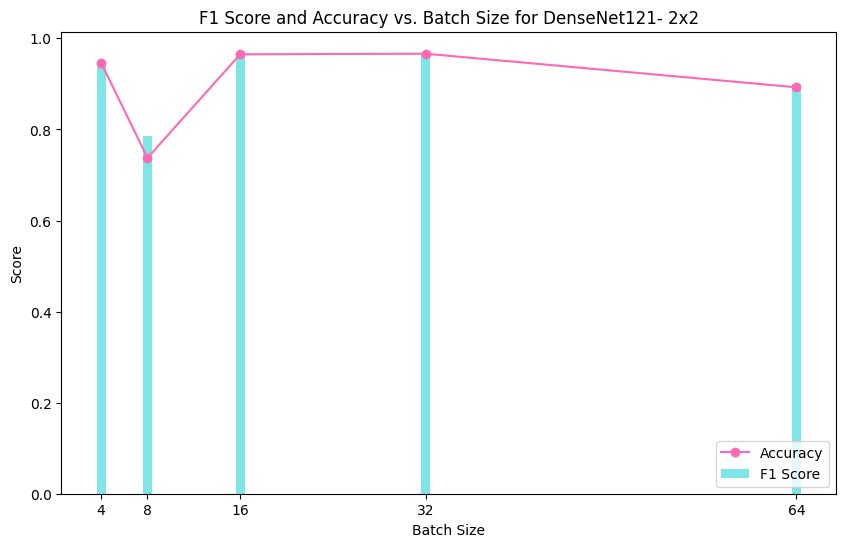

In [ ]:
results_densenet121_batch_size_2x2 = {
    4: {'accuracy': 0.94625, 'f1': 0.9458},
    8: {'accuracy': 0.7375, 'f1': 0.7848},
    16: {'accuracy': 0.965, 'f1': 0.9643},
    32: {'accuracy': 0.96625, 'f1': 0.9660},
    64: {'accuracy': 0.8925, 'f1': 0.8995}
}

plot_metrics_vs_batchsize(results_densenet121_batch_size_2x2, 'DenseNet121- 2x2')

### **3-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_batch_size_3x3 = {}

for batch_size in batch_sizes:
    print(f"Training for {batch_size} batch size...")
    googlenet = googlenet_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_dataset_3x3 = TensorDataset(X_train_tensor_3x3, y_train_tensor_3x3)
    train_loader_3x3 = DataLoader(train_dataset_3x3, batch_size=batch_size, shuffle=True)
    test_dataset_3x3 = TensorDataset(X_test_tensor_3x3, y_test_tensor_3x3)
    test_loader_3x3 = DataLoader(test_dataset_3x3, batch_size=batch_size, shuffle=True)

    # Train the model
    train_model(googlenet, train_loader_3x3, criterion, optimizer, num_epochs=3)
    print(f"Training for {batch_size} batch size completed.")

    print(f"Testing for batch size {batch_size}...")

    # Test the model
    accuracy, precision, recall, f1, confusion_matrix = test_model(googlenet, test_loader_3x3)

    # Store results in the dictionary
    results_googlenet_batch_size_3x3[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }

    print(f"Testing for batch size {batch_size} completed.")
    print("")
    print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7968
Epoch 1/3, Iteration 100, Train Loss: 0.2015
Epoch 1/3, Iteration 200, Train Loss: 0.3365
Epoch 1/3, Iteration 300, Train Loss: 1.0132
Epoch 1/3, Iteration 400, Train Loss: 0.7439
Epoch 1/3, Iteration 500, Train Loss: 0.4026
Epoch 1/3, Iteration 600, Train Loss: 0.1417
Epoch 1/3, Iteration 700, Train Loss: 0.1197
Epoch 2/3, Iteration 1, Train Loss: 0.2894
Epoch 2/3, Iteration 100, Train Loss: 0.9174
Epoch 2/3, Iteration 200, Train Loss: 0.1235
Epoch 2/3, Iteration 300, Train Loss: 0.1333
Epoch 2/3, Iteration 400, Train Loss: 0.2759
Epoch 2/3, Iteration 500, Train Loss: 0.0400
Epoch 2/3, Iteration 600, Train Loss: 0.0410
Epoch 2/3, Iteration 700, Train Loss: 0.0815
Epoch 3/3, Iteration 1, Train Loss: 0.0693
Epoch 3/3, Iteration 100, Train Loss: 0.1316
Epoch 3/3, Iteration 200, Train Loss: 0.2048
Epoch 3/3, Iteration 300, Train Loss: 0.0695
Epoch 3/3, Iteration 400, Train Loss: 0.1538
Epoch 3/3, Iteration 500, Train Loss: 0.0741
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7077
Epoch 1/3, Iteration 100, Train Loss: 0.2361
Epoch 1/3, Iteration 200, Train Loss: 0.1802
Epoch 1/3, Iteration 300, Train Loss: 0.4188
Epoch 1/3, Iteration 400, Train Loss: 0.1621
Epoch 2/3, Iteration 1, Train Loss: 0.2129
Epoch 2/3, Iteration 100, Train Loss: 0.1702
Epoch 2/3, Iteration 200, Train Loss: 0.2002
Epoch 2/3, Iteration 300, Train Loss: 0.1545
Epoch 2/3, Iteration 400, Train Loss: 0.1097
Epoch 3/3, Iteration 1, Train Loss: 0.0527
Epoch 3/3, Iteration 100, Train Loss: 0.1578
Epoch 3/3, Iteration 200, Train Loss: 0.0488
Epoch 3/3, Iteration 300, Train Loss: 0.0248
Epoch 3/3, Iteration 400, Train Loss: 0.0984
Training completed.
Final Training Accuracy: 0.9340

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.9525
Precision: 0.9242053789731052
Recall: 0.9818181818181818
F1 Score: 0.9521410579345088
Confusion Matrix:
[[384  31]
 [  7 378]]
Testing for batch size 8 completed.


Tr

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7788
Epoch 1/3, Iteration 100, Train Loss: 0.3524
Epoch 1/3, Iteration 200, Train Loss: 0.1450
Epoch 2/3, Iteration 1, Train Loss: 0.4164
Epoch 2/3, Iteration 100, Train Loss: 0.1228
Epoch 2/3, Iteration 200, Train Loss: 0.0683
Epoch 3/3, Iteration 1, Train Loss: 0.0681
Epoch 3/3, Iteration 100, Train Loss: 0.0324
Epoch 3/3, Iteration 200, Train Loss: 0.2603
Training completed.
Final Training Accuracy: 0.9581

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.84
Precision: 0.7524557956777996
Recall: 0.9948051948051948
F1 Score: 0.8568232662192393
Confusion Matrix:
[[289 126]
 [  2 383]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7523
Epoch 1/3, Iteration 100, Train Loss: 0.1135
Epoch 2/3, Iteration 1, Train Loss: 0.0407
Epoch 2/3, Iteration 100, Train Loss: 0.0309
Epoch 3/3, Iteration 1, Train Loss: 0.0145
Epoch 3/3, Iteration 100, Train Loss: 0.0666
Training completed.
Final Training Accuracy: 0.9765

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.95
Precision: 0.9389312977099237
Recall: 0.9584415584415584
F1 Score: 0.9485861182519281
Confusion Matrix:
[[391  24]
 [ 16 369]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6786
Epoch 2/3, Iteration 1, Train Loss: 0.0413
Epoch 3/3, Iteration 1, Train Loss: 0.1617
Training completed.
Final Training Accuracy: 0.9837

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.97
Precision: 0.989159891598916
Recall: 0.948051948051948
F1 Score: 0.9681697612732095
Confusion Matrix:
[[411   4]
 [ 20 365]]
Testing for batch size 64 completed.




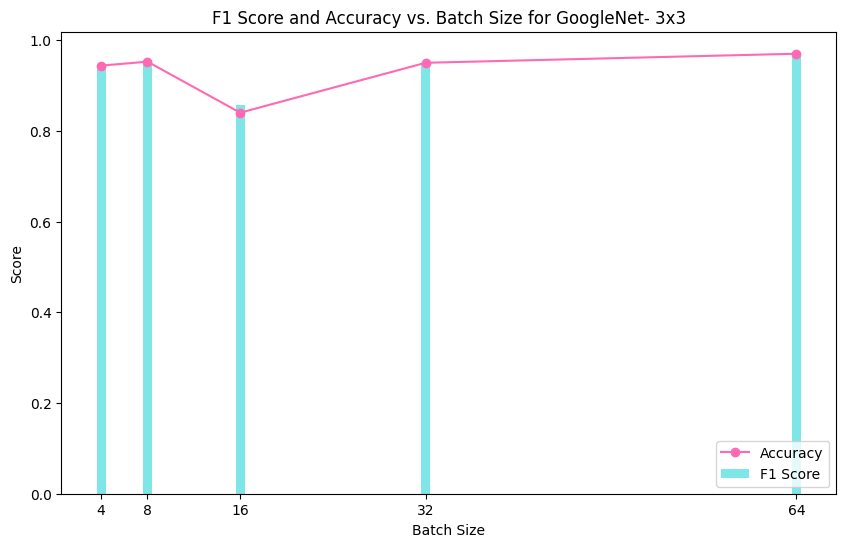

In [ ]:
results_googlenet_batch_size_3x3 = {
    4: {'accuracy': 0.94375, 'f1': 0.9438},
    8: {'accuracy': 0.9525, 'f1': 0.9521},
    16: {'accuracy': 0.84, 'f1': 0.8568},
    32: {'accuracy': 0.95, 'f1': 0.9486},
    64: {'accuracy': 0.97, 'f1': 0.9682}
}

plot_metrics_vs_batchsize(results_googlenet_batch_size_3x3, 'GoogleNet- 3x3')

#### **DenseNet**

In [ ]:
results_densenet121_batch_size_3x3 = {}

for batch_size in batch_sizes:
  print(f"Training for {batch_size} batch size...")
  densenet121=densenet121_model()

  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=0.001)

  train_dataset_3x3 = TensorDataset(X_train_tensor_3x3, y_train_tensor_3x3)
  train_loader_3x3 = DataLoader(train_dataset_3x3, batch_size=batch_size, shuffle=True)
  test_dataset_3x3 = TensorDataset(X_test_tensor_3x3, y_test_tensor_3x3)
  test_loader_3x3 = DataLoader(test_dataset_3x3, batch_size=batch_size, shuffle=True)

  # Train the model
  train_model(densenet121, train_loader_3x3, criterion, optimizer,num_epochs=3)
  print(f"Training for {batch_size} batch size completed.")

  print(f"Testing for batch size {batch_size}...")
  # Test the model
  accuracy, precision, recall, f1, confusion_matrix = test_model(densenet121, test_loader_3x3)

  # Store results in the dictionary
  results_densenet121_batch_size_3x3[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }
  print(f"Testing for batch size {batch_size} completed.")
  print("")
  print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 94.0MB/s]


Epoch 1/3, Iteration 1, Train Loss: 0.9604
Epoch 1/3, Iteration 100, Train Loss: 0.4701
Epoch 1/3, Iteration 200, Train Loss: 0.1846
Epoch 1/3, Iteration 300, Train Loss: 0.2572
Epoch 1/3, Iteration 400, Train Loss: 0.1092
Epoch 1/3, Iteration 500, Train Loss: 0.9497
Epoch 1/3, Iteration 600, Train Loss: 0.1566
Epoch 1/3, Iteration 700, Train Loss: 1.8105
Epoch 2/3, Iteration 1, Train Loss: 0.1542
Epoch 2/3, Iteration 100, Train Loss: 1.4546
Epoch 2/3, Iteration 200, Train Loss: 0.1154
Epoch 2/3, Iteration 300, Train Loss: 0.1888
Epoch 2/3, Iteration 400, Train Loss: 0.3957
Epoch 2/3, Iteration 500, Train Loss: 0.6035
Epoch 2/3, Iteration 600, Train Loss: 0.1556
Epoch 2/3, Iteration 700, Train Loss: 0.0969
Epoch 3/3, Iteration 1, Train Loss: 0.3605
Epoch 3/3, Iteration 100, Train Loss: 0.1406
Epoch 3/3, Iteration 200, Train Loss: 0.3366
Epoch 3/3, Iteration 300, Train Loss: 0.0515
Epoch 3/3, Iteration 400, Train Loss: 0.3278
Epoch 3/3, Iteration 500, Train Loss: 0.1665
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.5899
Epoch 1/3, Iteration 100, Train Loss: 0.4781
Epoch 1/3, Iteration 200, Train Loss: 0.4525
Epoch 1/3, Iteration 300, Train Loss: 0.2153
Epoch 1/3, Iteration 400, Train Loss: 0.4290
Epoch 2/3, Iteration 1, Train Loss: 0.1518
Epoch 2/3, Iteration 100, Train Loss: 0.2302
Epoch 2/3, Iteration 200, Train Loss: 0.1483
Epoch 2/3, Iteration 300, Train Loss: 0.1876
Epoch 2/3, Iteration 400, Train Loss: 0.0144
Epoch 3/3, Iteration 1, Train Loss: 0.0399
Epoch 3/3, Iteration 100, Train Loss: 0.0255
Epoch 3/3, Iteration 200, Train Loss: 0.3247
Epoch 3/3, Iteration 300, Train Loss: 0.0519
Epoch 3/3, Iteration 400, Train Loss: 0.0762
Training completed.
Final Training Accuracy: 0.9233

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.95625
Precision: 0.9557291666666666
Recall: 0.9532467532467532
F1 Score: 0.954486345903771
Confusion Matrix:
[[398  17]
 [ 18 367]]
Testing for batch size 8 completed.


Tr

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6697
Epoch 1/3, Iteration 100, Train Loss: 0.1162
Epoch 1/3, Iteration 200, Train Loss: 0.1095
Epoch 2/3, Iteration 1, Train Loss: 0.0921
Epoch 2/3, Iteration 100, Train Loss: 0.1001
Epoch 2/3, Iteration 200, Train Loss: 0.0395
Epoch 3/3, Iteration 1, Train Loss: 0.0815
Epoch 3/3, Iteration 100, Train Loss: 0.0944
Epoch 3/3, Iteration 200, Train Loss: 0.1865
Training completed.
Final Training Accuracy: 0.9521

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.90375
Precision: 0.9583333333333334
Recall: 0.8363636363636363
F1 Score: 0.8932038834951457
Confusion Matrix:
[[401  14]
 [ 63 322]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.8723
Epoch 1/3, Iteration 100, Train Loss: 0.1835
Epoch 2/3, Iteration 1, Train Loss: 0.0280
Epoch 2/3, Iteration 100, Train Loss: 0.3595
Epoch 3/3, Iteration 1, Train Loss: 0.1362
Epoch 3/3, Iteration 100, Train Loss: 0.0336
Training completed.
Final Training Accuracy: 0.9628

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.965
Precision: 0.9496221662468514
Recall: 0.9792207792207792
F1 Score: 0.9641943734015345
Confusion Matrix:
[[395  20]
 [  8 377]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6654
Epoch 2/3, Iteration 1, Train Loss: 0.0903
Epoch 3/3, Iteration 1, Train Loss: 0.1368
Training completed.
Final Training Accuracy: 0.9740

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.9325
Precision: 0.8857808857808858
Recall: 0.987012987012987
F1 Score: 0.9336609336609336
Confusion Matrix:
[[366  49]
 [  5 380]]
Testing for batch size 64 completed.




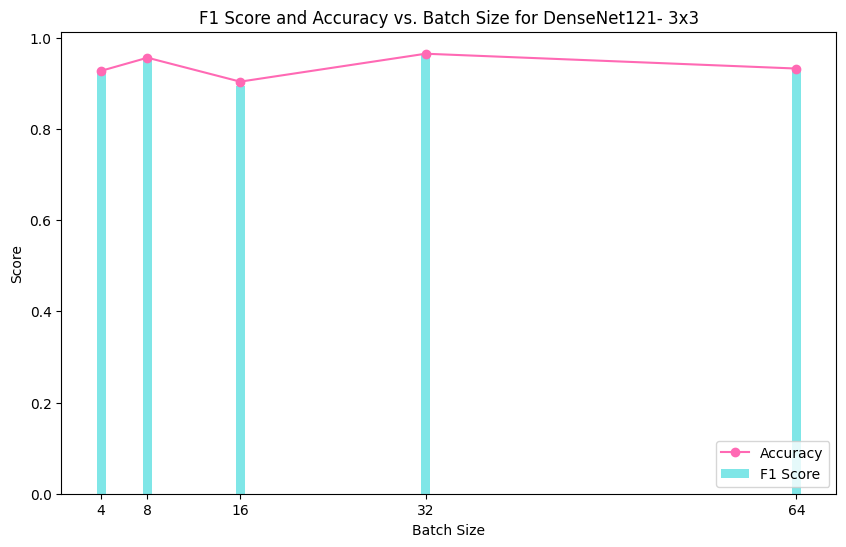

In [ ]:
results_densenet121_batch_size_3x3 = {
    4: {'accuracy': 0.9275, 'f1': 0.9284},
    8: {'accuracy': 0.95625, 'f1': 0.9545},
    16: {'accuracy': 0.90375, 'f1': 0.8932},
    32: {'accuracy': 0.965, 'f1': 0.9642},
    64: {'accuracy': 0.9325, 'f1': 0.9337}
}

plot_metrics_vs_batchsize(results_densenet121_batch_size_3x3, 'DenseNet121- 3x3')

### **4-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_batch_size_4x4 = {}

for batch_size in batch_sizes:
    print(f"Training for {batch_size} batch size...")
    googlenet = googlenet_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_dataset_4x4 = TensorDataset(X_train_tensor_4x4, y_train_tensor_4x4)
    train_loader_4x4 = DataLoader(train_dataset_4x4, batch_size=batch_size, shuffle=True)
    test_dataset_4x4 = TensorDataset(X_test_tensor_4x4, y_test_tensor_4x4)
    test_loader_4x4 = DataLoader(test_dataset_4x4, batch_size=batch_size, shuffle=True)

    # Train the model
    train_model(googlenet, train_loader_4x4, criterion, optimizer, num_epochs=3)
    print(f"Training for {batch_size} batch size completed.")

    print(f"Testing for batch size {batch_size}...")

    # Test the model
    accuracy, precision, recall, f1, confusion_matrix = test_model(googlenet, test_loader_4x4)

    # Store results in the dictionary
    results_googlenet_batch_size_4x4[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }

    print(f"Testing for batch size {batch_size} completed.")
    print("")
    print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6789
Epoch 1/3, Iteration 100, Train Loss: 0.3204
Epoch 1/3, Iteration 200, Train Loss: 0.2311
Epoch 1/3, Iteration 300, Train Loss: 0.0587
Epoch 1/3, Iteration 400, Train Loss: 0.9091
Epoch 1/3, Iteration 500, Train Loss: 0.0886
Epoch 1/3, Iteration 600, Train Loss: 1.6182
Epoch 1/3, Iteration 700, Train Loss: 0.8090
Epoch 2/3, Iteration 1, Train Loss: 0.6293
Epoch 2/3, Iteration 100, Train Loss: 0.2061
Epoch 2/3, Iteration 200, Train Loss: 0.2556
Epoch 2/3, Iteration 300, Train Loss: 0.0905
Epoch 2/3, Iteration 400, Train Loss: 0.9882
Epoch 2/3, Iteration 500, Train Loss: 0.1815
Epoch 2/3, Iteration 600, Train Loss: 0.8285
Epoch 2/3, Iteration 700, Train Loss: 0.4478
Epoch 3/3, Iteration 1, Train Loss: 0.3546
Epoch 3/3, Iteration 100, Train Loss: 0.4730
Epoch 3/3, Iteration 200, Train Loss: 0.0738
Epoch 3/3, Iteration 300, Train Loss: 0.8732
Epoch 3/3, Iteration 400, Train Loss: 0.2121
Epoch 3/3, Iteration 500, Train Loss: 0.1801
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7617
Epoch 1/3, Iteration 100, Train Loss: 0.2534
Epoch 1/3, Iteration 200, Train Loss: 0.3207
Epoch 1/3, Iteration 300, Train Loss: 0.4499
Epoch 1/3, Iteration 400, Train Loss: 0.1217
Epoch 2/3, Iteration 1, Train Loss: 0.1176
Epoch 2/3, Iteration 100, Train Loss: 0.0612
Epoch 2/3, Iteration 200, Train Loss: 0.0314
Epoch 2/3, Iteration 300, Train Loss: 0.0138
Epoch 2/3, Iteration 400, Train Loss: 0.0228
Epoch 3/3, Iteration 1, Train Loss: 0.1842
Epoch 3/3, Iteration 100, Train Loss: 0.1899
Epoch 3/3, Iteration 200, Train Loss: 0.3200
Epoch 3/3, Iteration 300, Train Loss: 0.1630
Epoch 3/3, Iteration 400, Train Loss: 2.6514
Training completed.
Final Training Accuracy: 0.9190

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.96375
Precision: 0.961139896373057
Recall: 0.9636363636363636
F1 Score: 0.9623865110246432
Confusion Matrix:
[[400  15]
 [ 14 371]]
Testing for batch size 8 completed.


Tr

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6054
Epoch 1/3, Iteration 100, Train Loss: 0.1568
Epoch 1/3, Iteration 200, Train Loss: 0.1326
Epoch 2/3, Iteration 1, Train Loss: 0.2862
Epoch 2/3, Iteration 100, Train Loss: 0.0207
Epoch 2/3, Iteration 200, Train Loss: 0.1146
Epoch 3/3, Iteration 1, Train Loss: 0.0217
Epoch 3/3, Iteration 100, Train Loss: 0.1900
Epoch 3/3, Iteration 200, Train Loss: 0.0402
Training completed.
Final Training Accuracy: 0.9568

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.97
Precision: 0.9762532981530343
Recall: 0.961038961038961
F1 Score: 0.968586387434555
Confusion Matrix:
[[406   9]
 [ 15 370]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7974
Epoch 1/3, Iteration 100, Train Loss: 0.3541
Epoch 2/3, Iteration 1, Train Loss: 0.0677
Epoch 2/3, Iteration 100, Train Loss: 0.0305
Epoch 3/3, Iteration 1, Train Loss: 0.0931
Epoch 3/3, Iteration 100, Train Loss: 0.0383
Training completed.
Final Training Accuracy: 0.9700

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.895
Precision: 0.8264642082429501
Recall: 0.9896103896103896
F1 Score: 0.900709219858156
Confusion Matrix:
[[335  80]
 [  4 381]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7019
Epoch 2/3, Iteration 1, Train Loss: 0.0367
Epoch 3/3, Iteration 1, Train Loss: 0.0495
Training completed.
Final Training Accuracy: 0.9862

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.9525
Precision: 0.9832869080779945
Recall: 0.9168831168831169
F1 Score: 0.9489247311827957
Confusion Matrix:
[[409   6]
 [ 32 353]]
Testing for batch size 64 completed.




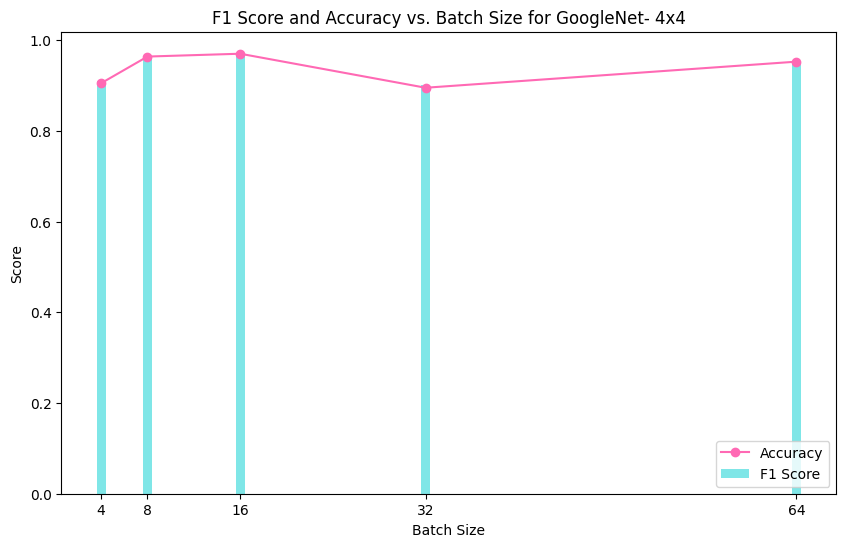

In [ ]:
results_googlenet_batch_size_4x4 = {
    4: {'accuracy': 0.905, 'f1': 0.9089},
    8: {'accuracy': 0.96375, 'f1': 0.9624},
    16: {'accuracy': 0.97, 'f1': 0.9686},
    32: {'accuracy': 0.895, 'f1': 0.9007},
    64: {'accuracy': 0.9525, 'f1': 0.9489}
}

plot_metrics_vs_batchsize(results_googlenet_batch_size_4x4, 'GoogleNet- 4x4')

#### **DenseNet**

In [ ]:
results_densenet121_batch_size_4x4 = {}

for batch_size in batch_sizes:
  print(f"Training for {batch_size} batch size...")
  densenet121=densenet121_model()

  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=0.001)

  train_dataset_4x4 = TensorDataset(X_train_tensor_4x4, y_train_tensor_4x4)
  train_loader_4x4 = DataLoader(train_dataset_4x4, batch_size=batch_size, shuffle=True)
  test_dataset_4x4 = TensorDataset(X_test_tensor_4x4, y_test_tensor_4x4)
  test_loader_4x4 = DataLoader(test_dataset_4x4, batch_size=batch_size, shuffle=True)

  # Train the model
  train_model(densenet121, train_loader_4x4, criterion, optimizer,num_epochs=3)
  print(f"Training for {batch_size} batch size completed.")

  print(f"Testing for batch size {batch_size}...")
  # Test the model
  accuracy, precision, recall, f1, confusion_matrix = test_model(densenet121, test_loader_4x4)

  # Store results in the dictionary
  results_densenet121_batch_size_4x4[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }
  print(f"Testing for batch size {batch_size} completed.")
  print("")
  print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.5732
Epoch 1/3, Iteration 100, Train Loss: 0.7029
Epoch 1/3, Iteration 200, Train Loss: 0.3020
Epoch 1/3, Iteration 300, Train Loss: 0.4825
Epoch 1/3, Iteration 400, Train Loss: 0.7288
Epoch 1/3, Iteration 500, Train Loss: 0.2919
Epoch 1/3, Iteration 600, Train Loss: 0.6316
Epoch 1/3, Iteration 700, Train Loss: 0.7265
Epoch 2/3, Iteration 1, Train Loss: 0.2550
Epoch 2/3, Iteration 100, Train Loss: 0.2839
Epoch 2/3, Iteration 200, Train Loss: 1.2483
Epoch 2/3, Iteration 300, Train Loss: 1.0906
Epoch 2/3, Iteration 400, Train Loss: 0.7397
Epoch 2/3, Iteration 500, Train Loss: 1.1725
Epoch 2/3, Iteration 600, Train Loss: 0.3858
Epoch 2/3, Iteration 700, Train Loss: 1.0798
Epoch 3/3, Iteration 1, Train Loss: 0.2991
Epoch 3/3, Iteration 100, Train Loss: 0.2164
Epoch 3/3, Iteration 200, Train Loss: 0.5231
Epoch 3/3, Iteration 300, Train Loss: 1.1217
Epoch 3/3, Iteration 400, Train Loss: 0.5070
Epoch 3/3, Iteration 500, Train Loss: 0.1101
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6579
Epoch 1/3, Iteration 100, Train Loss: 0.3731
Epoch 1/3, Iteration 200, Train Loss: 0.7098
Epoch 1/3, Iteration 300, Train Loss: 0.6035
Epoch 1/3, Iteration 400, Train Loss: 0.0512
Epoch 2/3, Iteration 1, Train Loss: 0.3034
Epoch 2/3, Iteration 100, Train Loss: 0.1872
Epoch 2/3, Iteration 200, Train Loss: 0.4074
Epoch 2/3, Iteration 300, Train Loss: 0.2593
Epoch 2/3, Iteration 400, Train Loss: 0.8711
Epoch 3/3, Iteration 1, Train Loss: 0.1125
Epoch 3/3, Iteration 100, Train Loss: 0.0578
Epoch 3/3, Iteration 200, Train Loss: 0.1058
Epoch 3/3, Iteration 300, Train Loss: 0.2956
Epoch 3/3, Iteration 400, Train Loss: 0.0715
Training completed.
Final Training Accuracy: 0.9133

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.93
Precision: 0.8764302059496567
Recall: 0.9948051948051948
F1 Score: 0.9318734793187348
Confusion Matrix:
[[361  54]
 [  2 383]]
Testing for batch size 8 completed.


Trai

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7601
Epoch 1/3, Iteration 100, Train Loss: 0.0438
Epoch 1/3, Iteration 200, Train Loss: 0.1457
Epoch 2/3, Iteration 1, Train Loss: 0.0862
Epoch 2/3, Iteration 100, Train Loss: 0.0235
Epoch 2/3, Iteration 200, Train Loss: 0.2883
Epoch 3/3, Iteration 1, Train Loss: 0.1721
Epoch 3/3, Iteration 100, Train Loss: 0.0426
Epoch 3/3, Iteration 200, Train Loss: 0.3207
Training completed.
Final Training Accuracy: 0.9462

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.855
Precision: 0.9926739926739927
Recall: 0.7038961038961039
F1 Score: 0.82370820668693
Confusion Matrix:
[[413   2]
 [114 271]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7948
Epoch 1/3, Iteration 100, Train Loss: 0.4135
Epoch 2/3, Iteration 1, Train Loss: 0.1419
Epoch 2/3, Iteration 100, Train Loss: 0.0905
Epoch 3/3, Iteration 1, Train Loss: 0.0500
Epoch 3/3, Iteration 100, Train Loss: 0.1073
Training completed.
Final Training Accuracy: 0.9750

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.79
Precision: 0.9909502262443439
Recall: 0.5688311688311688
F1 Score: 0.7227722772277227
Confusion Matrix:
[[413   2]
 [166 219]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7644
Epoch 2/3, Iteration 1, Train Loss: 0.0375
Epoch 3/3, Iteration 1, Train Loss: 0.0440
Training completed.
Final Training Accuracy: 0.9797

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.96875
Precision: 0.96875
Recall: 0.9662337662337662
F1 Score: 0.9674902470741222
Confusion Matrix:
[[403  12]
 [ 13 372]]
Testing for batch size 64 completed.




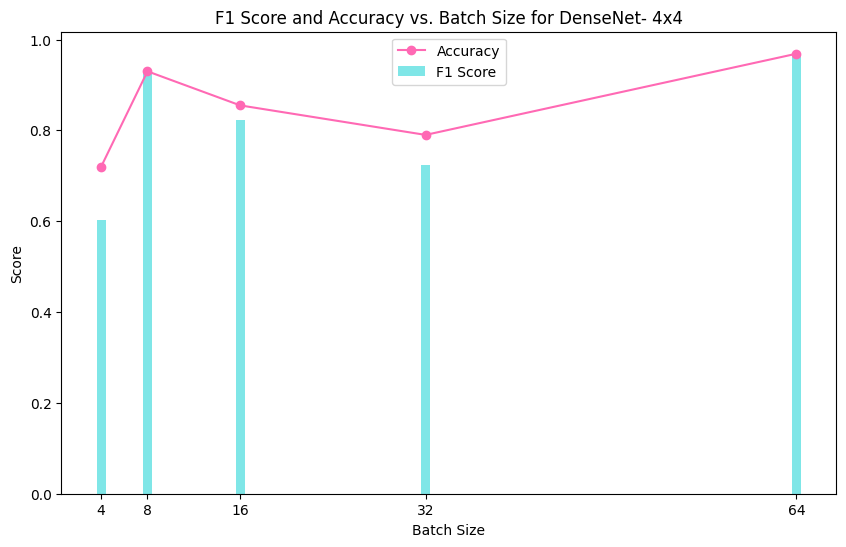

In [ ]:
results_densenet121_batch_size_4x4 = {
    4: {'accuracy': 0.72, 'f1': 0.6028},
    8: {'accuracy': 0.93, 'f1': 0.9319},
    16: {'accuracy': 0.855, 'f1': 0.8237},
    32: {'accuracy': 0.79, 'f1': 0.7228},
    64: {'accuracy': 0.96875, 'f1': 0.9675}
}

plot_metrics_vs_batchsize(results_densenet121_batch_size_4x4, 'DenseNet- 4x4')

### **20-Tile Permutations**
#### **GoogleNet**

In [ ]:
results_googlenet_batch_size_20x20 = {}

for batch_size in batch_sizes:
    print(f"Training for {batch_size} batch size...")
    googlenet = googlenet_model()

    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=0.001)

    train_dataset_20x20 = TensorDataset(X_train_tensor_20x20, y_train_tensor_20x20)
    train_loader_20x20 = DataLoader(train_dataset_20x20, batch_size=batch_size, shuffle=True)
    test_dataset_20x20 = TensorDataset(X_test_tensor_20x20, y_test_tensor_20x20)
    test_loader_20x20 = DataLoader(test_dataset_20x20, batch_size=batch_size, shuffle=True)

    # Train the model
    train_model(googlenet, train_loader_20x20, criterion, optimizer, num_epochs=3)
    print(f"Training for {batch_size} batch size completed.")

    print(f"Testing for batch size {batch_size}...")

    # Test the model
    accuracy, precision, recall, f1, confusion_matrix = test_model(googlenet, test_loader_20x20)

    # Store results in the dictionary
    results_googlenet_batch_size_20x20[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }

    print(f"Testing for batch size {batch_size} completed.")
    print("")
    print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7253
Epoch 1/3, Iteration 100, Train Loss: 0.6885
Epoch 1/3, Iteration 200, Train Loss: 0.8404
Epoch 1/3, Iteration 300, Train Loss: 0.8501
Epoch 1/3, Iteration 400, Train Loss: 0.2778
Epoch 1/3, Iteration 500, Train Loss: 0.3004
Epoch 1/3, Iteration 600, Train Loss: 0.8184
Epoch 1/3, Iteration 700, Train Loss: 0.2047
Epoch 2/3, Iteration 1, Train Loss: 0.1500
Epoch 2/3, Iteration 100, Train Loss: 0.3280
Epoch 2/3, Iteration 200, Train Loss: 0.2592
Epoch 2/3, Iteration 300, Train Loss: 0.3525
Epoch 2/3, Iteration 400, Train Loss: 0.0990
Epoch 2/3, Iteration 500, Train Loss: 0.4624
Epoch 2/3, Iteration 600, Train Loss: 0.2739
Epoch 2/3, Iteration 700, Train Loss: 0.2657
Epoch 3/3, Iteration 1, Train Loss: 0.3506
Epoch 3/3, Iteration 100, Train Loss: 0.3582
Epoch 3/3, Iteration 200, Train Loss: 0.8002
Epoch 3/3, Iteration 300, Train Loss: 0.4757
Epoch 3/3, Iteration 400, Train Loss: 0.3138
Epoch 3/3, Iteration 500, Train Loss: 0.1769
Epoch 3/3, Itera

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7518
Epoch 1/3, Iteration 100, Train Loss: 0.7608
Epoch 1/3, Iteration 200, Train Loss: 0.3922
Epoch 1/3, Iteration 300, Train Loss: 0.7219
Epoch 1/3, Iteration 400, Train Loss: 0.3534
Epoch 2/3, Iteration 1, Train Loss: 0.3236
Epoch 2/3, Iteration 100, Train Loss: 0.9364
Epoch 2/3, Iteration 200, Train Loss: 0.3578
Epoch 2/3, Iteration 300, Train Loss: 0.1708
Epoch 2/3, Iteration 400, Train Loss: 0.3618
Epoch 3/3, Iteration 1, Train Loss: 0.1407
Epoch 3/3, Iteration 100, Train Loss: 0.1069
Epoch 3/3, Iteration 200, Train Loss: 0.0952
Epoch 3/3, Iteration 300, Train Loss: 0.2622
Epoch 3/3, Iteration 400, Train Loss: 0.5805
Training completed.
Final Training Accuracy: 0.8698

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.78
Precision: 0.9906103286384976
Recall: 0.548051948051948
F1 Score: 0.705685618729097
Confusion Matrix:
[[413   2]
 [174 211]]
Testing for batch size 8 completed.


Traini

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6889
Epoch 1/3, Iteration 100, Train Loss: 0.4608
Epoch 1/3, Iteration 200, Train Loss: 0.4682
Epoch 2/3, Iteration 1, Train Loss: 0.5973
Epoch 2/3, Iteration 100, Train Loss: 0.3047
Epoch 2/3, Iteration 200, Train Loss: 0.9123
Epoch 3/3, Iteration 1, Train Loss: 0.0371
Epoch 3/3, Iteration 100, Train Loss: 0.3509
Epoch 3/3, Iteration 200, Train Loss: 0.3062
Training completed.
Final Training Accuracy: 0.8964

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.86625
Precision: 0.9512987012987013
Recall: 0.7610389610389611
F1 Score: 0.8455988455988457
Confusion Matrix:
[[400  15]
 [ 92 293]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7544
Epoch 1/3, Iteration 100, Train Loss: 0.2543
Epoch 2/3, Iteration 1, Train Loss: 0.2495
Epoch 2/3, Iteration 100, Train Loss: 0.3339
Epoch 3/3, Iteration 1, Train Loss: 0.4110
Epoch 3/3, Iteration 100, Train Loss: 0.7764
Training completed.
Final Training Accuracy: 0.9215

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.875
Precision: 0.9641693811074918
Recall: 0.7688311688311689
F1 Score: 0.8554913294797688
Confusion Matrix:
[[404  11]
 [ 89 296]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6750
Epoch 2/3, Iteration 1, Train Loss: 0.2452
Epoch 3/3, Iteration 1, Train Loss: 0.1120
Training completed.
Final Training Accuracy: 0.9543

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.89125
Precision: 0.8743718592964824
Recall: 0.9038961038961039
F1 Score: 0.8888888888888888
Confusion Matrix:
[[365  50]
 [ 37 348]]
Testing for batch size 64 completed.




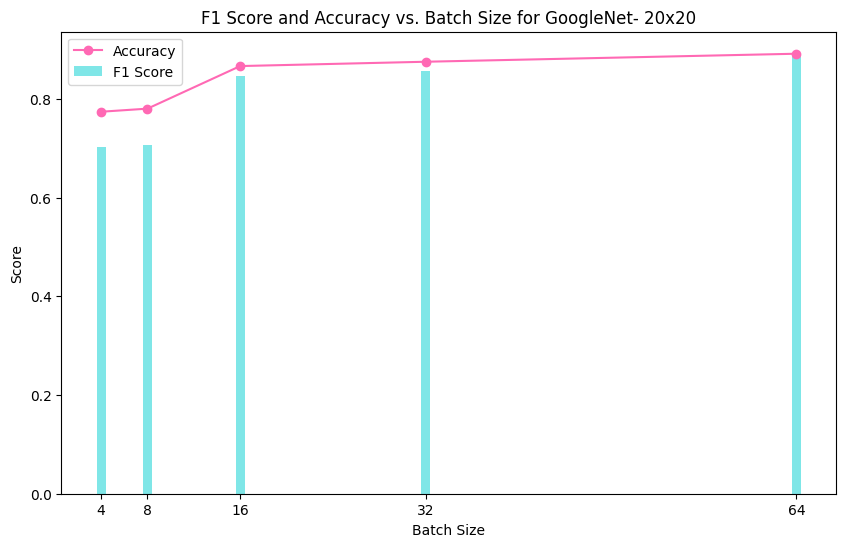

In [ ]:
results_googlenet_batch_size_20x20 = {
    4: {'accuracy': 0.77375, 'f1': 0.7028},
    8: {'accuracy': 0.78, 'f1': 0.7057},
    16: {'accuracy': 0.86625, 'f1': 0.8456},
    32: {'accuracy': 0.875, 'f1': 0.8555},
    64: {'accuracy': 0.89125, 'f1': 0.8889}
}

plot_metrics_vs_batchsize(results_googlenet_batch_size_20x20, 'GoogleNet- 20x20')

#### **DenseNet**

In [ ]:
results_densenet121_batch_size_20x20 = {}

for batch_size in batch_sizes:
  print(f"Training for {batch_size} batch size...")
  densenet121=densenet121_model()

  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=0.001)

  train_dataset_20x20 = TensorDataset(X_train_tensor_20x20, y_train_tensor_20x20)
  train_loader_20x20 = DataLoader(train_dataset_20x20, batch_size=batch_size, shuffle=True)
  test_dataset_20x20 = TensorDataset(X_test_tensor_20x20, y_test_tensor_20x20)
  test_loader_20x20 = DataLoader(test_dataset_20x20, batch_size=batch_size, shuffle=True)

  # Train the model
  train_model(densenet121, train_loader_4x4, criterion, optimizer,num_epochs=3)
  print(f"Training for {batch_size} batch size completed.")

  print(f"Testing for batch size {batch_size}...")
  # Test the model
  accuracy, precision, recall, f1, confusion_matrix = test_model(densenet121, test_loader_4x4)

  # Store results in the dictionary
  results_densenet121_batch_size_4x4[batch_size] = {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': confusion_matrix
    }
  print(f"Testing for batch size {batch_size} completed.")
  print("")
  print("")

Training for 4 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.8187
Epoch 2/3, Iteration 1, Train Loss: 0.1251
Epoch 3/3, Iteration 1, Train Loss: 0.0585
Training completed.
Final Training Accuracy: 0.9693

Training for 4 batch size completed.
Testing for batch size 4...
Test Set Evaluation Metrics:
Accuracy: 0.7975
Precision: 0.7038391224862889
Recall: 1.0
F1 Score: 0.8261802575107295
Confusion Matrix:
[[253 162]
 [  0 385]]
Testing for batch size 4 completed.


Training for 8 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.8373
Epoch 2/3, Iteration 1, Train Loss: 0.0741
Epoch 3/3, Iteration 1, Train Loss: 0.0580
Training completed.
Final Training Accuracy: 0.9762

Training for 8 batch size completed.
Testing for batch size 8...
Test Set Evaluation Metrics:
Accuracy: 0.92625
Precision: 0.8704545454545455
Recall: 0.9948051948051948
F1 Score: 0.9284848484848486
Confusion Matrix:
[[358  57]
 [  2 383]]
Testing for batch size 8 completed.


Training for 16 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7590
Epoch 2/3, Iteration 1, Train Loss: 0.0687
Epoch 3/3, Iteration 1, Train Loss: 0.0113
Training completed.
Final Training Accuracy: 0.9844

Training for 16 batch size completed.
Testing for batch size 16...
Test Set Evaluation Metrics:
Accuracy: 0.95375
Precision: 0.9438775510204082
Recall: 0.961038961038961
F1 Score: 0.9523809523809523
Confusion Matrix:
[[393  22]
 [ 15 370]]
Testing for batch size 16 completed.


Training for 32 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7148
Epoch 2/3, Iteration 1, Train Loss: 0.0668
Epoch 3/3, Iteration 1, Train Loss: 0.0408
Training completed.
Final Training Accuracy: 0.9784

Training for 32 batch size completed.
Testing for batch size 32...
Test Set Evaluation Metrics:
Accuracy: 0.96375
Precision: 0.9944444444444445
Recall: 0.9298701298701298
F1 Score: 0.9610738255033556
Confusion Matrix:
[[413   2]
 [ 27 358]]
Testing for batch size 32 completed.


Training for 64 batch size...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7966
Epoch 2/3, Iteration 1, Train Loss: 0.1024
Epoch 3/3, Iteration 1, Train Loss: 0.0222
Training completed.
Final Training Accuracy: 0.9675

Training for 64 batch size completed.
Testing for batch size 64...
Test Set Evaluation Metrics:
Accuracy: 0.87875
Precision: 0.9897959183673469
Recall: 0.7558441558441559
F1 Score: 0.8571428571428572
Confusion Matrix:
[[412   3]
 [ 94 291]]
Testing for batch size 64 completed.




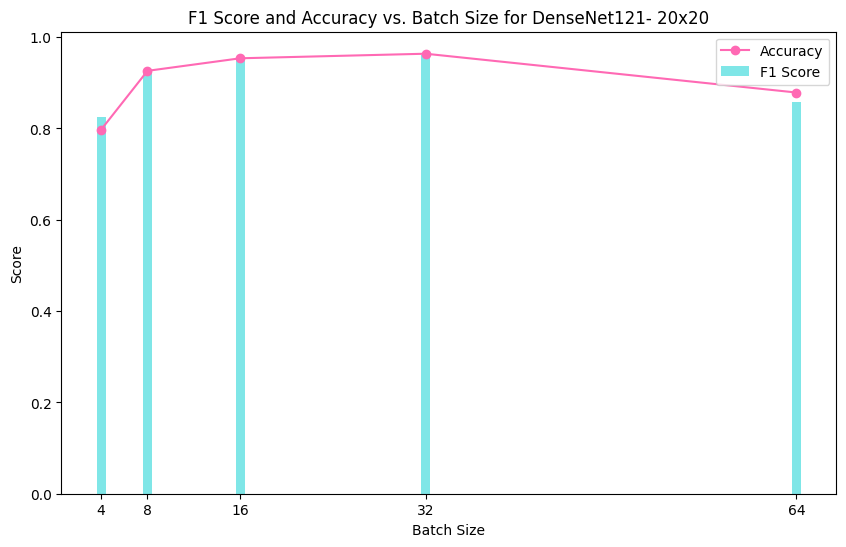

In [ ]:
results_densenet121_batch_size_20x20 = {
    4: {'accuracy': 0.7975, 'f1': 0.8262},
    8: {'accuracy': 0.92625, 'f1': 0.9285},
    16: {'accuracy': 0.95375, 'f1': 0.9524},
    32: {'accuracy': 0.96375, 'f1': 0.9611},
    64: {'accuracy': 0.87875, 'f1': 0.8571}
}

plot_metrics_vs_batchsize(results_densenet121_batch_size_20x20, 'DenseNet121- 20x20')

## **Learning Rate Exploration**


In [ ]:
def plot_metrics_vs_lr(results_lr, permutation_type):
    # Extract F1 scores and Accuracy from results dictionary
    f1_scores = [results_lr[lr]['f1'] for lr in [0.1, 0.01, 0.001, 0.0001]]
    accuracies = [results_lr[lr]['accuracy'] for lr in [0.1, 0.01, 0.001, 0.0001]]

    # Learning rates for custom tick marks on x-axis
    lr_ticks = [0.1, 0.01, 0.001, 0.0001]
    lr_labels = ['0.1', '0.01', '0.001', '0.0001']

    # Plotting
    plt.figure(figsize=(10, 6))

    # Plot F1 scores
    plt.bar(lr_labels, f1_scores, color='#00CED1', alpha=0.5, label='F1 Score', width=0.4)

    # Plot Accuracy
    plt.plot(lr_labels, accuracies, color='#FF69B4', marker='o', label='Accuracy')

    # Adding labels and title
    plt.xlabel('Learning Rate')
    plt.ylabel('Score')
    plt.title(f'F1 Score and Accuracy vs. Learning Rate for {permutation_type}')
    plt.legend()

    plt.show()


## **Baseline**
### **GoogleNet**

In [ ]:
results_googlenet_lr = {}

for lr in [0.1,0.01,0.001,0.0001]:
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=lr)

    print(f"Training for {lr} Learning Rate...")
    train_model(googlenet, train_loader, criterion, optimizer, num_epochs=3)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader)

    results_googlenet_lr[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {lr} Learning Rate completed.")
    print("")
    print("")

Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.6522
Epoch 1/3, Iteration 100, Train Loss: 1.0609
Epoch 2/3, Iteration 1, Train Loss: 0.7064
Epoch 2/3, Iteration 100, Train Loss: 0.6335
Epoch 3/3, Iteration 1, Train Loss: 0.6831
Epoch 3/3, Iteration 100, Train Loss: 0.7313
Training completed.
Final Training Accuracy: 0.7076

Test Set Evaluation Metrics:
Accuracy: 0.8021739130434783
Precision: 0.741635687732342
Recall: 0.9027149321266968
F1 Score: 0.8142857142857142
Confusion Matrix:
[[339 139]
 [ 43 399]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7189
Epoch 1/3, Iteration 100, Train Loss: 0.0900
Epoch 2/3, Iteration 1, Train Loss: 0.2240
Epoch 2/3, Iteration 100, Train Loss: 0.5454
Epoch 3/3, Iteration 1, Train Loss: 0.3090
Epoch 3/3, Iteration 100, Train Loss: 0.0328
Training completed.
Final Training Accuracy: 0.9227

Test Set Evaluation Metrics:
Accuracy: 0.7467391304347826
Precision: 0.6552748885586924
Recall: 0.997737556561086
F1 Score: 0.7910313901345292
Confusion Matrix:
[[246 232]
 [  1 441]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6508
Epoch 1/3, Iteration 100, Train Loss: 0.1401
Epoch 2/3, Iteration 1, Train Loss: 0.0406
Epoch 2/3, Iteration 100, Train Loss: 0.0877
Epoch 3/3, Iteration 1, Train Loss: 0.0427
Epoch 3/3, Iteration 100, Train Loss: 0.0075
Training completed.
Final Training Accuracy: 0.9826

Test Set Evaluation Metrics:
Accuracy: 0.9782608695652174
Precision: 0.9795454545454545
Recall: 0.9751131221719457
F1 Score: 0.9773242630385487
Confusion Matrix:
[[469   9]
 [ 11 431]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7284
Epoch 1/3, Iteration 100, Train Loss: 0.0432
Epoch 2/3, Iteration 1, Train Loss: 0.0102
Epoch 2/3, Iteration 100, Train Loss: 0.0045
Epoch 3/3, Iteration 1, Train Loss: 0.0115
Epoch 3/3, Iteration 100, Train Loss: 0.0017
Training completed.
Final Training Accuracy: 0.9984

Test Set Evaluation Metrics:
Accuracy: 0.9945652173913043
Precision: 0.9977220956719818
Recall: 0.9909502262443439
F1 Score: 0.9943246311010215
Confusion Matrix:
[[477   1]
 [  4 438]]
Training for 0.0001 Learning Rate completed.




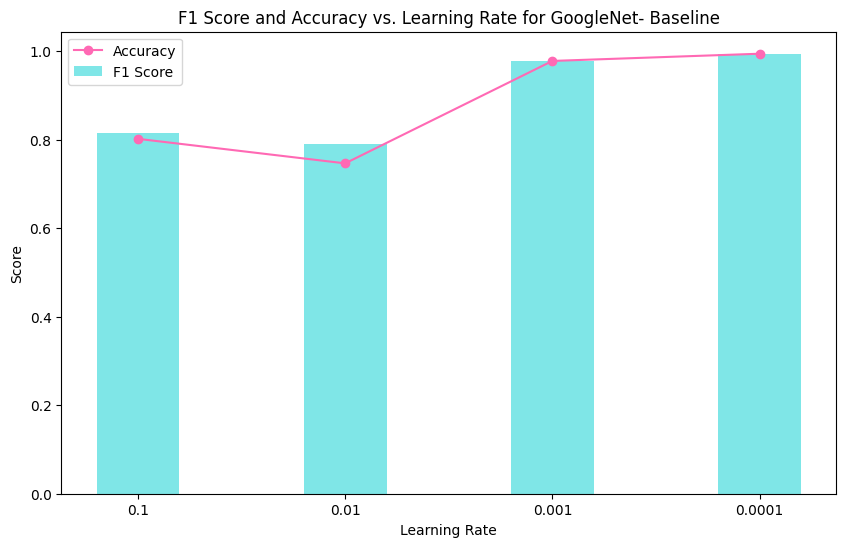

In [ ]:
results_googlenet_lr = {}

results_googlenet_lr[0.1] = {'accuracy': 0.8021739130434783, 'precision': 0.741635687732342, 'recall': 0.9027149321266968, 'f1': 0.8142857142857142}
results_googlenet_lr[0.01] = {'accuracy': 0.7467391304347826, 'precision': 0.6552748885586924, 'recall': 0.997737556561086, 'f1': 0.7910313901345292}
results_googlenet_lr[0.001] = {'accuracy': 0.9782608695652174, 'precision': 0.9795454545454545, 'recall': 0.9751131221719457, 'f1': 0.9773242630385487}
results_googlenet_lr[0.0001] = {'accuracy': 0.9945652173913043, 'precision': 0.9977220956719818, 'recall': 0.9909502262443439, 'f1': 0.9943246311010215}

plot_metrics_vs_lr(results_googlenet_lr,'GoogleNet- Baseline')

### **DenseNet**

In [ ]:
results_densenet121_lr = {}

for lr in [0.1,0.01,0.001,0.0001]:
  densenet121=densenet121_model()
  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=lr)

  print(f"Training for {lr} Learning Rate...")
  train_model(googlenet, train_loader, criterion, optimizer, num_epochs=3)

  accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader)

  results_densenet121_lr[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
  }
  print(f"Training for {lr} Learning Rate completed.")
  print("")
  print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.0023
Epoch 1/3, Iteration 100, Train Loss: 0.0023
Epoch 2/3, Iteration 1, Train Loss: 0.0009
Epoch 2/3, Iteration 100, Train Loss: 0.0009
Epoch 3/3, Iteration 1, Train Loss: 0.0010
Epoch 3/3, Iteration 100, Train Loss: 0.0011
Training completed.
Final Training Accuracy: 0.9997

Test Set Evaluation Metrics:
Accuracy: 0.9956521739130435
Precision: 0.9977272727272727
Recall: 0.9932126696832579
F1 Score: 0.9954648526077098
Confusion Matrix:
[[477   1]
 [  3 439]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0285
Epoch 1/3, Iteration 100, Train Loss: 0.0009
Epoch 2/3, Iteration 1, Train Loss: 0.0008
Epoch 2/3, Iteration 100, Train Loss: 0.0006
Epoch 3/3, Iteration 1, Train Loss: 0.0014
Epoch 3/3, Iteration 100, Train Loss: 0.0013
Training completed.
Final Training Accuracy: 0.9986

Test Set Evaluation Metrics:
Accuracy: 0.9945652173913043
Precision: 0.9977220956719818
Recall: 0.9909502262443439
F1 Score: 0.9943246311010215
Confusion Matrix:
[[477   1]
 [  4 438]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0008
Epoch 1/3, Iteration 100, Train Loss: 0.0033
Epoch 2/3, Iteration 1, Train Loss: 0.0029
Epoch 2/3, Iteration 100, Train Loss: 0.0011
Epoch 3/3, Iteration 1, Train Loss: 0.0016
Epoch 3/3, Iteration 100, Train Loss: 0.0131
Training completed.
Final Training Accuracy: 0.9992

Test Set Evaluation Metrics:
Accuracy: 0.9956521739130435
Precision: 0.9977272727272727
Recall: 0.9932126696832579
F1 Score: 0.9954648526077098
Confusion Matrix:
[[477   1]
 [  3 439]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0065
Epoch 1/3, Iteration 100, Train Loss: 0.0007
Epoch 2/3, Iteration 1, Train Loss: 0.0167
Epoch 2/3, Iteration 100, Train Loss: 0.0029
Epoch 3/3, Iteration 1, Train Loss: 0.0008
Epoch 3/3, Iteration 100, Train Loss: 0.0010
Training completed.
Final Training Accuracy: 0.9997

Test Set Evaluation Metrics:
Accuracy: 0.9956521739130435
Precision: 0.9977272727272727
Recall: 0.9932126696832579
F1 Score: 0.9954648526077098
Confusion Matrix:
[[477   1]
 [  3 439]]
Training for 0.0001 Learning Rate completed.




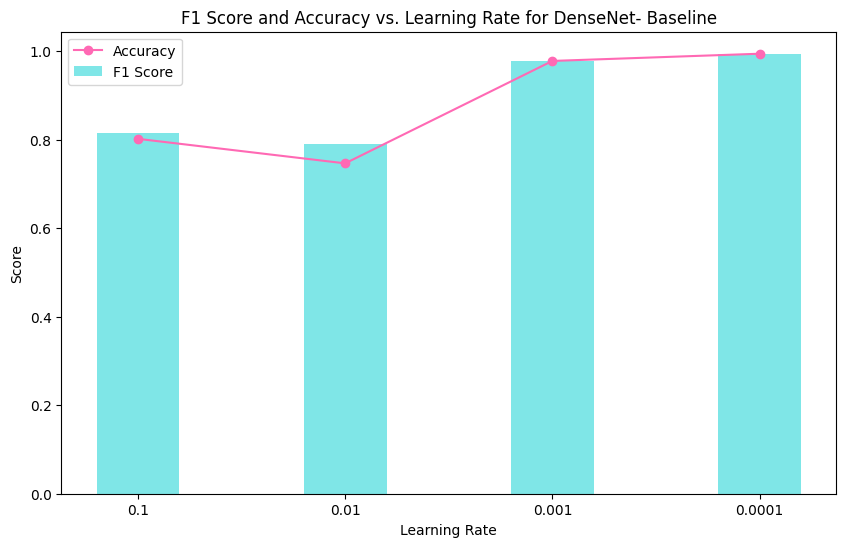

In [ ]:
results_densenet121_lr = {}
results_densenet121_lr[0.1] = {'accuracy': 0.9957, 'precision': 0.9977, 'recall': 0.9932, 'f1': 0.9955}
results_densenet121_lr[0.01] = {'accuracy': 0.9946, 'precision': 0.9977, 'recall': 0.9909, 'f1': 0.9943}
results_densenet121_lr[0.001] = {'accuracy': 0.9957, 'precision': 0.9977, 'recall': 0.9932, 'f1': 0.9955}
results_densenet121_lr[0.0001] = {'accuracy': 0.9957, 'precision': 0.9977, 'recall': 0.9932, 'f1': 0.9955}

plot_metrics_vs_lr(results_googlenet_lr,'DenseNet- Baseline')

## **2-Tile Permutations**
### **GoogleNet**

In [ ]:
results_googlenet_lr_2x2 = {}

for lr in [0.1,0.01,0.001,0.0001]:
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=lr)

    print(f"Training for {lr} Learning Rate...")
    train_model(googlenet, train_loader_2x2, criterion, optimizer, num_epochs=3)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_2x2)

    results_googlenet_lr_2x2[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {lr} Learning Rate completed.")
    print("")
    print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.7704
Epoch 1/3, Iteration 100, Train Loss: 6.1409
Epoch 1/3, Iteration 200, Train Loss: 1.4833
Epoch 2/3, Iteration 1, Train Loss: 0.6631
Epoch 2/3, Iteration 100, Train Loss: 0.8435
Epoch 2/3, Iteration 200, Train Loss: 0.6698
Epoch 3/3, Iteration 1, Train Loss: 0.9411
Epoch 3/3, Iteration 100, Train Loss: 0.5930
Epoch 3/3, Iteration 200, Train Loss: 0.2673
Training completed.
Final Training Accuracy: 0.6843

Test Set Evaluation Metrics:
Accuracy: 0.74125
Precision: 0.6555944055944056
Recall: 0.974025974025974
F1 Score: 0.7836990595611286
Confusion Matrix:
[[218 197]
 [ 10 375]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7451
Epoch 1/3, Iteration 100, Train Loss: 0.8051
Epoch 1/3, Iteration 200, Train Loss: 0.7695
Epoch 2/3, Iteration 1, Train Loss: 0.6642
Epoch 2/3, Iteration 100, Train Loss: 0.3213
Epoch 2/3, Iteration 200, Train Loss: 1.5136
Epoch 3/3, Iteration 1, Train Loss: 0.3496
Epoch 3/3, Iteration 100, Train Loss: 0.7811
Epoch 3/3, Iteration 200, Train Loss: 0.1988
Training completed.
Final Training Accuracy: 0.8733

Test Set Evaluation Metrics:
Accuracy: 0.8475
Precision: 0.7864923747276689
Recall: 0.9376623376623376
F1 Score: 0.8554502369668247
Confusion Matrix:
[[317  98]
 [ 24 361]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6088
Epoch 1/3, Iteration 100, Train Loss: 0.1025
Epoch 1/3, Iteration 200, Train Loss: 0.0636
Epoch 2/3, Iteration 1, Train Loss: 0.0912
Epoch 2/3, Iteration 100, Train Loss: 0.0213
Epoch 2/3, Iteration 200, Train Loss: 0.0425
Epoch 3/3, Iteration 1, Train Loss: 0.0746
Epoch 3/3, Iteration 100, Train Loss: 0.0268
Epoch 3/3, Iteration 200, Train Loss: 0.2544
Training completed.
Final Training Accuracy: 0.9706

Test Set Evaluation Metrics:
Accuracy: 0.96375
Precision: 0.9759358288770054
Recall: 0.948051948051948
F1 Score: 0.9617918313570487
Confusion Matrix:
[[406   9]
 [ 20 365]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6994
Epoch 1/3, Iteration 100, Train Loss: 0.0610
Epoch 1/3, Iteration 200, Train Loss: 0.0574
Epoch 2/3, Iteration 1, Train Loss: 0.0071
Epoch 2/3, Iteration 100, Train Loss: 0.0397
Epoch 2/3, Iteration 200, Train Loss: 0.0901
Epoch 3/3, Iteration 1, Train Loss: 0.0019
Epoch 3/3, Iteration 100, Train Loss: 0.0018
Epoch 3/3, Iteration 200, Train Loss: 0.0012
Training completed.
Final Training Accuracy: 0.9972

Test Set Evaluation Metrics:
Accuracy: 0.985
Precision: 0.9869451697127938
Recall: 0.9818181818181818
F1 Score: 0.9843750000000001
Confusion Matrix:
[[410   5]
 [  7 378]]
Training for 0.0001 Learning Rate completed.




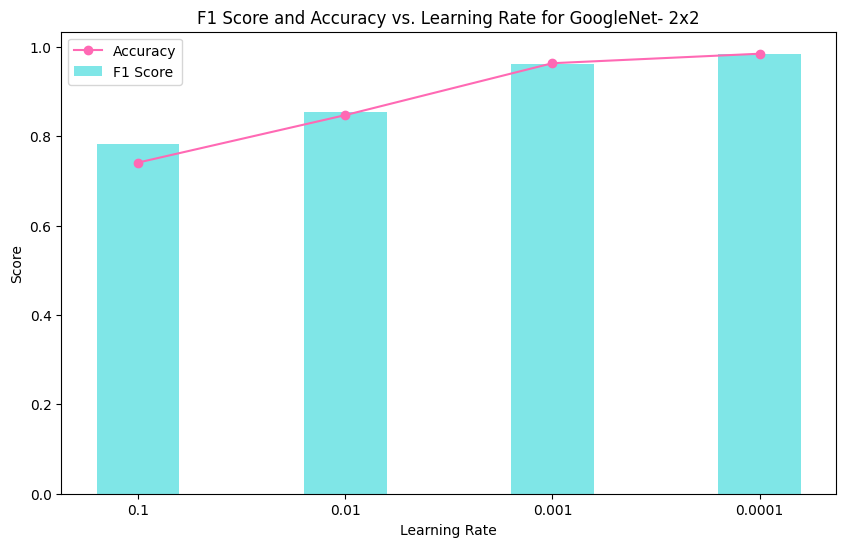

In [ ]:
results_googlenet_lr_2x2 = {}
results_googlenet_lr_2x2[0.1] = {'accuracy': 0.74125, 'precision': 0.6555944055944056, 'recall': 0.974025974025974, 'f1': 0.7836990595611286}
results_googlenet_lr_2x2[0.01] = {'accuracy': 0.8475, 'precision': 0.7864923747276689, 'recall': 0.9376623376623376, 'f1': 0.8554502369668247}
results_googlenet_lr_2x2[0.001] = {'accuracy': 0.96375, 'precision': 0.9759358288770054, 'recall': 0.948051948051948, 'f1': 0.9617918313570487}
results_googlenet_lr_2x2[0.0001] = {'accuracy': 0.985, 'precision': 0.9869451697127938, 'recall': 0.9818181818181818, 'f1': 0.9843750000000001}

plot_metrics_vs_lr(results_googlenet_lr_2x2,'GoogleNet- 2x2')

### **DenseNet**

In [ ]:
results_densenet121_lr_2x2 = {}

for lr in [0.1,0.01,0.001,0.0001]:
  densenet121=densenet121_model()
  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=lr)

  print(f"Training for {lr} Learning Rate...")
  train_model(googlenet, train_loader_2x2, criterion, optimizer, num_epochs=3)

  accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_2x2)

  results_densenet121_lr_2x2[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
  }
  print(f"Training for {lr} Learning Rate completed.")
  print("")
  print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.0006
Epoch 1/3, Iteration 100, Train Loss: 0.0009
Epoch 1/3, Iteration 200, Train Loss: 0.2907
Epoch 2/3, Iteration 1, Train Loss: 0.0018
Epoch 2/3, Iteration 100, Train Loss: 0.0009
Epoch 2/3, Iteration 200, Train Loss: 0.0044
Epoch 3/3, Iteration 1, Train Loss: 0.0035
Epoch 3/3, Iteration 100, Train Loss: 0.0009
Epoch 3/3, Iteration 200, Train Loss: 0.0007
Training completed.
Final Training Accuracy: 0.9981

Test Set Evaluation Metrics:
Accuracy: 0.98625
Precision: 0.9869791666666666
Recall: 0.9844155844155844
F1 Score: 0.9856957087126137
Confusion Matrix:
[[410   5]
 [  6 379]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0059
Epoch 1/3, Iteration 100, Train Loss: 0.0020
Epoch 1/3, Iteration 200, Train Loss: 0.0007
Epoch 2/3, Iteration 1, Train Loss: 0.0005
Epoch 2/3, Iteration 100, Train Loss: 0.0098
Epoch 2/3, Iteration 200, Train Loss: 0.0010
Epoch 3/3, Iteration 1, Train Loss: 0.0061
Epoch 3/3, Iteration 100, Train Loss: 0.0011
Epoch 3/3, Iteration 200, Train Loss: 0.0004
Training completed.
Final Training Accuracy: 0.9984

Test Set Evaluation Metrics:
Accuracy: 0.98625
Precision: 0.9895287958115183
Recall: 0.9818181818181818
F1 Score: 0.985658409387223
Confusion Matrix:
[[411   4]
 [  7 378]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0029
Epoch 1/3, Iteration 100, Train Loss: 0.0022
Epoch 1/3, Iteration 200, Train Loss: 0.0158
Epoch 2/3, Iteration 1, Train Loss: 0.0016
Epoch 2/3, Iteration 100, Train Loss: 0.0004
Epoch 2/3, Iteration 200, Train Loss: 0.0006
Epoch 3/3, Iteration 1, Train Loss: 0.0043
Epoch 3/3, Iteration 100, Train Loss: 0.0018
Epoch 3/3, Iteration 200, Train Loss: 0.0099
Training completed.
Final Training Accuracy: 0.9962

Test Set Evaluation Metrics:
Accuracy: 0.98625
Precision: 0.9895287958115183
Recall: 0.9818181818181818
F1 Score: 0.985658409387223
Confusion Matrix:
[[411   4]
 [  7 378]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0069
Epoch 1/3, Iteration 100, Train Loss: 0.0004
Epoch 1/3, Iteration 200, Train Loss: 0.0106
Epoch 2/3, Iteration 1, Train Loss: 0.0019
Epoch 2/3, Iteration 100, Train Loss: 0.0015
Epoch 2/3, Iteration 200, Train Loss: 0.0006
Epoch 3/3, Iteration 1, Train Loss: 0.0145
Epoch 3/3, Iteration 100, Train Loss: 0.0046
Epoch 3/3, Iteration 200, Train Loss: 0.0243
Training completed.
Final Training Accuracy: 0.9981

Test Set Evaluation Metrics:
Accuracy: 0.985
Precision: 0.9869451697127938
Recall: 0.9818181818181818
F1 Score: 0.9843750000000001
Confusion Matrix:
[[410   5]
 [  7 378]]
Training for 0.0001 Learning Rate completed.




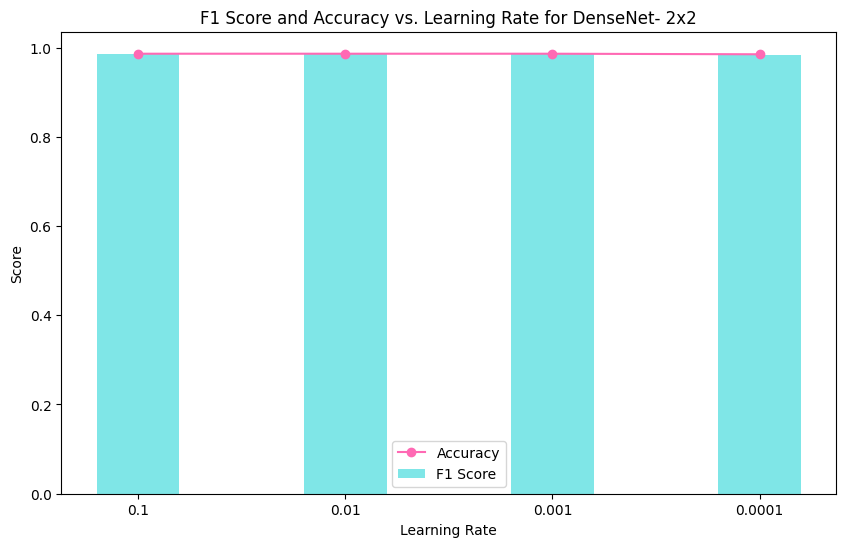

In [ ]:
results_densenet121_lr_2x2 = {}
results_densenet121_lr_2x2[0.1] = {'accuracy': 0.98625, 'precision': 0.9869791666666666, 'recall': 0.9844155844155844, 'f1': 0.9856957087126137}
results_densenet121_lr_2x2[0.01] = {'accuracy': 0.98625, 'precision': 0.9895287958115183, 'recall': 0.9818181818181818, 'f1': 0.985658409387223}
results_densenet121_lr_2x2[0.001] = {'accuracy': 0.98625, 'precision': 0.9895287958115183, 'recall': 0.9818181818181818, 'f1': 0.985658409387223}
results_densenet121_lr_2x2[0.0001] = {'accuracy': 0.985, 'precision': 0.9869451697127938, 'recall': 0.9818181818181818, 'f1': 0.9843750000000001}

plot_metrics_vs_lr(results_densenet121_lr_2x2,'DenseNet- 2x2')

## **3-Tile Permutations**
### **GoogleNet**

In [ ]:
results_googlenet_lr_3x3 = {}

for lr in [0.1,0.01,0.001,0.0001]:
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=lr)

    print(f"Training for {lr} Learning Rate...")
    train_model(googlenet, train_loader_3x3, criterion, optimizer, num_epochs=3)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_3x3)

    results_googlenet_lr_3x3[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {lr} Learning Rate completed.")
    print("")
    print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.8052
Epoch 1/3, Iteration 100, Train Loss: 0.7476
Epoch 1/3, Iteration 200, Train Loss: 0.7132
Epoch 2/3, Iteration 1, Train Loss: 0.6662
Epoch 2/3, Iteration 100, Train Loss: 0.7046
Epoch 2/3, Iteration 200, Train Loss: 0.6967
Epoch 3/3, Iteration 1, Train Loss: 0.6932
Epoch 3/3, Iteration 100, Train Loss: 0.7703
Epoch 3/3, Iteration 200, Train Loss: 0.6976
Training completed.
Final Training Accuracy: 0.5228

Test Set Evaluation Metrics:
Accuracy: 0.6
Precision: 0.5736961451247166
Recall: 0.6571428571428571
F1 Score: 0.612590799031477
Confusion Matrix:
[[227 188]
 [132 253]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7824
Epoch 1/3, Iteration 100, Train Loss: 0.7325
Epoch 1/3, Iteration 200, Train Loss: 0.6619
Epoch 2/3, Iteration 1, Train Loss: 0.6811
Epoch 2/3, Iteration 100, Train Loss: 0.7201
Epoch 2/3, Iteration 200, Train Loss: 0.1068
Epoch 3/3, Iteration 1, Train Loss: 0.7883
Epoch 3/3, Iteration 100, Train Loss: 0.2361
Epoch 3/3, Iteration 200, Train Loss: 0.3330
Training completed.
Final Training Accuracy: 0.8742

Test Set Evaluation Metrics:
Accuracy: 0.50625
Precision: 0.4935897435897436
Recall: 1.0
F1 Score: 0.6609442060085837
Confusion Matrix:
[[ 20 395]
 [  0 385]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6449
Epoch 1/3, Iteration 100, Train Loss: 0.1577
Epoch 1/3, Iteration 200, Train Loss: 0.0894
Epoch 2/3, Iteration 1, Train Loss: 0.1172
Epoch 2/3, Iteration 100, Train Loss: 0.0203
Epoch 2/3, Iteration 200, Train Loss: 0.0325
Epoch 3/3, Iteration 1, Train Loss: 0.0388
Epoch 3/3, Iteration 100, Train Loss: 0.1887
Epoch 3/3, Iteration 200, Train Loss: 0.0606
Training completed.
Final Training Accuracy: 0.9528

Test Set Evaluation Metrics:
Accuracy: 0.94
Precision: 0.9941348973607038
Recall: 0.8805194805194805
F1 Score: 0.933884297520661
Confusion Matrix:
[[413   2]
 [ 46 339]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7266
Epoch 1/3, Iteration 100, Train Loss: 0.2505
Epoch 1/3, Iteration 200, Train Loss: 0.0099
Epoch 2/3, Iteration 1, Train Loss: 0.0200
Epoch 2/3, Iteration 100, Train Loss: 0.0034
Epoch 2/3, Iteration 200, Train Loss: 0.0123
Epoch 3/3, Iteration 1, Train Loss: 0.0055
Epoch 3/3, Iteration 100, Train Loss: 0.0088
Epoch 3/3, Iteration 200, Train Loss: 0.0016
Training completed.
Final Training Accuracy: 0.9934

Test Set Evaluation Metrics:
Accuracy: 0.985
Precision: 0.9869451697127938
Recall: 0.9818181818181818
F1 Score: 0.9843750000000001
Confusion Matrix:
[[410   5]
 [  7 378]]
Training for 0.0001 Learning Rate completed.




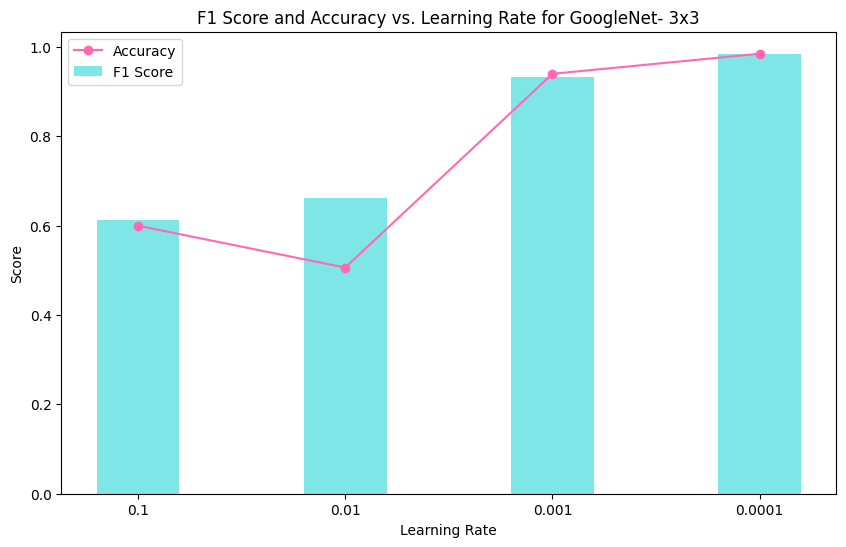

In [ ]:
results_googlenet_lr_3x3 = {}
results_googlenet_lr_3x3[0.1] = {'accuracy': 0.6, 'precision': 0.5737, 'recall': 0.6571, 'f1': 0.6126}
results_googlenet_lr_3x3[0.01] = {'accuracy': 0.50625, 'precision': 0.4936, 'recall': 1.0, 'f1': 0.6609}
results_googlenet_lr_3x3[0.001] = {'accuracy': 0.94, 'precision': 0.9941, 'recall': 0.8805, 'f1': 0.9339}
results_googlenet_lr_3x3[0.0001] = {'accuracy': 0.985, 'precision': 0.9869, 'recall': 0.9818, 'f1': 0.9844}

plot_metrics_vs_lr(results_googlenet_lr_3x3,'GoogleNet- 3x3')

### **DenseNet**

In [ ]:
results_densenet121_lr_3x3 = {}

for lr in [0.1,0.01,0.001,0.0001]:
  densenet121=densenet121_model()
  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=lr)

  print(f"Training for {lr} Learning Rate...")
  train_model(googlenet, train_loader_3x3, criterion, optimizer, num_epochs=3)

  accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_3x3)

  results_densenet121_lr_3x3[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
  }
  print(f"Training for {lr} Learning Rate completed.")
  print("")
  print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.0089
Epoch 1/3, Iteration 100, Train Loss: 0.0043
Epoch 1/3, Iteration 200, Train Loss: 0.0158
Epoch 2/3, Iteration 1, Train Loss: 0.0499
Epoch 2/3, Iteration 100, Train Loss: 0.0075
Epoch 2/3, Iteration 200, Train Loss: 0.0091
Epoch 3/3, Iteration 1, Train Loss: 0.0029
Epoch 3/3, Iteration 100, Train Loss: 0.0054
Epoch 3/3, Iteration 200, Train Loss: 0.0009
Training completed.
Final Training Accuracy: 0.9969

Test Set Evaluation Metrics:
Accuracy: 0.98875
Precision: 0.9870466321243523
Recall: 0.9896103896103896
F1 Score: 0.9883268482490273
Confusion Matrix:
[[410   5]
 [  4 381]]
Training for 0.1 Learning Rate completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.01 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.0059
Epoch 1/3, Iteration 100, Train Loss: 0.0113
Epoch 1/3, Iteration 200, Train Loss: 0.0035
Epoch 2/3, Iteration 1, Train Loss: 0.0466
Epoch 2/3, Iteration 100, Train Loss: 0.1078
Epoch 2/3, Iteration 200, Train Loss: 0.1808
Epoch 3/3, Iteration 1, Train Loss: 0.0014
Epoch 3/3, Iteration 100, Train Loss: 0.0018
Epoch 3/3, Iteration 200, Train Loss: 0.0023
Training completed.
Final Training Accuracy: 0.9959

Test Set Evaluation Metrics:
Accuracy: 0.98875
Precision: 0.9870466321243523
Recall: 0.9896103896103896
F1 Score: 0.9883268482490273
Confusion Matrix:
[[410   5]
 [  4 381]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0047
Epoch 1/3, Iteration 100, Train Loss: 0.0107
Epoch 1/3, Iteration 200, Train Loss: 0.0171
Epoch 2/3, Iteration 1, Train Loss: 0.0027
Epoch 2/3, Iteration 100, Train Loss: 0.0035
Epoch 2/3, Iteration 200, Train Loss: 0.0093
Epoch 3/3, Iteration 1, Train Loss: 0.0036
Epoch 3/3, Iteration 100, Train Loss: 0.0288
Epoch 3/3, Iteration 200, Train Loss: 0.0013
Training completed.
Final Training Accuracy: 0.9969

Test Set Evaluation Metrics:
Accuracy: 0.9875
Precision: 0.987012987012987
Recall: 0.987012987012987
F1 Score: 0.987012987012987
Confusion Matrix:
[[410   5]
 [  5 380]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0020
Epoch 1/3, Iteration 100, Train Loss: 0.0518
Epoch 1/3, Iteration 200, Train Loss: 0.0071
Epoch 2/3, Iteration 1, Train Loss: 0.0027
Epoch 2/3, Iteration 100, Train Loss: 0.0053
Epoch 2/3, Iteration 200, Train Loss: 0.0696
Epoch 3/3, Iteration 1, Train Loss: 0.0031
Epoch 3/3, Iteration 100, Train Loss: 0.0022
Epoch 3/3, Iteration 200, Train Loss: 0.1134
Training completed.
Final Training Accuracy: 0.9966

Test Set Evaluation Metrics:
Accuracy: 0.98875
Precision: 0.9870466321243523
Recall: 0.9896103896103896
F1 Score: 0.9883268482490273
Confusion Matrix:
[[410   5]
 [  4 381]]
Training for 0.0001 Learning Rate completed.




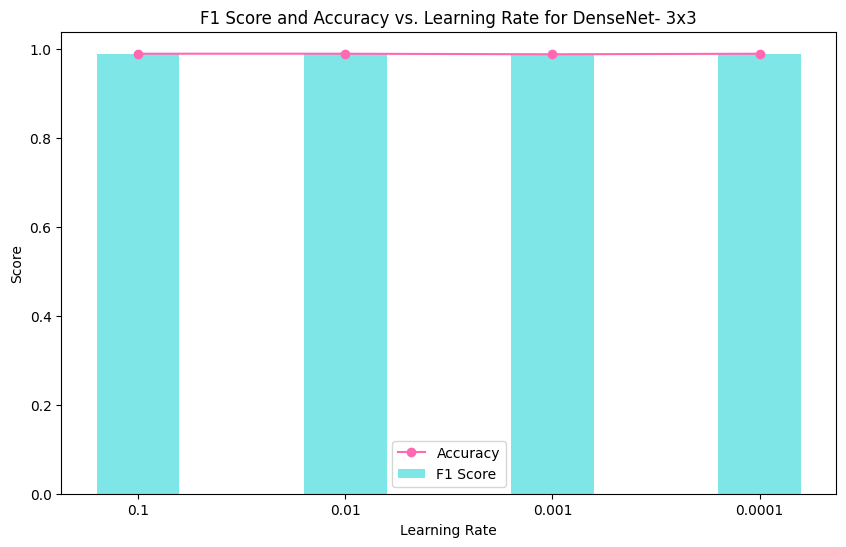

In [ ]:
results_densenet121_lr_3x3 = {}
results_densenet121_lr_3x3[0.1] = {'accuracy': 0.98875, 'precision': 0.9870, 'recall': 0.9896, 'f1': 0.9883}
results_densenet121_lr_3x3[0.01] = {'accuracy': 0.98875, 'precision': 0.9870, 'recall': 0.9896, 'f1': 0.9883}
results_densenet121_lr_3x3[0.001] = {'accuracy': 0.9875, 'precision': 0.9870, 'recall': 0.9870, 'f1': 0.9870}
results_densenet121_lr_3x3[0.0001] = {'accuracy': 0.98875, 'precision': 0.9870, 'recall': 0.9896, 'f1': 0.9883}

plot_metrics_vs_lr(results_densenet121_lr_3x3,'DenseNet- 3x3')

## **4-Tile Permutations**
### **GoogleNet**

In [ ]:
results_googlenet_lr_4x4 = {}

for lr in [0.1,0.01,0.001,0.0001]:
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=lr)

    print(f"Training for {lr} Learning Rate...")
    train_model(googlenet, train_loader_4x4, criterion, optimizer, num_epochs=3)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_4x4)

    results_googlenet_lr_4x4[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {lr} Learning Rate completed.")
    print("")
    print("")

Training for 0.1 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6693
Epoch 1/3, Iteration 100, Train Loss: 1.7623
Epoch 2/3, Iteration 1, Train Loss: 0.6512
Epoch 2/3, Iteration 100, Train Loss: 0.7317
Epoch 3/3, Iteration 1, Train Loss: 0.7003
Epoch 3/3, Iteration 100, Train Loss: 0.7475
Training completed.
Final Training Accuracy: 0.5365

Test Set Evaluation Metrics:
Accuracy: 0.48478260869565215
Precision: 0.48253275109170307
Recall: 1.0
F1 Score: 0.6509572901325479
Confusion Matrix:
[[  4 474]
 [  0 442]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6683
Epoch 1/3, Iteration 100, Train Loss: 0.7933
Epoch 2/3, Iteration 1, Train Loss: 0.8201
Epoch 2/3, Iteration 100, Train Loss: 0.8454
Epoch 3/3, Iteration 1, Train Loss: 0.8113
Epoch 3/3, Iteration 100, Train Loss: 0.8281
Training completed.
Final Training Accuracy: 0.5272

Test Set Evaluation Metrics:
Accuracy: 0.5815217391304348
Precision: 0.5821325648414986
Recall: 0.45701357466063347
F1 Score: 0.5120405576679341
Confusion Matrix:
[[333 145]
 [240 202]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7679
Epoch 1/3, Iteration 100, Train Loss: 0.0840
Epoch 2/3, Iteration 1, Train Loss: 0.3014
Epoch 2/3, Iteration 100, Train Loss: 0.0510
Epoch 3/3, Iteration 1, Train Loss: 0.2624
Epoch 3/3, Iteration 100, Train Loss: 0.0668
Training completed.
Final Training Accuracy: 0.9752

Test Set Evaluation Metrics:
Accuracy: 0.9478260869565217
Precision: 0.9397321428571429
Recall: 0.9524886877828054
F1 Score: 0.946067415730337
Confusion Matrix:
[[451  27]
 [ 21 421]]
Training for 0.001 Learning Rate completed.




/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.0001 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.7139
Epoch 1/3, Iteration 100, Train Loss: 0.0377
Epoch 2/3, Iteration 1, Train Loss: 0.0164
Epoch 2/3, Iteration 100, Train Loss: 0.0060
Epoch 3/3, Iteration 1, Train Loss: 0.0260
Epoch 3/3, Iteration 100, Train Loss: 0.0035
Training completed.
Final Training Accuracy: 0.9967

Test Set Evaluation Metrics:
Accuracy: 0.9826086956521739
Precision: 0.9819004524886877
Recall: 0.9819004524886877
F1 Score: 0.9819004524886877
Confusion Matrix:
[[470   8]
 [  8 434]]
Training for 0.0001 Learning Rate completed.




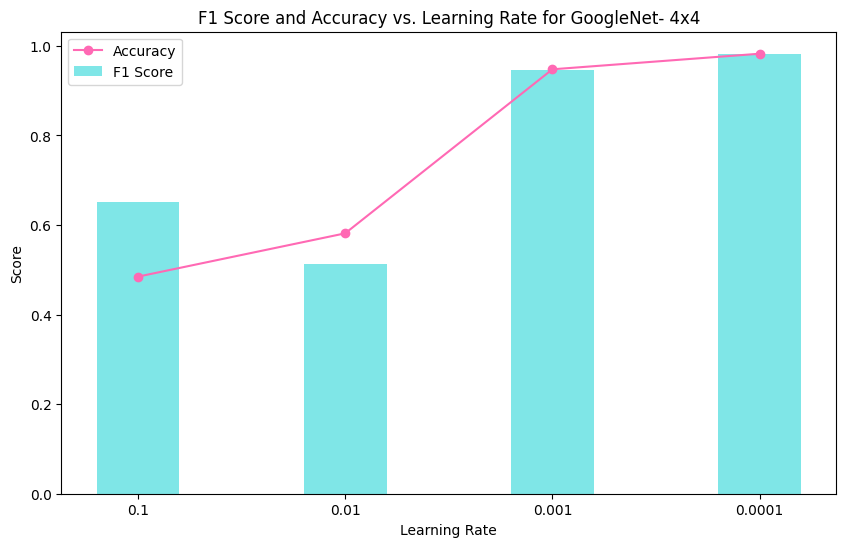

In [ ]:
results_googlenet_lr_4x4 = {}
results_googlenet_lr_4x4[0.1] = {'accuracy': 0.4848, 'precision': 0.4825, 'recall': 1.0, 'f1': 0.6510}
results_googlenet_lr_4x4[0.01] = {'accuracy': 0.5815, 'precision': 0.5821, 'recall': 0.4570, 'f1': 0.5120}
results_googlenet_lr_4x4[0.001] = {'accuracy': 0.9478, 'precision': 0.9397, 'recall': 0.9525, 'f1': 0.9461}
results_googlenet_lr_4x4[0.0001] = {'accuracy': 0.9826, 'precision': 0.9819, 'recall': 0.9819, 'f1': 0.9819}

plot_metrics_vs_lr(results_googlenet_lr_4x4,'GoogleNet- 4x4')

### **DenseNet**

In [ ]:
results_densenet121_lr_4x4 = {}

for lr in [0.1,0.01,0.001,0.0001]:
  densenet121=densenet121_model()
  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=lr)

  print(f"Training for {lr} Learning Rate...")
  train_model(googlenet, train_loader_4x4, criterion, optimizer, num_epochs=3)

  accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_4x4)

  results_densenet121_lr_4x4[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
  }
  print(f"Training for {lr} Learning Rate completed.")
  print("")
  print("")

Training for 0.1 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0023
Epoch 1/3, Iteration 100, Train Loss: 0.0042
Epoch 2/3, Iteration 1, Train Loss: 0.0018
Epoch 2/3, Iteration 100, Train Loss: 0.0016
Epoch 3/3, Iteration 1, Train Loss: 0.0032
Epoch 3/3, Iteration 100, Train Loss: 0.0044
Training completed.
Final Training Accuracy: 0.9970

Test Set Evaluation Metrics:
Accuracy: 0.9815217391304348
Precision: 0.9711751662971175
Recall: 0.9909502262443439
F1 Score: 0.9809630459126539
Confusion Matrix:
[[465  13]
 [  4 438]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0014
Epoch 1/3, Iteration 100, Train Loss: 0.0067
Epoch 2/3, Iteration 1, Train Loss: 0.0195
Epoch 2/3, Iteration 100, Train Loss: 0.0047
Epoch 3/3, Iteration 1, Train Loss: 0.0631
Epoch 3/3, Iteration 100, Train Loss: 0.0012
Training completed.
Final Training Accuracy: 0.9981

Test Set Evaluation Metrics:
Accuracy: 0.9826086956521739
Precision: 0.9819004524886877
Recall: 0.9819004524886877
F1 Score: 0.9819004524886877
Confusion Matrix:
[[470   8]
 [  8 434]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0106
Epoch 1/3, Iteration 100, Train Loss: 0.0032
Epoch 2/3, Iteration 1, Train Loss: 0.0058
Epoch 2/3, Iteration 100, Train Loss: 0.0288
Epoch 3/3, Iteration 1, Train Loss: 0.0090
Epoch 3/3, Iteration 100, Train Loss: 0.0020
Training completed.
Final Training Accuracy: 0.9970

Test Set Evaluation Metrics:
Accuracy: 0.9815217391304348
Precision: 0.981859410430839
Recall: 0.9796380090497737
F1 Score: 0.9807474518686297
Confusion Matrix:
[[470   8]
 [  9 433]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0045
Epoch 1/3, Iteration 100, Train Loss: 0.0413
Epoch 2/3, Iteration 1, Train Loss: 0.0075
Epoch 2/3, Iteration 100, Train Loss: 0.0043
Epoch 3/3, Iteration 1, Train Loss: 0.0145
Epoch 3/3, Iteration 100, Train Loss: 0.0132
Training completed.
Final Training Accuracy: 0.9978

Test Set Evaluation Metrics:
Accuracy: 0.9826086956521739
Precision: 0.9797297297297297
Recall: 0.9841628959276018
F1 Score: 0.9819413092550789
Confusion Matrix:
[[469   9]
 [  7 435]]
Training for 0.0001 Learning Rate completed.




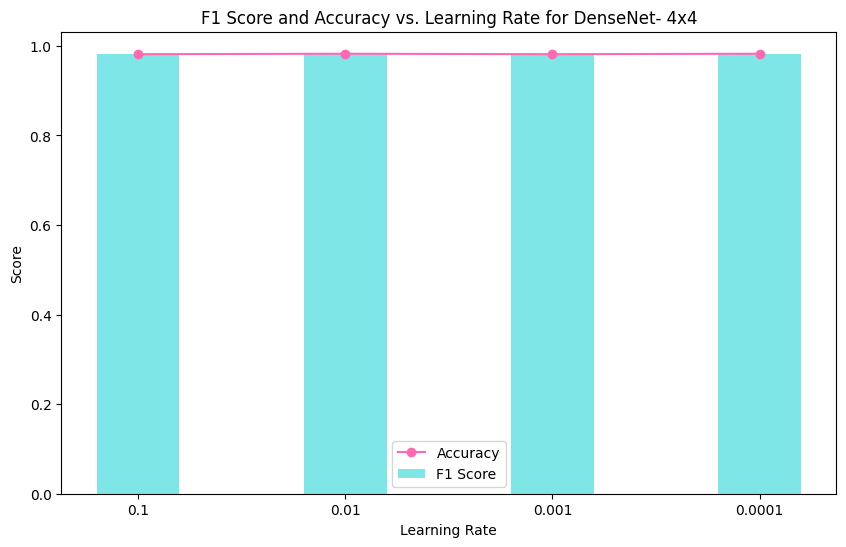

In [ ]:
results_densenet121_lr_4x4 = {}
results_densenet121_lr_4x4[0.1] = {'accuracy': 0.9815, 'precision': 0.9712, 'recall': 0.9909, 'f1': 0.9810}
results_densenet121_lr_4x4[0.01] = {'accuracy': 0.9826, 'precision': 0.9819, 'recall': 0.9819, 'f1': 0.9819}
results_densenet121_lr_4x4[0.001] = {'accuracy': 0.9815, 'precision': 0.9819, 'recall': 0.9796, 'f1': 0.9807}
results_densenet121_lr_4x4[0.0001] = {'accuracy': 0.9826, 'precision': 0.9797, 'recall': 0.9842, 'f1': 0.9819}

plot_metrics_vs_lr(results_densenet121_lr_4x4,'DenseNet- 4x4')

## **20-Tile Permutations**
### **GoogleNet**

In [ ]:
results_googlenet_lr_20x20 = {}

for lr in [0.1,0.01,0.001,0.0001]:
    googlenet=googlenet_model()
    criterion = nn.CrossEntropyLoss()
    optimizer = Adam(googlenet.parameters(), lr=lr)

    print(f"Training for {lr} Learning Rate...")
    train_model(googlenet, train_loader_20x20, criterion, optimizer, num_epochs=3)

    accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_20x20)

    results_googlenet_lr_20x20[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
    }
    print(f"Training for {lr} Learning Rate completed.")
    print("")
    print("")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Training for 0.1 Learning Rate...
Epoch 1/3, Iteration 1, Train Loss: 0.7227
Epoch 1/3, Iteration 100, Train Loss: 3.3319
Epoch 1/3, Iteration 200, Train Loss: 1.0060
Epoch 2/3, Iteration 1, Train Loss: 0.6323
Epoch 2/3, Iteration 100, Train Loss: 0.7061
Epoch 2/3, Iteration 200, Train Loss: 0.7172
Epoch 3/3, Iteration 1, Train Loss: 0.6996
Epoch 3/3, Iteration 100, Train Loss: 0.6936
Epoch 3/3, Iteration 200, Train Loss: 0.6720
Training completed.
Final Training Accuracy: 0.5113

Test Set Evaluation Metrics:
Accuracy: 0.48125
Precision: 0.48125
Recall: 1.0
F1 Score: 0.649789029535865
Confusion Matrix:
[[  0 415]
 [  0 385]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7692
Epoch 1/3, Iteration 100, Train Loss: 0.6313
Epoch 1/3, Iteration 200, Train Loss: 0.9499
Epoch 2/3, Iteration 1, Train Loss: 0.7151
Epoch 2/3, Iteration 100, Train Loss: 0.7562
Epoch 2/3, Iteration 200, Train Loss: 0.6905
Epoch 3/3, Iteration 1, Train Loss: 0.7266
Epoch 3/3, Iteration 100, Train Loss: 0.6795
Epoch 3/3, Iteration 200, Train Loss: 0.6707
Training completed.
Final Training Accuracy: 0.5084

Test Set Evaluation Metrics:
Accuracy: 0.55
Precision: 0.5239923224568138
Recall: 0.7090909090909091
F1 Score: 0.6026490066225165
Confusion Matrix:
[[167 248]
 [112 273]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6512
Epoch 1/3, Iteration 100, Train Loss: 0.3917
Epoch 1/3, Iteration 200, Train Loss: 0.2223
Epoch 2/3, Iteration 1, Train Loss: 0.1861
Epoch 2/3, Iteration 100, Train Loss: 0.3084
Epoch 2/3, Iteration 200, Train Loss: 0.1360
Epoch 3/3, Iteration 1, Train Loss: 0.2532
Epoch 3/3, Iteration 100, Train Loss: 0.2606
Epoch 3/3, Iteration 200, Train Loss: 0.0569
Training completed.
Final Training Accuracy: 0.8971

Test Set Evaluation Metrics:
Accuracy: 0.7675
Precision: 0.6754850088183422
Recall: 0.9948051948051948
F1 Score: 0.8046218487394958
Confusion Matrix:
[[231 184]
 [  2 383]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7286
Epoch 1/3, Iteration 100, Train Loss: 0.3394
Epoch 1/3, Iteration 200, Train Loss: 0.4075
Epoch 2/3, Iteration 1, Train Loss: 0.1050
Epoch 2/3, Iteration 100, Train Loss: 0.4291
Epoch 2/3, Iteration 200, Train Loss: 0.4062
Epoch 3/3, Iteration 1, Train Loss: 0.0902
Epoch 3/3, Iteration 100, Train Loss: 0.0205
Epoch 3/3, Iteration 200, Train Loss: 0.0800
Training completed.
Final Training Accuracy: 0.9615

Test Set Evaluation Metrics:
Accuracy: 0.9
Precision: 0.8692493946731235
Recall: 0.9324675324675324
F1 Score: 0.899749373433584
Confusion Matrix:
[[361  54]
 [ 26 359]]
Training for 0.0001 Learning Rate completed.




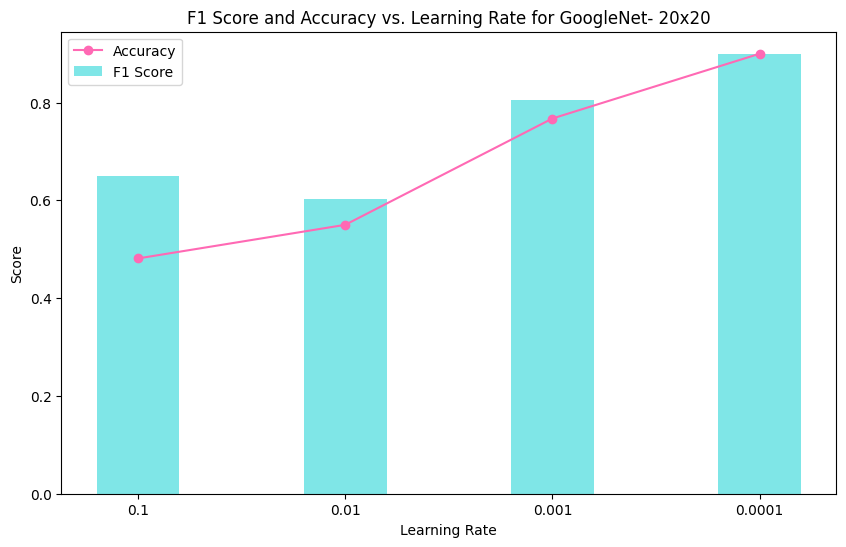

In [ ]:
results_googlenet_lr_20x20 = {}
results_googlenet_lr_20x20[0.1] = {'accuracy': 0.48125, 'precision': 0.48125, 'recall': 1.0, 'f1': 0.6498}
results_googlenet_lr_20x20[0.01] = {'accuracy': 0.55, 'precision': 0.5240, 'recall': 0.7091, 'f1': 0.6026}
results_googlenet_lr_20x20[0.001] = {'accuracy': 0.7675, 'precision': 0.6755, 'recall': 0.9948, 'f1': 0.8046}
results_googlenet_lr_20x20[0.0001] = {'accuracy': 0.9, 'precision': 0.8692, 'recall': 0.9325, 'f1': 0.8997}

plot_metrics_vs_lr(results_googlenet_lr_20x20,'GoogleNet- 20x20')

### **DenseNet**

In [ ]:
results_densenet121_lr_20x20 = {}

for lr in [0.1,0.01,0.001,0.0001]:
  densenet121=densenet121_model()
  criterion = nn.CrossEntropyLoss()
  optimizer = Adam(densenet121.parameters(), lr=lr)

  print(f"Training for {lr} Learning Rate...")
  train_model(googlenet, train_loader_20x20, criterion, optimizer, num_epochs=3)

  accuracy_n, precision_n, recall_n, f1_n, c_matrix = test_model(googlenet, test_loader_20x20)

  results_densenet121_lr_20x20[lr] = {
        'accuracy': accuracy_n,
        'precision': precision_n,
        'recall': recall_n,
        'f1': f1_n,
        'confusion_matrix': c_matrix
  }
  print(f"Training for {lr} Learning Rate completed.")
  print("")
  print("")

Training for 0.1 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0378
Epoch 1/3, Iteration 100, Train Loss: 0.0111
Epoch 1/3, Iteration 200, Train Loss: 0.0195
Epoch 2/3, Iteration 1, Train Loss: 0.0371
Epoch 2/3, Iteration 100, Train Loss: 0.0226
Epoch 2/3, Iteration 200, Train Loss: 0.0328
Epoch 3/3, Iteration 1, Train Loss: 0.0443
Epoch 3/3, Iteration 100, Train Loss: 0.4769
Epoch 3/3, Iteration 200, Train Loss: 0.0122
Training completed.
Final Training Accuracy: 0.9765

Test Set Evaluation Metrics:
Accuracy: 0.89625
Precision: 0.8561320754716981
Recall: 0.9428571428571428
F1 Score: 0.8974042027194067
Confusion Matrix:
[[354  61]
 [ 22 363]]
Training for 0.1 Learning Rate completed.


Training for 0.01 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0122
Epoch 1/3, Iteration 100, Train Loss: 0.0707
Epoch 1/3, Iteration 200, Train Loss: 0.0848
Epoch 2/3, Iteration 1, Train Loss: 0.2798
Epoch 2/3, Iteration 100, Train Loss: 0.0797
Epoch 2/3, Iteration 200, Train Loss: 0.0973
Epoch 3/3, Iteration 1, Train Loss: 0.0388
Epoch 3/3, Iteration 100, Train Loss: 0.0637
Epoch 3/3, Iteration 200, Train Loss: 0.0501
Training completed.
Final Training Accuracy: 0.9822

Test Set Evaluation Metrics:
Accuracy: 0.89625
Precision: 0.8561320754716981
Recall: 0.9428571428571428
F1 Score: 0.8974042027194067
Confusion Matrix:
[[354  61]
 [ 22 363]]
Training for 0.01 Learning Rate completed.


Training for 0.001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0090
Epoch 1/3, Iteration 100, Train Loss: 0.1374
Epoch 1/3, Iteration 200, Train Loss: 0.0162
Epoch 2/3, Iteration 1, Train Loss: 0.0509
Epoch 2/3, Iteration 100, Train Loss: 0.1187
Epoch 2/3, Iteration 200, Train Loss: 0.2659
Epoch 3/3, Iteration 1, Train Loss: 0.1161
Epoch 3/3, Iteration 100, Train Loss: 0.0598
Epoch 3/3, Iteration 200, Train Loss: 0.0131
Training completed.
Final Training Accuracy: 0.9819

Test Set Evaluation Metrics:
Accuracy: 0.9075
Precision: 0.8729016786570744
Recall: 0.9454545454545454
F1 Score: 0.9077306733167082
Confusion Matrix:
[[362  53]
 [ 21 364]]
Training for 0.001 Learning Rate completed.


Training for 0.0001 Learning Rate...


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.0805
Epoch 1/3, Iteration 100, Train Loss: 0.0080
Epoch 1/3, Iteration 200, Train Loss: 0.0091
Epoch 2/3, Iteration 1, Train Loss: 0.0346
Epoch 2/3, Iteration 100, Train Loss: 0.0121
Epoch 2/3, Iteration 200, Train Loss: 0.0153
Epoch 3/3, Iteration 1, Train Loss: 0.0061
Epoch 3/3, Iteration 100, Train Loss: 0.0151
Epoch 3/3, Iteration 200, Train Loss: 0.0244
Training completed.
Final Training Accuracy: 0.9784

Test Set Evaluation Metrics:
Accuracy: 0.88875
Precision: 0.8333333333333334
Recall: 0.961038961038961
F1 Score: 0.8926417370325693
Confusion Matrix:
[[341  74]
 [ 15 370]]
Training for 0.0001 Learning Rate completed.




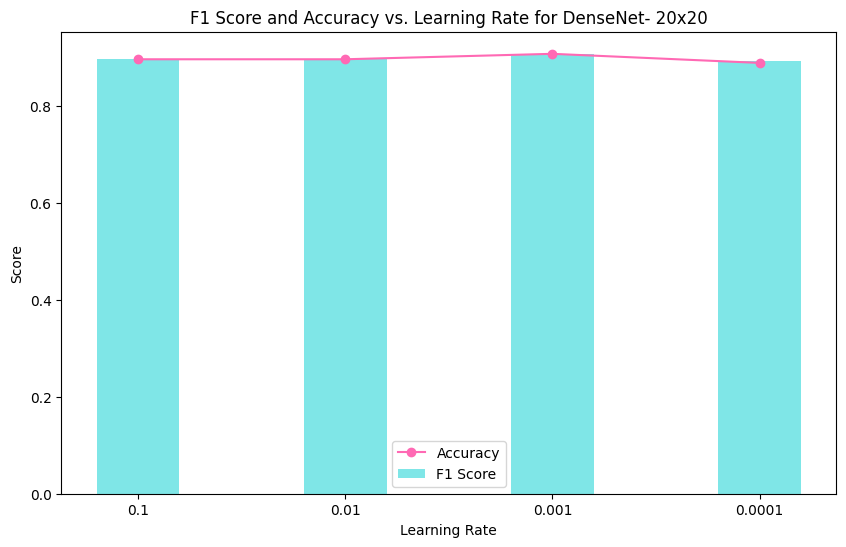

In [ ]:
results_densenet121_lr_20x20 = {}
results_densenet121_lr_20x20[0.1] = {'accuracy': 0.89625, 'precision': 0.8561, 'recall': 0.9429, 'f1': 0.8974}
results_densenet121_lr_20x20[0.01] = {'accuracy': 0.89625, 'precision': 0.8561, 'recall': 0.9429, 'f1': 0.8974}
results_densenet121_lr_20x20[0.001] = {'accuracy': 0.9075, 'precision': 0.8729, 'recall': 0.9455, 'f1': 0.9077}
results_densenet121_lr_20x20[0.0001] = {'accuracy': 0.88875, 'precision': 0.8333, 'recall': 0.9610, 'f1': 0.8926}

plot_metrics_vs_lr(results_densenet121_lr_20x20,'DenseNet- 20x20')

## **Augmentation Strategies**

In [ ]:
augmentations = transforms.Compose([
    RandomApply([transforms.RandomHorizontalFlip()], p=0.7),
    RandomApply([transforms.RandomVerticalFlip()], p=0.7),
    RandomApply([transforms.RandomRotation(degrees=30)], p=0.5),
    RandomApply([transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)], p=0.5),
])

def numpy_to_pil_image(numpy_array):
    # Convert NumPy array to PIL image
    return Image.fromarray(numpy_array)

def augment_images(images, augmentation, num_images):
    augmented_images = []
    for i in range(num_images):
        # Randomly select an image from the original set
        original_image = images[np.random.randint(0, len(images))]
        # Convert NumPy array to PIL image
        original_image_pil = numpy_to_pil_image(original_image)
        # Apply augmentation
        augmented_image_pil = augmentation(original_image_pil)
        # Convert augmented PIL image back to NumPy array
        augmented_image_np = np.array(augmented_image_pil)
        augmented_images.append(augmented_image_np)
    return augmented_images

# Augment bike images
bike_augmented_images = augment_images(bike_images, augmentations, 300)

# Augment car images
car_augmented_images = augment_images(car_images, augmentations, 300)

# Print the total number of images for each class
print(f"Number of bike images: {len(bike_augmented_images)}")
print(f"Number of car images: {len(car_augmented_images)}")

# Convert images to numpy arrays
bike_augmented_images_np = np.array(bike_augmented_images)
car_augmented_images_np = np.array(car_augmented_images)

# Stack the images and labels
images_augmented_np = np.vstack([bike_augmented_images_np, car_augmented_images_np])
num_bike_augmented_images = len(bike_augmented_images_np)
num_car_augmented_images = len(car_augmented_images_np)


bike_augmented_labels = np.zeros(num_bike_augmented_images)
car_augmented_labels = np.ones(num_car_augmented_images)

augmented_labels = np.concatenate((bike_augmented_labels, car_augmented_labels), axis=0)

np.save('/content/drive/My Drive/Car-Bike-Dataset/augmented_images_np.npy', images_augmented_np)
np.save('/content/drive/My Drive/Car-Bike-Dataset/car_augmented_labels.npy', car_augmented_labels)
np.save('/content/drive/My Drive/Car-Bike-Dataset/bike_augmented_labels.npy', bike_augmented_labels)

Number of bike images: 300
Number of car images: 300


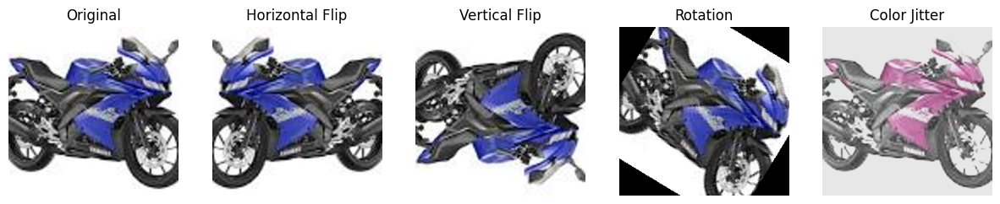

In [ ]:
def plot_augmentations(original_image, augmentations):
    # Convert NumPy array to PIL image
    original_image_pil = Image.fromarray(original_image)

    # Create a subplot for each augmentation
    fig, axes = plt.subplots(1, len(augmentations) + 1, figsize=(15, 5))

    # Plot the original image
    axes[0].imshow(original_image_pil)
    axes[0].set_title('Original')
    axes[0].axis('off')

    # Apply each augmentation and plot
    augmentation_names = ['Horizontal Flip', 'Vertical Flip', 'Rotation', 'Color Jitter']
    for i, (augmentation, name) in enumerate(zip(augmentations, augmentation_names), start=1):
        augmented_image_pil = augmentation(original_image_pil)
        axes[i].imshow(augmented_image_pil)
        axes[i].set_title(f'{name}')
        axes[i].axis('off')

    plt.show()

# Example usage:
# Select an image and its corresponding augmentation
original_image = bike_images[0]
augmentations_to_plot = [
    transforms.RandomHorizontalFlip(p=1.0),
    transforms.RandomVerticalFlip(p=1.0),
    transforms.RandomRotation(degrees=45),
    transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.5),
]

# Plot augmentations
plot_augmentations(original_image, augmentations_to_plot)


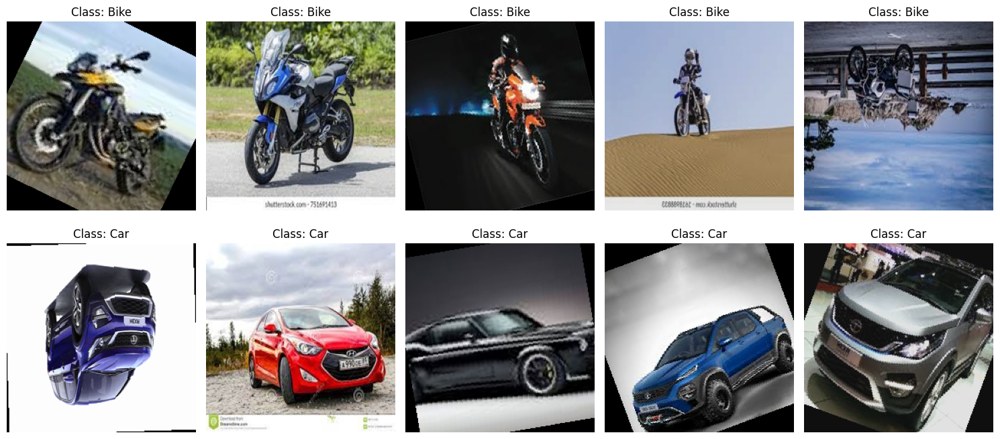

In [ ]:
augmented_labels = np.concatenate((bike_augmented_labels, car_augmented_labels), axis=0)

plot_images(images_augmented_np, augmented_labels)

In [ ]:
images_augmented_np = np.load('/content/drive/My Drive/Car-Bike-Dataset/augmented_images_np.npy')
car_augmented_labels = np.load('/content/drive/My Drive/Car-Bike-Dataset/car_augmented_labels.npy')
bike_augmented_labels = np.load('/content/drive/My Drive/Car-Bike-Dataset/bike_augmented_labels.npy')

# Stack the images and labels
images_with_augmented_np = np.vstack([images_np, images_augmented_np])
labels_with_augmented_np = np.hstack([labels_np, bike_augmented_labels, car_augmented_labels])

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(images_with_augmented_np, labels_with_augmented_np, test_size=0.2, random_state=42)

# Convert data into PyTorch tensors and transpose dimensions
X_train_tensor = torch.tensor(X_train.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor = torch.tensor(X_test.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
y_test_tensor = torch.tensor(y_test, dtype=torch.long)

# Count the number of images from each class
num_bike_images = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images}")
print(f"Number of car images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images}")
print(f"Number of car images test: {num_car_images_test}")

# Create Dataset instances with transforms
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

Number of bike images train: 1821
Number of car images test: 478
Number of car images train: 1855
Number of car images test: 442


### **Baseline-**
#### **GoogleNet**

In [ ]:
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True)

googlenet = googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.0001)
train_model(googlenet, train_loader, criterion, optimizer,num_epochs=3)
accuracy_augmented_baseline, precision_augmented_baseline, recall_augmented_baseline, f1_augmented_baseline, confusion_matrix_augmented_baseline = test_model(googlenet, test_loader)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6548
Epoch 2/3, Iteration 1, Train Loss: 0.0183
Epoch 3/3, Iteration 1, Train Loss: 0.0095
Training completed.
Final Training Accuracy: 0.9997

Test Set Evaluation Metrics:
Accuracy: 0.9934782608695653
Precision: 0.990990990990991
Recall: 0.995475113122172
F1 Score: 0.9932279909706545
Confusion Matrix:
[[474   4]
 [  2 440]]


#### **DenseNet**

In [ ]:
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=True)

densenet121= densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.0001)
train_model(densenet121, train_loader, criterion, optimizer,num_epochs=3)
accuracy_baseline_densenet_augmented, precision_baseline_densenet_augmented, recall_baseline_densenet_augmented, f1_baseline_densenet_augmented, confusion_matrix_baseline_densenet_augmented = test_model(densenet121, test_loader)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6941
Epoch 1/3, Iteration 100, Train Loss: 0.0141
Epoch 2/3, Iteration 1, Train Loss: 0.0186
Epoch 2/3, Iteration 100, Train Loss: 0.0085
Epoch 3/3, Iteration 1, Train Loss: 0.0076
Epoch 3/3, Iteration 100, Train Loss: 0.0012
Training completed.
Final Training Accuracy: 1.0000

Test Set Evaluation Metrics:
Accuracy: 0.9945652173913043
Precision: 0.9977220956719818
Recall: 0.9909502262443439
F1 Score: 0.9943246311010215
Confusion Matrix:
[[477   1]
 [  4 438]]


### **2-Tile Permutations**

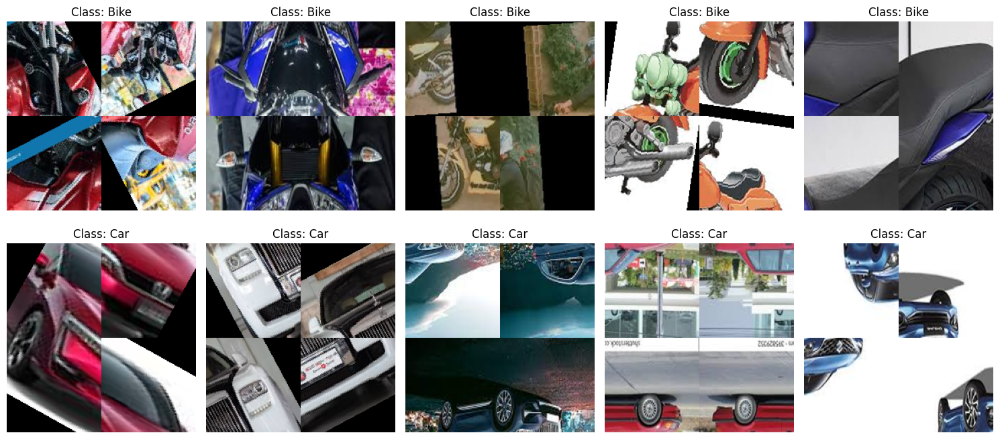

In [ ]:
images_np_permutation_2x2_augmented=[]
for image in images_augmented_np:
    tiles = split_image_into_tiles(image, 2)

    # Permute the order of tiles
    permuted_tiles = permute_tiles_order(tiles, 2)

    # Combine permuted tiles into a single image
    combined_image = combine_permuted_tiles(permuted_tiles, 2)

    images_np_permutation_2x2_augmented.append(combined_image)

plot_images(images_np_permutation_2x2_augmented, augmented_labels)

In [ ]:
images_np_permutation_2x2 = np.load('/content/drive/My Drive/Car-Bike-Dataset/2x2/images_np_permutation_2x2.npy')

# Stack the images and labels
images_with_augmented_np_2x2 = np.vstack([images_np_permutation_2x2, images_np_permutation_2x2_augmented])
labels_with_augmented_np_2x2 = np.hstack([labels_np, augmented_labels])

# Split data into train and test sets
X_train_2x2, X_test_2x2, y_train_2x2, y_test_2x2 = train_test_split(images_with_augmented_np_2x2, labels_with_augmented_np_2x2, test_size=0.2, random_state=42)

# Convert data into PyTorch tensors and transpose dimensions
X_train_tensor_2x2 = torch.tensor(X_train_2x2.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor_2x2 = torch.tensor(X_test_2x2.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor_2x2 = torch.tensor(y_train_2x2, dtype=torch.long)
y_test_tensor_2x2 = torch.tensor(y_test_2x2, dtype=torch.long)

# Count the number of images from each class
num_bike_images = np.sum(y_train == 0)
num_bike_images_test = np.sum(y_test == 0)

num_car_images = np.sum(y_train == 1)
num_car_images_test = np.sum(y_test == 1)

print(f"Number of bike images train: {num_bike_images}")
print(f"Number of car images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images}")
print(f"Number of car images test: {num_car_images_test}")

# Create Dataset instances with transforms
train_dataset_2x2 = TensorDataset(X_train_tensor_2x2, y_train_tensor_2x2)
test_dataset_2x2 = TensorDataset(X_test_tensor_2x2, y_test_tensor_2x2)

Number of bike images train: 1821
Number of car images test: 478
Number of car images train: 1855
Number of car images test: 442


#### **GoogleNet**

In [ ]:
train_loader_2x2 = DataLoader(train_dataset_2x2, batch_size=64, shuffle=True)
test_loader_2x2 = DataLoader(test_dataset_2x2, batch_size=64, shuffle=True)

googlenet = googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.0001)
train_model(googlenet, train_loader_2x2, criterion, optimizer,num_epochs=3)
accuracy_googlenet_augmented_2x2, precision_googlenet_augmented_2x2, recall_googlenet_augmented_2x2, f1_googlenet_augmented_2x2, confusion_matrix_googlenet_augmented_2x2 = test_model(googlenet, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7639
Epoch 2/3, Iteration 1, Train Loss: 0.0107
Epoch 3/3, Iteration 1, Train Loss: 0.0061
Training completed.
Final Training Accuracy: 0.9989

Test Set Evaluation Metrics:
Accuracy: 0.9934782608695653
Precision: 0.9932126696832579
Recall: 0.9932126696832579
F1 Score: 0.9932126696832579
Confusion Matrix:
[[475   3]
 [  3 439]]


#### **DenseNet**

In [ ]:
train_loader_2x2 = DataLoader(train_dataset_2x2, batch_size=32, shuffle=True)
test_loader_2x2 = DataLoader(test_dataset_2x2, batch_size=32, shuffle=True)

densenet121= densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)
train_model(densenet121, train_loader_2x2, criterion, optimizer,num_epochs=3)
accuracy_densenet_augmented_2x2, precision_densenet_augmented_2x2, recall_densenet_augmented_2x2, f1_densenet_augmented_2x2, confusion_matrix_densenet_augmented_2x2t = test_model(densenet121, test_loader_2x2)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7939
Epoch 1/3, Iteration 100, Train Loss: 0.0325
Epoch 2/3, Iteration 1, Train Loss: 0.1173
Epoch 2/3, Iteration 100, Train Loss: 0.0948
Epoch 3/3, Iteration 1, Train Loss: 0.0785
Epoch 3/3, Iteration 100, Train Loss: 0.0181
Training completed.
Final Training Accuracy: 0.9627

Test Set Evaluation Metrics:
Accuracy: 0.9652173913043478
Precision: 0.9834905660377359
Recall: 0.9434389140271493
F1 Score: 0.9630484988452657
Confusion Matrix:
[[471   7]
 [ 25 417]]


### **3-Tile Permutations**

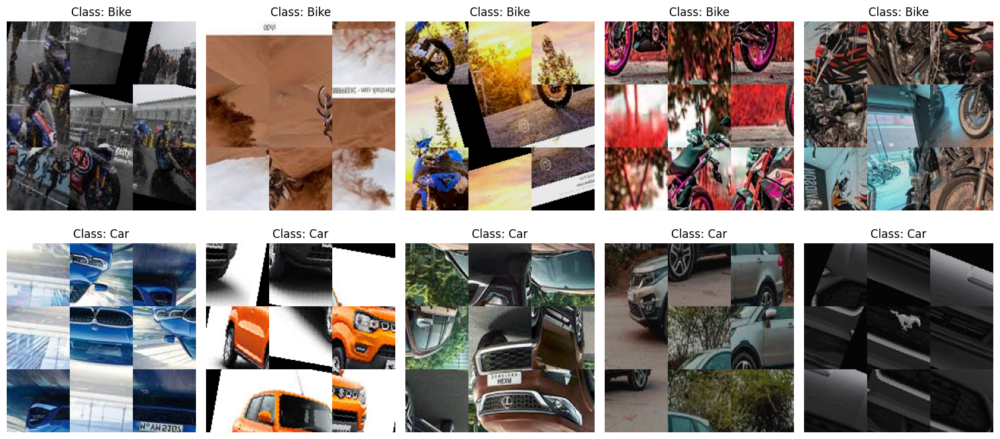

In [ ]:
images_np_permutation_3x3_augmented=[]
for image in images_augmented_np:
    tiles = split_image_into_tiles(image, 3)

    # Permute the order of tiles
    permuted_tiles = permute_tiles_order(tiles, 3)

    # Combine permuted tiles into a single image
    combined_image = combine_permuted_tiles(permuted_tiles, 3)

    images_np_permutation_3x3_augmented.append(combined_image)

plot_images(images_np_permutation_3x3_augmented, augmented_labels)

In [ ]:
images_np_permutation_3x3 = np.load('/content/drive/My Drive/Car-Bike-Dataset/3x3/images_np_permutation_3x3.npy')

# Stack the images and labels
images_with_augmented_np_3x3 = np.vstack([images_np_permutation_3x3, images_np_permutation_3x3_augmented])
labels_with_augmented_np_3x3 = np.hstack([labels_np, augmented_labels])

# Split data into train and test sets
X_train_3x3, X_test_3x3, y_train_3x3, y_test_3x3 = train_test_split(images_with_augmented_np_3x3, labels_with_augmented_np_3x3, test_size=0.2, random_state=42)

# Convert data into PyTorch tensors and transpose dimensions
X_train_tensor_3x3 = torch.tensor(X_train_3x3.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor_3x3 = torch.tensor(X_test_3x3.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor_3x3 = torch.tensor(y_train_3x3, dtype=torch.long)
y_test_tensor_3x3 = torch.tensor(y_test_3x3, dtype=torch.long)

# Count the number of images from each class
num_bike_images = np.sum(y_train_3x3 == 0)
num_bike_images_test = np.sum(y_test_3x3 == 0)

num_car_images = np.sum(y_train_3x3 == 1)
num_car_images_test = np.sum(y_test_3x3 == 1)

print(f"Number of bike images train: {num_bike_images}")
print(f"Number of car images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images}")
print(f"Number of car images test: {num_car_images_test}")

# Create Dataset instances with transforms
train_dataset_3x3 = TensorDataset(X_train_tensor_3x3, y_train_tensor_3x3)
test_dataset_3x3 = TensorDataset(X_test_tensor_3x3, y_test_tensor_3x3)

Number of bike images train: 1821
Number of car images test: 478
Number of car images train: 1855
Number of car images test: 442


#### **GoogleNet**

In [ ]:
train_loader_3x3 = DataLoader(train_dataset_3x3, batch_size=64, shuffle=True)
test_loader_3x3 = DataLoader(test_dataset_3x3, batch_size=64, shuffle=True)

googlenet = googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.0001)
train_model(googlenet, train_loader_3x3, criterion, optimizer,num_epochs=3)
accuracy_googlenet_augmented_3x3, precision_googlenet_augmented_3x3, recall_googlenet_augmented_3x3, f1_googlenet_augmented_3x3, confusion_matrix_googlenet_augmented_3x3 = test_model(googlenet, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7275
Epoch 2/3, Iteration 1, Train Loss: 0.0374
Epoch 3/3, Iteration 1, Train Loss: 0.0122
Training completed.
Final Training Accuracy: 0.9976

Test Set Evaluation Metrics:
Accuracy: 0.991304347826087
Precision: 0.9865470852017937
Recall: 0.995475113122172
F1 Score: 0.990990990990991
Confusion Matrix:
[[472   6]
 [  2 440]]


#### **DenseNet**

In [ ]:
train_loader_3x3 = DataLoader(train_dataset_3x3, batch_size=32, shuffle=True)
test_loader_3x3 = DataLoader(test_dataset_3x3, batch_size=32, shuffle=True)

densenet121= densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.0001)
train_model(densenet121, train_loader_3x3, criterion, optimizer,num_epochs=3)
accuracy_densenet_augmented_3x3, precision_densenet_augmented_3x3, recall_densenet_augmented_3x3, f1_densenet_augmented_3x3, confusion_matrix_densenet_augmented_3x3 = test_model(densenet121, test_loader_3x3)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.6459
Epoch 1/3, Iteration 100, Train Loss: 0.0669
Epoch 2/3, Iteration 1, Train Loss: 0.0238
Epoch 2/3, Iteration 100, Train Loss: 0.0089
Epoch 3/3, Iteration 1, Train Loss: 0.0038
Epoch 3/3, Iteration 100, Train Loss: 0.0017
Training completed.
Final Training Accuracy: 0.9984

Test Set Evaluation Metrics:
Accuracy: 0.9880434782608696
Precision: 0.9931350114416476
Recall: 0.9819004524886877
F1 Score: 0.987485779294653
Confusion Matrix:
[[475   3]
 [  8 434]]


### **4-Tile Permutations**

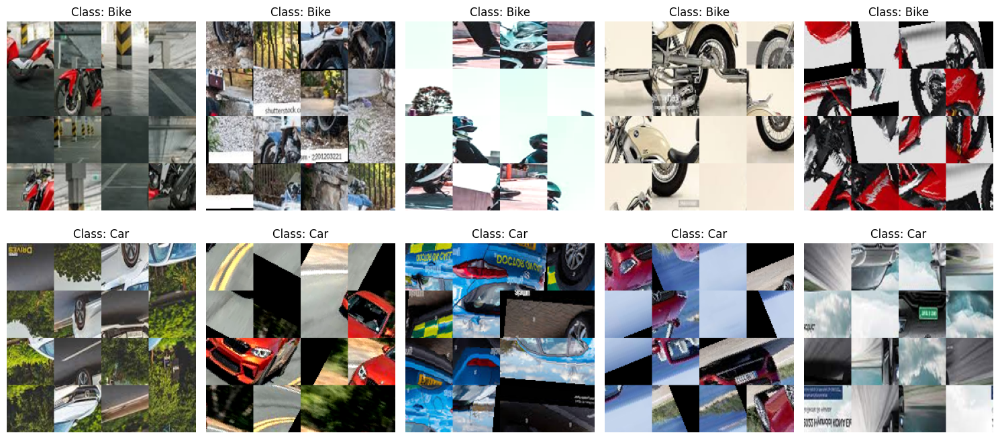

In [ ]:
images_np_permutation_4x4_augmented=[]
for image in images_augmented_np:
    tiles = split_image_into_tiles(image, 4)

    # Permute the order of tiles
    permuted_tiles = permute_tiles_order(tiles, 4)

    # Combine permuted tiles into a single image
    combined_image = combine_permuted_tiles(permuted_tiles, 4)

    images_np_permutation_4x4_augmented.append(combined_image)

plot_images(images_np_permutation_4x4_augmented, augmented_labels)

In [ ]:
images_np_permutation_4x4 = np.load('/content/drive/My Drive/Car-Bike-Dataset/4x4/images_np_permutation_4x4.npy')

# Stack the images and labels
images_with_augmented_np_4x4 = np.vstack([images_np_permutation_4x4, images_np_permutation_4x4_augmented])
labels_with_augmented_np_4x4 = np.hstack([labels_np, augmented_labels])

# Split data into train and test sets
X_train_4x4, X_test_4x4, y_train_4x4, y_test_4x4 = train_test_split(images_with_augmented_np_4x4, labels_with_augmented_np_4x4, test_size=0.2, random_state=42)

# Convert data into PyTorch tensors and transpose dimensions
X_train_tensor_4x4 = torch.tensor(X_train_4x4.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor_4x4 = torch.tensor(X_test_4x4.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor_4x4 = torch.tensor(y_train_4x4, dtype=torch.long)
y_test_tensor_4x4 = torch.tensor(y_test_4x4, dtype=torch.long)

# Count the number of images from each class
num_bike_images = np.sum(y_train_4x4 == 0)
num_bike_images_test = np.sum(y_test_4x4 == 0)

num_car_images = np.sum(y_train_4x4 == 1)
num_car_images_test = np.sum(y_test_4x4 == 1)

print(f"Number of bike images train: {num_bike_images}")
print(f"Number of car images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images}")
print(f"Number of car images test: {num_car_images_test}")

# Create Dataset instances with transforms
train_dataset_4x4 = TensorDataset(X_train_tensor_4x4, y_train_tensor_4x4)
test_dataset_4x4 = TensorDataset(X_test_tensor_4x4, y_test_tensor_4x4)

Number of bike images train: 1821
Number of car images test: 478
Number of car images train: 1855
Number of car images test: 442


#### **GoogleNet**

In [ ]:
train_loader_4x4 = DataLoader(train_dataset_4x4, batch_size=64, shuffle=True)
test_loader_4x4 = DataLoader(test_dataset_4x4, batch_size=64, shuffle=True)

googlenet = googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.0001)
train_model(googlenet, train_loader_4x4, criterion, optimizer,num_epochs=3)
accuracy_googlenet_augmented_4x4, precision_googlenet_augmented_4x4, recall_googlenet_augmented_4x4, f1_googlenet_augmented_4x4, confusion_matrix_googlenet_augmented_4x4 = test_model(googlenet, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7474
Epoch 2/3, Iteration 1, Train Loss: 0.0709
Epoch 3/3, Iteration 1, Train Loss: 0.0088
Training completed.
Final Training Accuracy: 0.9997

Test Set Evaluation Metrics:
Accuracy: 0.9804347826086957
Precision: 0.9818181818181818
Recall: 0.9773755656108597
F1 Score: 0.9795918367346939
Confusion Matrix:
[[470   8]
 [ 10 432]]


#### **DenseNet**

In [ ]:
train_loader_4x4 = DataLoader(train_dataset_4x4, batch_size=32, shuffle=True)
test_loader_4x4 = DataLoader(test_dataset_4x4, batch_size=32, shuffle=True)

densenet121= densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.0001)
train_model(densenet121, train_loader_4x4, criterion, optimizer,num_epochs=3)
accuracy_densenet_augmented_4x4, precision_densenet_augmented_4x4, recall_densenet_augmented_4x4, f1_densenet_augmented_4x4, confusion_matrix_densenet_augmented_4x4 = test_model(densenet121, test_loader_4x4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.8868
Epoch 1/3, Iteration 100, Train Loss: 0.0452
Epoch 2/3, Iteration 1, Train Loss: 0.0604
Epoch 2/3, Iteration 100, Train Loss: 0.0193
Epoch 3/3, Iteration 1, Train Loss: 0.0288
Epoch 3/3, Iteration 100, Train Loss: 0.0655
Training completed.
Final Training Accuracy: 0.9973

Test Set Evaluation Metrics:
Accuracy: 0.9923913043478261
Precision: 0.9954441913439636
Recall: 0.9886877828054299
F1 Score: 0.9920544835414301
Confusion Matrix:
[[476   2]
 [  5 437]]


### **20-Tile Permutations**

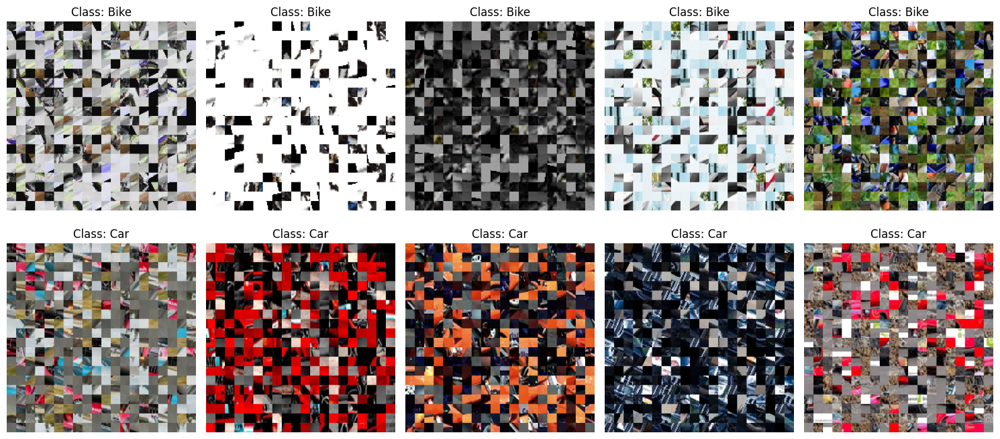

In [ ]:
images_np_permutation_20x20_augmented=[]
for image in images_augmented_np:
    tiles = split_image_into_tiles(image, 20)

    # Permute the order of tiles
    permuted_tiles = permute_tiles_order(tiles, 20)

    # Combine permuted tiles into a single image
    combined_image = combine_permuted_tiles(permuted_tiles, 20)

    images_np_permutation_20x20_augmented.append(combined_image)

plot_images(images_np_permutation_20x20_augmented, augmented_labels)

In [ ]:
images_np_permutation_20x20 = np.load('/content/drive/My Drive/Car-Bike-Dataset/20x20/images_np_permutation_20x20.npy')

# Stack the images and labels
images_with_augmented_np_20x20 = np.vstack([images_np_permutation_20x20, images_np_permutation_20x20_augmented])
labels_with_augmented_np_20x20 = np.hstack([labels_np, augmented_labels])

# Split data into train and test sets
X_train_20x20, X_test_20x20, y_train_20x20, y_test_20x20 = train_test_split(images_with_augmented_np_20x20, labels_with_augmented_np_20x20, test_size=0.2, random_state=42)

# Convert data into PyTorch tensors and transpose dimensions
X_train_tensor_20x20 = torch.tensor(X_train_20x20.transpose(0, 3, 1, 2), dtype=torch.float)
X_test_tensor_20x20 = torch.tensor(X_test_20x20.transpose(0, 3, 1, 2), dtype=torch.float)
y_train_tensor_20x20 = torch.tensor(y_train_20x20, dtype=torch.long)
y_test_tensor_20x20 = torch.tensor(y_test_20x20, dtype=torch.long)

# Count the number of images from each class
num_bike_images = np.sum(y_train_20x20 == 0)
num_bike_images_test = np.sum(y_test_20x20 == 0)

num_car_images = np.sum(y_train_20x20 == 1)
num_car_images_test = np.sum(y_test_20x20 == 1)

print(f"Number of bike images train: {num_bike_images}")
print(f"Number of car images test: {num_bike_images_test}")

print(f"Number of car images train: {num_car_images}")
print(f"Number of car images test: {num_car_images_test}")

# Create Dataset instances with transforms
train_dataset_20x20 = TensorDataset(X_train_tensor_20x20, y_train_tensor_20x20)
test_dataset_20x20 = TensorDataset(X_test_tensor_20x20, y_test_tensor_20x20)

Number of bike images train: 1821
Number of car images test: 478
Number of car images train: 1855
Number of car images test: 442


#### **GoogleNet**

In [ ]:
train_loader_20x20 = DataLoader(train_dataset_20x20, batch_size=64, shuffle=True)
test_loader_20x20 = DataLoader(test_dataset_20x20, batch_size=64, shuffle=True)

googlenet = googlenet_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(googlenet.parameters(), lr=0.0001)
train_model(googlenet, train_loader_20x20, criterion, optimizer,num_epochs=3)
accuracy_googlenet_augmented_20x20, precision_googlenet_augmented_20x20, recall_googlenet_augmented_20x20, f1_googlenet_augmented_20x20, confusion_matrix_googlenet_augmented_20x20 = test_model(googlenet, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7035
Epoch 2/3, Iteration 1, Train Loss: 0.4015
Epoch 3/3, Iteration 1, Train Loss: 0.0588
Training completed.
Final Training Accuracy: 0.9812

Test Set Evaluation Metrics:
Accuracy: 0.8728260869565218
Precision: 0.8953771289537713
Recall: 0.832579185520362
F1 Score: 0.8628370457209847
Confusion Matrix:
[[435  43]
 [ 74 368]]


#### **DenseNet**

In [ ]:
train_loader_20x20 = DataLoader(train_dataset_20x20, batch_size=32, shuffle=True)
test_loader_20x20 = DataLoader(test_dataset_20x20, batch_size=32, shuffle=True)


densenet121= densenet121_model()
criterion = nn.CrossEntropyLoss()
optimizer = Adam(densenet121.parameters(), lr=0.001)
train_model(densenet121, train_loader_20x20, criterion, optimizer,num_epochs=3)
accuracy_densenet_augmented_20x20, precision_densenet_augmented_20x20, recall_densenet_augmented_20x20, f1_densenet_augmented_20x20, confusion_matrix_augmented_densenet_20x20 = test_model(densenet121, test_loader_20x20)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/3, Iteration 1, Train Loss: 0.7419
Epoch 1/3, Iteration 100, Train Loss: 0.5136
Epoch 2/3, Iteration 1, Train Loss: 0.1743
Epoch 2/3, Iteration 100, Train Loss: 0.1929
Epoch 3/3, Iteration 1, Train Loss: 0.1636
Epoch 3/3, Iteration 100, Train Loss: 0.1150
Training completed.
Final Training Accuracy: 0.9075

Test Set Evaluation Metrics:
Accuracy: 0.825
Precision: 0.9488817891373802
Recall: 0.6719457013574661
F1 Score: 0.7867549668874173
Confusion Matrix:
[[462  16]
 [145 297]]


### **Comparing permutation types by evaluation metrics for each model for Augmentation**

In [ ]:
def plot_metric_comparison(architecture_type, permutation_types, metrics, *args):
    num_permutations = len(permutation_types)
    num_metrics = len(metrics)
    bar_width = 0.35
    colors = ['#00CED1', '#FF69B4']

    fig, axs = plt.subplots(1, num_metrics, figsize=(20, 5))

    for i, metric in enumerate(metrics):
        ax = axs[i]
        indices = np.arange(num_permutations)

        bars1 = ax.bar(indices - bar_width/2, args[i*2], width=bar_width, label='Original Dataset', color=colors[0])
        bars2 = ax.bar(indices + bar_width/2, args[i*2 + 1], width=bar_width, label='Augmented Dataset', color=colors[1])

        ax.set_xticks(indices)
        ax.set_xticklabels(permutation_types)
        ax.set_ylabel(metric.capitalize())

        # Add labels to the bars
        for bar1, bar2 in zip(bars1, bars2):
            height1 = bar1.get_height()
            height2 = bar2.get_height()
            ax.text(bar1.get_x() + bar1.get_width()/2., height1, '%.2f' % height1, ha='center', va='bottom')
            ax.text(bar2.get_x() + bar2.get_width()/2., height2, '%.2f' % height2, ha='center', va='bottom')

        # Place legend above the plot
        ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=True, ncol=2)

    plt.suptitle(f'Metric Comparison for {architecture_type}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

permutation_types = ['baseline', '2x2', '3x3', '4x4', '20x20']
metrics = ['accuracy', 'precision', 'recall', 'f1']

In [ ]:
#baseline
accuracy_baseline_googlenet_batchnorm = 0.9912
precision_baseline_googlenet_batchnorm = 0.9922
recall_baseline_googlenet_batchnorm = 0.9896
f1_baseline_googlenet_batchnorm = 0.9909
confusion_matrix_baseline_googlenet_batchnorm = [[412,   3],[  4, 381]]

accuracy_baseline_densenet_batchnorm = 0.9363
precision_baseline_densenet_batchnorm = 0.9941
recall_baseline_densenet_batchnorm = 0.8727
f1_baseline_densenet_batchnorm = 0.9295
confusion_matrix_baseline_densenet_batchnorm = [[413,   2], [ 49, 336]]

#2x2
accuracy_2x2_googlenet_batchnorm = 0.9363
precision_2x2_googlenet_batchnorm = 0.9912
recall_2x2_googlenet_batchnorm = 0.8753
f1_2x2_googlenet_batchnorm = 0.9297
confusion_matrix_2x2_googlenet_batchnorm = [[412,   3], [ 48, 337]]

accuracy_2x2_densenet_batchnorm = 0.9663
precision_2x2_densenet_batchnorm = 0.9686
recall_2x2_densenet_batchnorm = 0.9610
f1_2x2_densenet_batchnorm = 0.9648
confusion_matrix_2x2_densenet_batchnorm = [[403,  12], [ 15, 370]]

#3x3
accuracy_3x3_googlenet_batchnorm = 0.9400
precision_3x3_googlenet_batchnorm = 0.9941
recall_3x3_googlenet_batchnorm = 0.8805
f1_3x3_googlenet_batchnorm = 0.9339
confusion_matrix_3x3_googlenet_batchnorm = [[413,   2], [ 46, 339]]


accuracy_3x3_densenet_batchnorm = 0.9487
precision_3x3_densenet_batchnorm = 0.9751
recall_3x3_densenet_batchnorm = 0.9169
f1_3x3_densenet_batchnorm = 0.9451
confusion_matrix_3x3_densenet_batchnorm = [[406,   9], [ 32, 353]]

#4x4
accuracy_4x4_googlenet_batchnorm = 0.9413
precision_4x4_googlenet_batchnorm = 0.9942
recall_4x4_googlenet_batchnorm = 0.8831
f1_4x4_googlenet_batchnorm = 0.9354
confusion_matrix_4x4_googlenet_batchnorm = [[413,   2], [ 45, 340]]

accuracy_4x4_densenet_batchnorm = 0.9550
precision_4x4_densenet_batchnorm = 0.9915
recall_4x4_densenet_batchnorm = 0.9143
f1_4x4_densenet_batchnorm = 0.9514
confusion_matrix_4x4_densenet_batchnorm = [[412,   3], [ 33, 352]]

#20x20
accuracy_20x20_googlenet_batchnorm = 0.8612
precision_20x20_googlenet_batchnorm = 0.7842
recall_20x20_googlenet_batchnorm = 0.9818
f1_20x20_googlenet_batchnorm = 0.8720
confusion_matrix_20x20_googlenet_batchnorm = [[311, 104], [  7, 378]]


accuracy_20x20_densenet_batchnorm = 0.7137
precision_20x20_densenet_batchnorm = 0.9875
recall_20x20_densenet_batchnorm = 0.4104
f1_20x20_densenet_batchnorm = 0.5798
confusion_matrix_20x20_densenet_batchnorm = [[413,   2], [227, 158]]


# Without BatchNorm
accuracy = [accuracy_baseline_googlenet, accuracy_2x2_googlenet, accuracy_3x3_googlenet, accuracy_4x4_googlenet, accuracy_20x20_googlenet]
precision = [precision_baseline_googlenet, precision_2x2_googlenet, precision_3x3_googlenet, precision_4x4_googlenet, precision_20x20_googlenet]
recall = [recall_baseline_googlenet, recall_2x2_googlenet, recall_3x3_googlenet, recall_4x4_googlenet, recall_20x20_googlenet]
f1 = [f1_baseline_googlenet,f1_2x2_googlenet,f1_3x3_googlenet,f1_4x4_googlenet, f1_20x20_googlenet]

# With BatchNorm
accuracy_batchnorm = [accuracy_baseline_googlenet_batchnorm,accuracy_2x2_googlenet_batchnorm,accuracy_3x3_googlenet_batchnorm,accuracy_4x4_googlenet_batchnorm,accuracy_20x20_googlenet_batchnorm]
precision_batchnorm = [precision_baseline_googlenet_batchnorm, precision_2x2_googlenet_batchnorm, precision_3x3_googlenet_batchnorm,precision_4x4_googlenet_batchnorm,precision_20x20_googlenet_batchnorm]
recall_batchnorm = [recall_baseline_googlenet_batchnorm,recall_2x2_googlenet_batchnorm,recall_3x3_googlenet_batchnorm,recall_4x4_googlenet_batchnorm,recall_20x20_googlenet_batchnorm]
f1_batchnorm = [f1_baseline_googlenet_batchnorm,f1_2x2_googlenet_batchnorm,f1_3x3_googlenet_batchnorm,f1_4x4_googlenet_batchnorm,f1_20x20_googlenet_batchnorm]

plot_metric_comparison("Googlenet" , permutation_types, metrics, accuracy, accuracy_batchnorm, precision, precision_batchnorm, recall, recall_batchnorm, f1, f1_batchnorm)


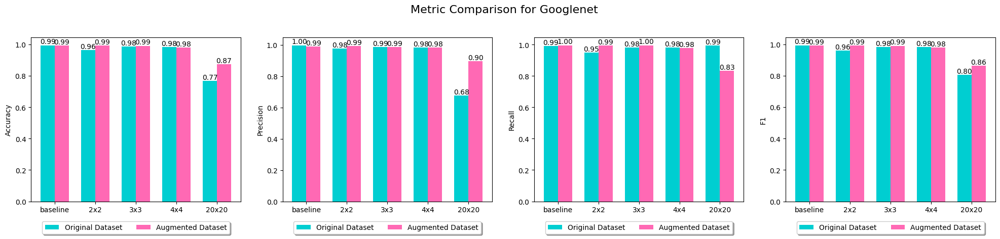

In [ ]:
accuracy_augmented_googlenet=[accuracy_augmented_baseline,accuracy_googlenet_augmented_2x2,accuracy_googlenet_augmented_3x3,accuracy_googlenet_augmented_4x4,accuracy_googlenet_augmented_20x20]
precision_augmented_googlenet = [precision_augmented_baseline,precision_googlenet_augmented_2x2,precision_googlenet_augmented_3x3,precision_googlenet_augmented_4x4,precision_googlenet_augmented_20x20]
recall_augmented_googlenet = [recall_augmented_baseline,recall_googlenet_augmented_2x2,recall_googlenet_augmented_3x3,recall_googlenet_augmented_4x4,recall_googlenet_augmented_20x20]
f1_augmented_googlenet = [f1_augmented_baseline,f1_googlenet_augmented_2x2,f1_googlenet_augmented_3x3,f1_googlenet_augmented_4x4,f1_googlenet_20x20]

accuracy_original_googlenet=[]
precision_original_googlenet=[]
recall_original_googlenet=[]
f1_original_googlenet=[]

dic_list= [results_googlenet_lr[0.0001],
results_googlenet_lr_2x2[0.001],
results_googlenet_lr_3x3[0.0001],
results_googlenet_lr_4x4[0.0001],
results_googlenet_lr_20x20[0.001]]

for dic in dic_list:
  for key,value in dic.items():
    if key == 'accuracy':
      accuracy_original_googlenet.append(value)
    elif key == 'precision':
      precision_original_googlenet.append(value)
    elif key == 'recall':
      recall_original_googlenet.append(value)
    elif key=='f1':
      f1_original_googlenet.append(value)

plot_metric_comparison("Googlenet" , permutation_types, metrics, accuracy_original_googlenet, accuracy_augmented_googlenet, precision_original_googlenet, precision_augmented_googlenet, recall_original_googlenet, recall_augmented_googlenet, f1_original_googlenet, f1_augmented_googlenet)


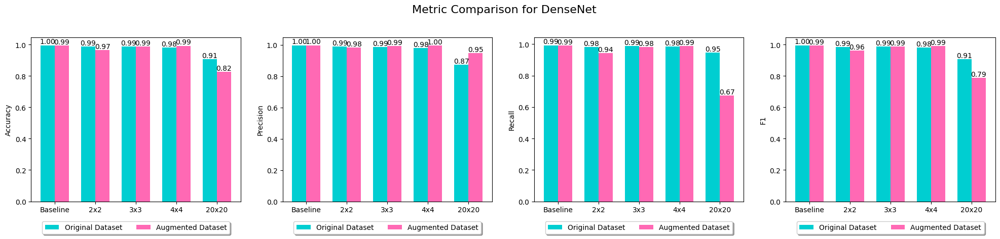

In [ ]:
accuracy_augmented_densenet=[accuracy_baseline_densenet_augmented,accuracy_densenet_augmented_2x2,accuracy_densenet_augmented_3x3,accuracy_densenet_augmented_4x4,accuracy_densenet_augmented_20x20]
precision_augmented_densenet = [precision_baseline_densenet_augmented, precision_densenet_augmented_2x2, precision_densenet_augmented_3x3, precision_densenet_augmented_4x4, precision_densenet_augmented_20x20]
recall_augmented_densenet = [recall_baseline_densenet_augmented, recall_densenet_augmented_2x2, recall_densenet_augmented_3x3, recall_densenet_augmented_4x4, recall_densenet_augmented_20x20]
f1_augmented_densenet = [f1_baseline_densenet_augmented, f1_densenet_augmented_2x2, f1_densenet_augmented_3x3, f1_densenet_augmented_4x4, f1_densenet_augmented_20x20]


accuracy_original_densenet121=[]
precision_original_densenet121=[]
recall_original_densenet121=[]
f1_original_densenet121=[]

dic_list= [results_densenet121_lr[0.0001],
results_densenet121_lr_2x2[0.001],
results_densenet121_lr_3x3[0.0001],
results_densenet121_lr_4x4[0.0001],
results_densenet121_lr_20x20[0.001]]

for dic in dic_list:
  for key,value in dic.items():
    if key == 'accuracy':
      accuracy_original_densenet121.append(value)
    elif key == 'precision':
      precision_original_densenet121.append(value)
    elif key == 'recall':
      recall_original_densenet121.append(value)
    elif key=='f1':
      f1_original_densenet121.append(value)

plot_metric_comparison("DenseNet" , permutation_types, metrics, accuracy_original_densenet121, accuracy_augmented_densenet, precision_original_densenet121, precision_augmented_densenet, recall_original_densenet121, recall_augmented_densenet, f1_original_densenet121, f1_augmented_densenet)


# **Dreamed big, had low computational power, but we made it work! Thanks for the adventure!** 🚀🧠💻


